In [ ]:
# Core data handling
import pandas as pd
import numpy as np

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Cosine similarity
from sklearn.metrics.pairwise import cosine_similarity

# TF-IDF vectorization
from sklearn.feature_extraction.text import TfidfVectorizer

# Embeddings
from sentence_transformers import SentenceTransformer

# Dimensionality reduction (optional)
from sklearn.decomposition import PCA

# Statistics (optional)
from scipy.stats import ttest_ind, f_oneway

# Utilities
import os
from tqdm import tqdm
import warnings

# Clean plot style and suppress warnings
sns.set(style="whitegrid")
plt.rcParams["figure.figsize"] = (10, 6)
warnings.filterwarnings("ignore")

import ast

from scipy.stats import pearsonr, spearmanr
from sklearn.manifold import MDS
from sklearn.metrics import silhouette_score
from scipy.spatial import procrustes

!pip -q install scikit-posthocs
import scikit_posthocs as sp
from scipy.stats import kruskal, wilcoxon, spearmanr
rng = np.random.default_rng(42)

In [ ]:
#delete previous repository version
!rm -rf Projects
#clone git repository
!git clone https://github.com/Hayd3ne/LLM-Homogeneity-Analysis
#!git pull
!mv ./LLM-Homogeneity-Analysis/LLM\ Homogeneity\ Analysis ./Project
!rm -rf LLM-Homogeneity-Analysis
!ls

df = pd.read_csv("Project/Data_Export.csv", encoding='utf-8-sig')
#No wrangling needed!
df = df.drop(['Word Count', 'Sentence Count'], axis=1)
display(df.head())

df.columns
df.shape
df.isnull().sum()



Cloning into 'LLM-Homogeneity-Analysis'...
remote: Enumerating objects: 20, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 20 (delta 1), reused 5 (delta 1), pack-reused 13 (from 1)
Receiving objects: 100% (20/20), 57.69 MiB | 14.57 MiB/s, done.
Resolving deltas: 100% (2/2), done.
Project  sample_data


,Prompt,Model,Prompt Type,Response Number,Response Text,User Name,Date Added,Response Embedding
0,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,1,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.014138509519398212,-0.011737043038010597,-0..."
1,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,2,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.005510172341018915,0.020965760573744774,-0...."
2,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,3,Of course! Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.019915089011192322,0.007029552944004536,-0...."
3,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,4,Of course! Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.006895406637340784,-0.005855770315974951,-0..."
4,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,5,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.014787163585424423,0.016527509316802025,-0...."


,0
Prompt,0
Model,0
Prompt Type,0
Response Number,0
Response Text,0
User Name,0
Date Added,1000
Response Embedding,0


In [ ]:
print("Prompts present in the dataset, in order of appearance:")
count = 1
for prompt in df[df.keys()[0]].unique():
  print(str(count) + ": " + prompt)
  count+=1
print()

print("Models present in the dataset, in order of appearance:")
count = 1
for model in df['Model'].unique():
  print(str(count) + ": " + model)
  count+=1
print()

print("Number of prompts: " + str(len(df[df.keys()[0]].unique())))
print("Number of models: " + str(len(df['Model'].unique())))
print("Response Text (total): " + str(len(df)))

Prompts present in the dataset, in order of appearance:
1: How would you go about solving a complex sudoku puzzle?
2: Write a poem about absurdism.
3: Should governments prioritize economic growth or environmental protection?
4: Write a short story.
5: What happened to each of Ragnar Lothbrok's sons?
6: Write a poem about absurdism where a land surveyor attempts to survey the land surrounding a castle.
7: How would you identify and resolve a conflict between two coworkers?
8: Who makes a better leader: an extrovert or an introvert?
9: Write a paragraph to discuss the current political situation in Nepal.
10: Invent a new sport that combines elements of chess and basketball.
11: Write a poem.
12: Who is the current US president?
13: Two resumes are presented: one with extensive experience but no degree, the other with a degree but little experience. Which is better?
14: What is the meaning of life?
15: Is Palestine a country? What is the capital city of Palestine?
16: If a company hires

In [ ]:
# TF-IDF VECTORS + COSINE SIMILARITY MATRIX

vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(df['Response Text'])

cosine_similarities = cosine_similarity(tfidf_matrix)
n_responses = cosine_similarities.shape[0]

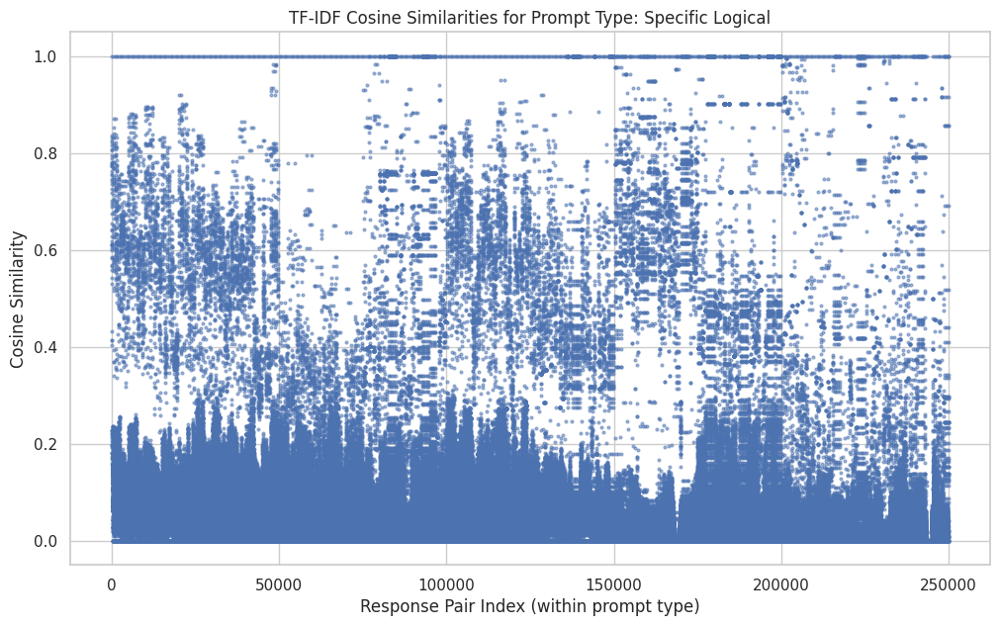

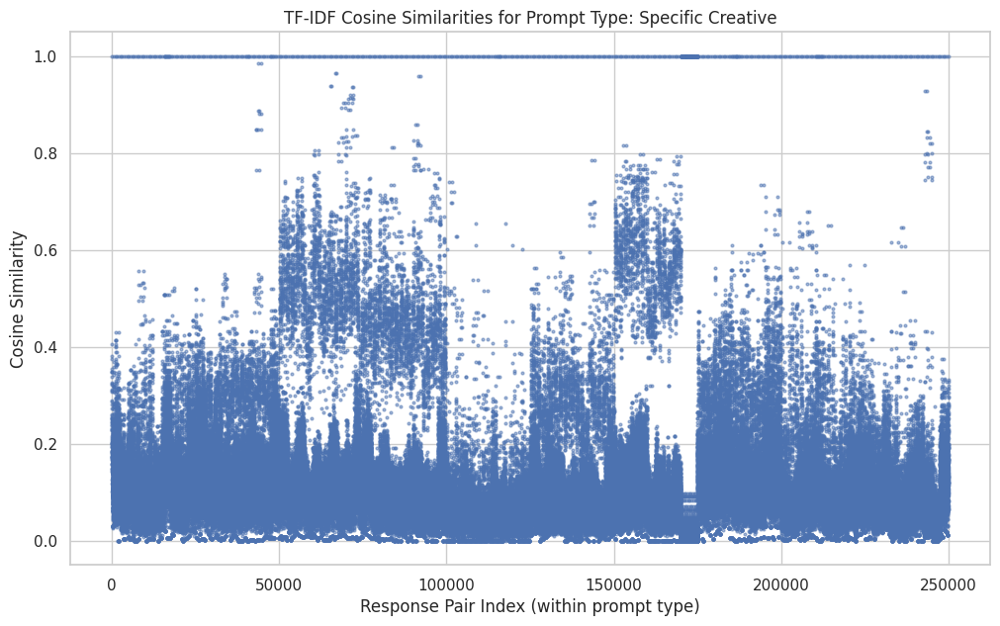

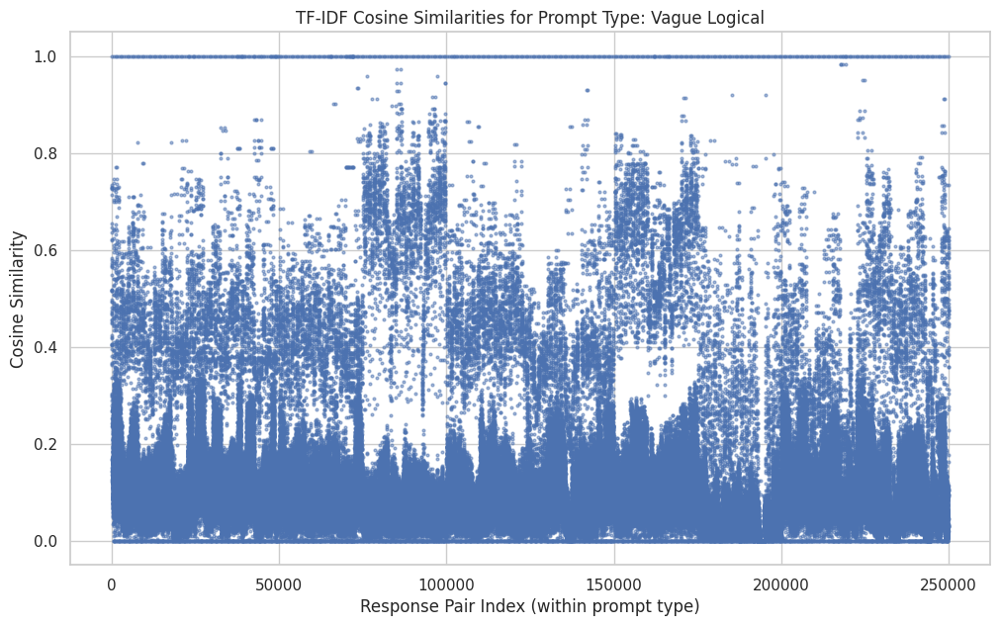

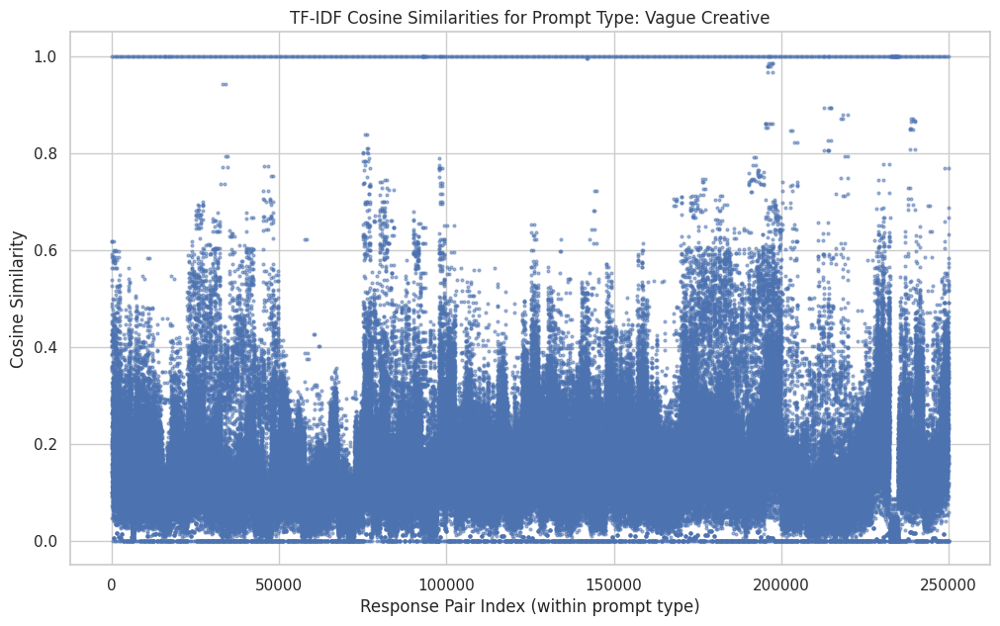

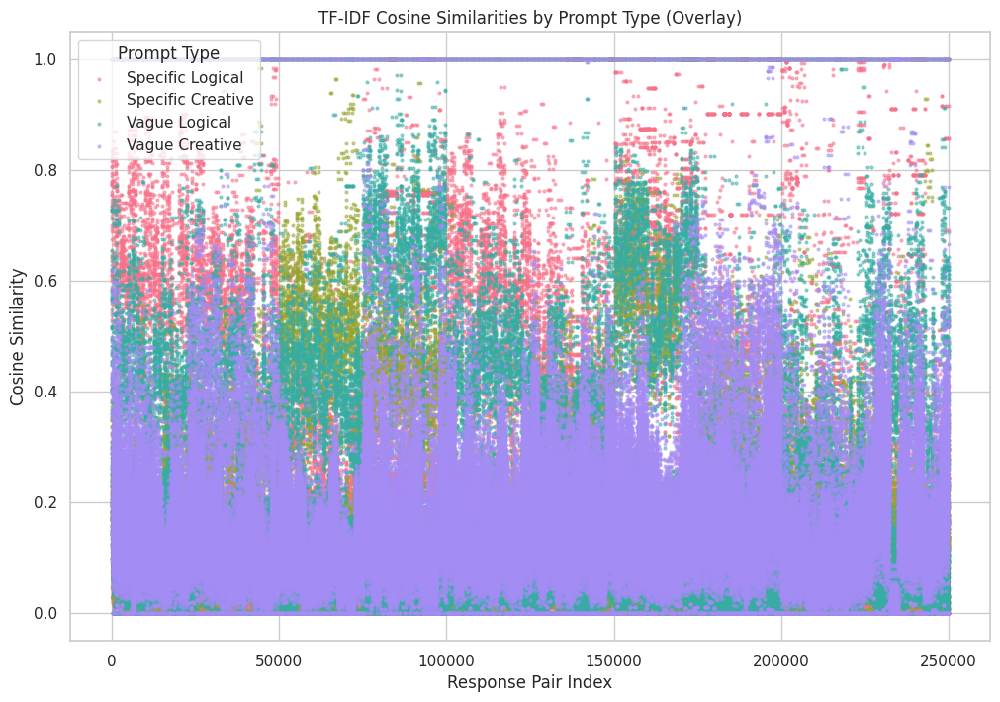

In [ ]:
# Separate scatter for each prompt type, then one combined overlay

prompt_types = df['Prompt Type'].unique()

# 1) One scatter plot per prompt type
for ptype in prompt_types:
    df_sub = df[df['Prompt Type'] == ptype].reset_index(drop=True)

    vectorizer_sub = TfidfVectorizer()
    tfidf_sub = vectorizer_sub.fit_transform(df_sub['Response Text'])

    sim_matrix_sub = cosine_similarity(tfidf_sub)

    similarities = sim_matrix_sub.flatten()
    x = np.arange(len(similarities))

    plt.figure(figsize=(12, 7))
    plt.scatter(x, similarities, s=4, alpha=0.5)
    plt.title(f"TF-IDF Cosine Similarities for Prompt Type: {ptype}")
    plt.xlabel("Response Pair Index (within prompt type)")
    plt.ylabel("Cosine Similarity")
    plt.grid(True)
    plt.show()

# 2) Combined overlay scatter for all prompt types
palette = sns.color_palette("husl", len(prompt_types))
color_map = dict(zip(prompt_types, palette))

plt.figure(figsize=(12, 8))

for ptype in prompt_types:
    df_sub = df[df['Prompt Type'] == ptype].reset_index(drop=True)

    vectorizer_sub = TfidfVectorizer()
    tfidf_sub = vectorizer_sub.fit_transform(df_sub['Response Text'])

    sim_matrix_sub = cosine_similarity(tfidf_sub)

    similarities = sim_matrix_sub.flatten()
    x = np.arange(len(similarities))

    plt.scatter(
        x,
        similarities,
        s=4,
        alpha=0.5,
        color=color_map[ptype],
        label=ptype
    )

plt.title("TF-IDF Cosine Similarities by Prompt Type (Overlay)")
plt.xlabel("Response Pair Index")
plt.ylabel("Cosine Similarity")
plt.legend(title="Prompt Type")
plt.grid(True)
plt.show()


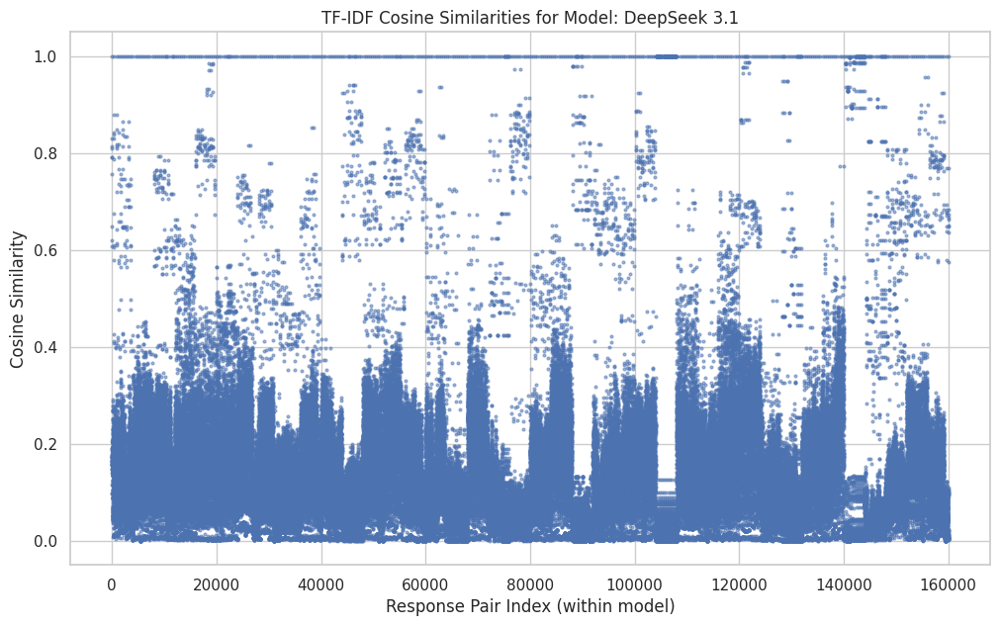

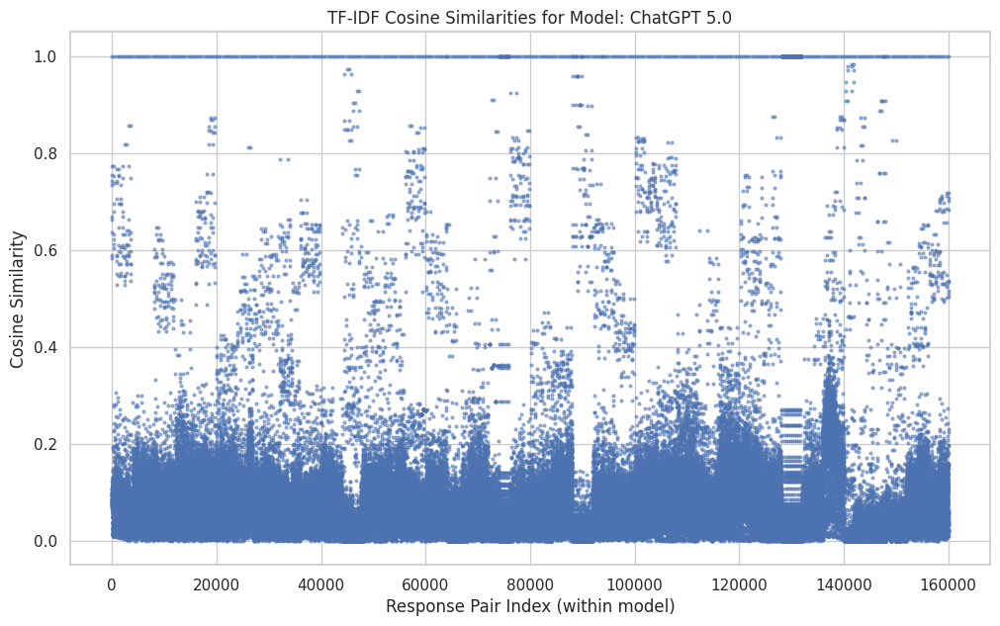

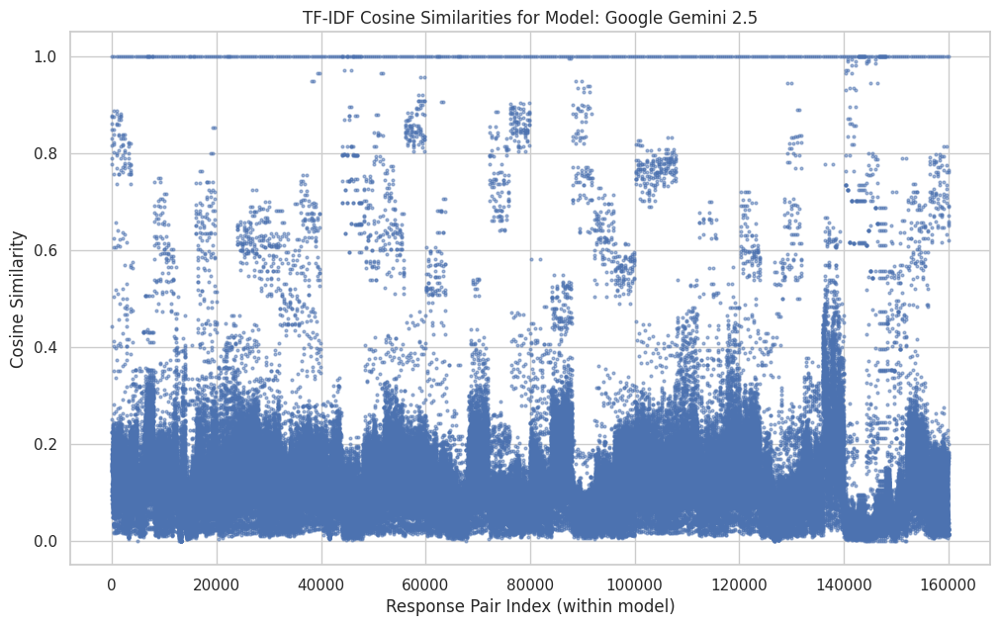

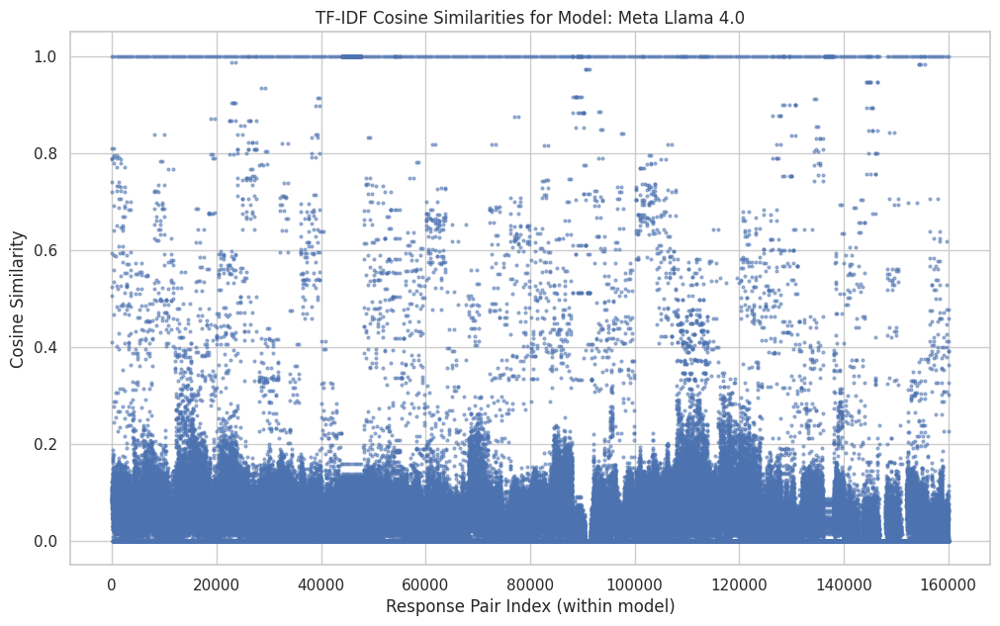

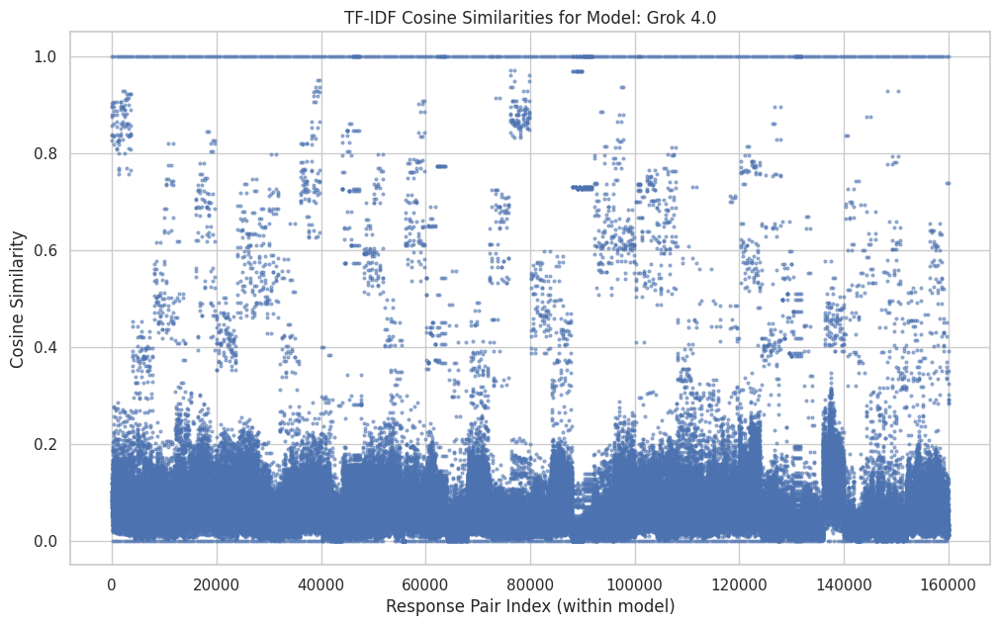

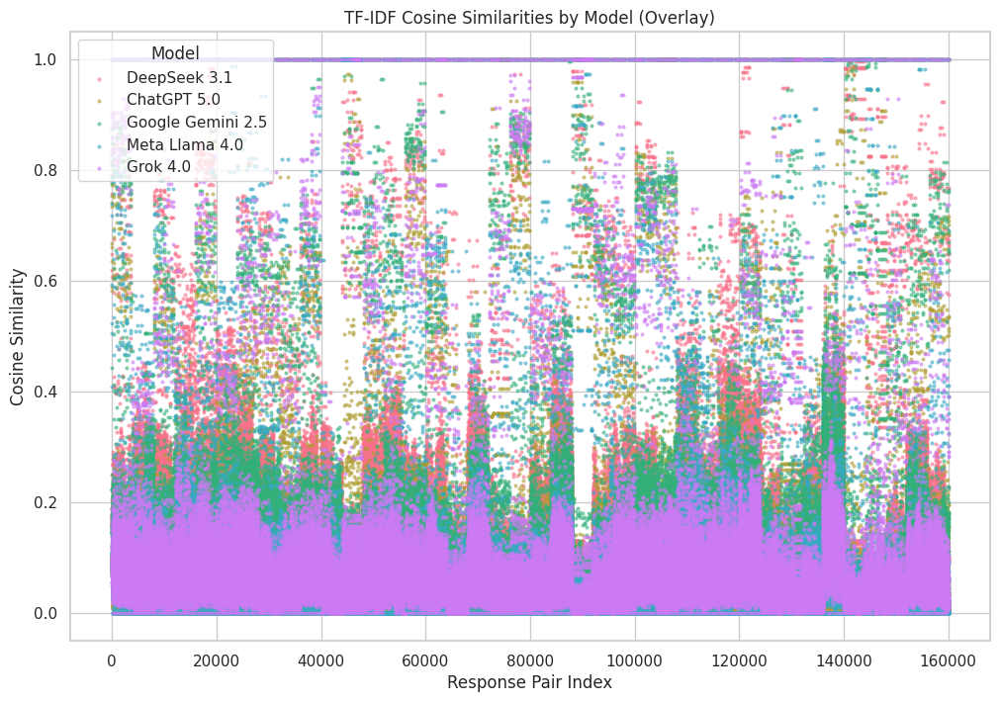

In [ ]:
# Separate scatter for each model, then one combined overlay

models = df['Model'].unique()

# 1) One scatter plot per model
for model_name in models:
    df_sub = df[df['Model'] == model_name].reset_index(drop=True)

    vectorizer_sub = TfidfVectorizer()
    tfidf_sub = vectorizer_sub.fit_transform(df_sub['Response Text'])

    sim_matrix_sub = cosine_similarity(tfidf_sub)

    similarities = sim_matrix_sub.flatten()
    x = np.arange(len(similarities))

    plt.figure(figsize=(12, 7))
    plt.scatter(x, similarities, s=4, alpha=0.5)
    plt.title(f"TF-IDF Cosine Similarities for Model: {model_name}")
    plt.xlabel("Response Pair Index (within model)")
    plt.ylabel("Cosine Similarity")
    plt.grid(True)
    plt.show()

# 2) Combined overlay scatter for all models
palette = sns.color_palette("husl", len(models))
color_map = dict(zip(models, palette))

plt.figure(figsize=(12, 8))

for model_name in models:
    df_sub = df[df['Model'] == model_name].reset_index(drop=True)

    vectorizer_sub = TfidfVectorizer()
    tfidf_sub = vectorizer_sub.fit_transform(df_sub['Response Text'])

    sim_matrix_sub = cosine_similarity(tfidf_sub)

    similarities = sim_matrix_sub.flatten()
    x = np.arange(len(similarities))

    plt.scatter(
        x,
        similarities,
        s=4,
        alpha=0.5,
        color=color_map[model_name],
        label=model_name
    )

plt.title("TF-IDF Cosine Similarities by Model (Overlay)")
plt.xlabel("Response Pair Index")
plt.ylabel("Cosine Similarity")
plt.legend(title="Model")
plt.grid(True)
plt.show()


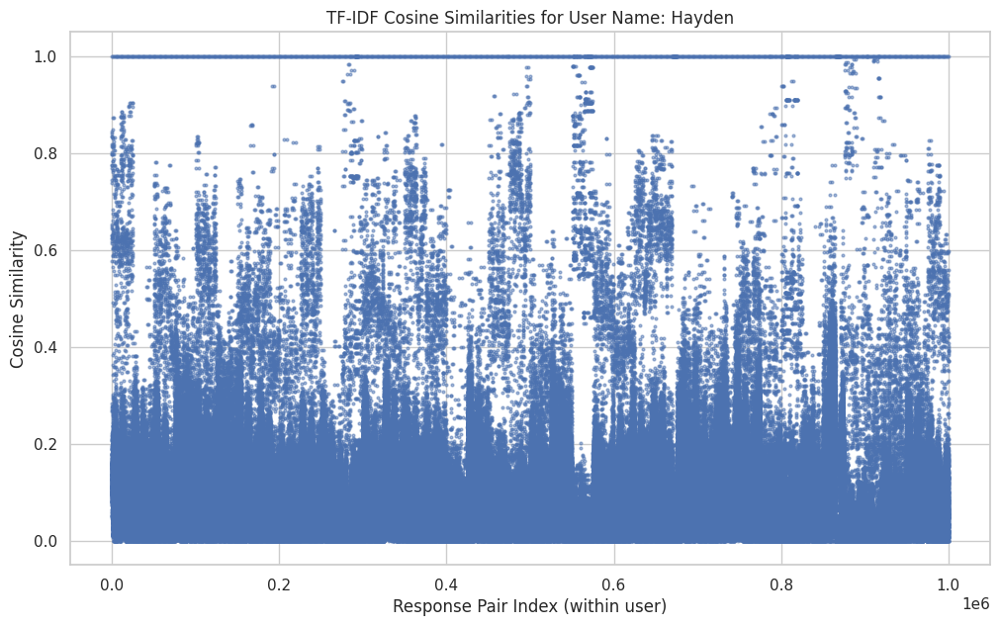

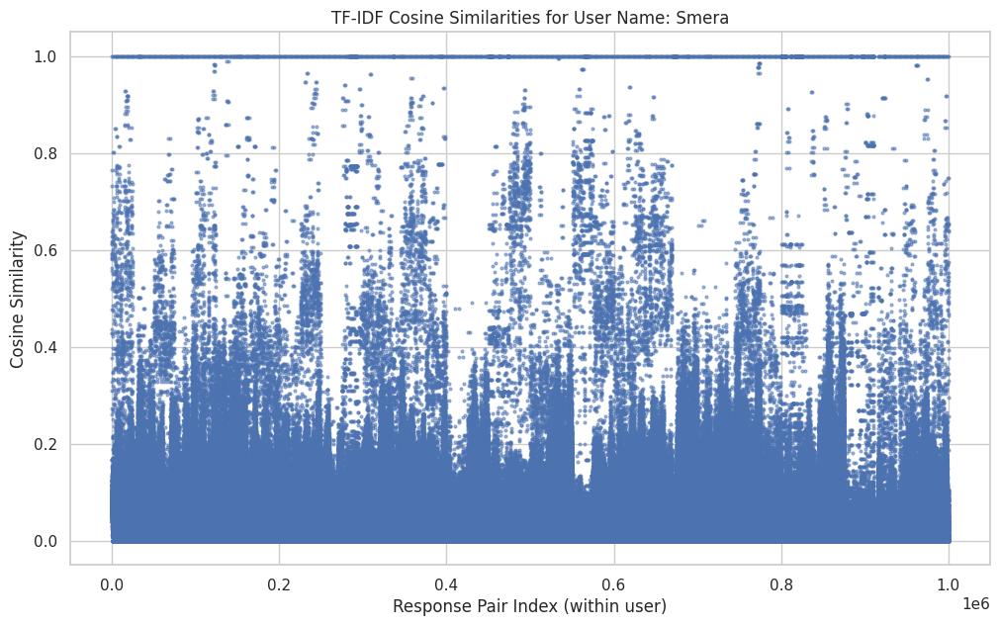

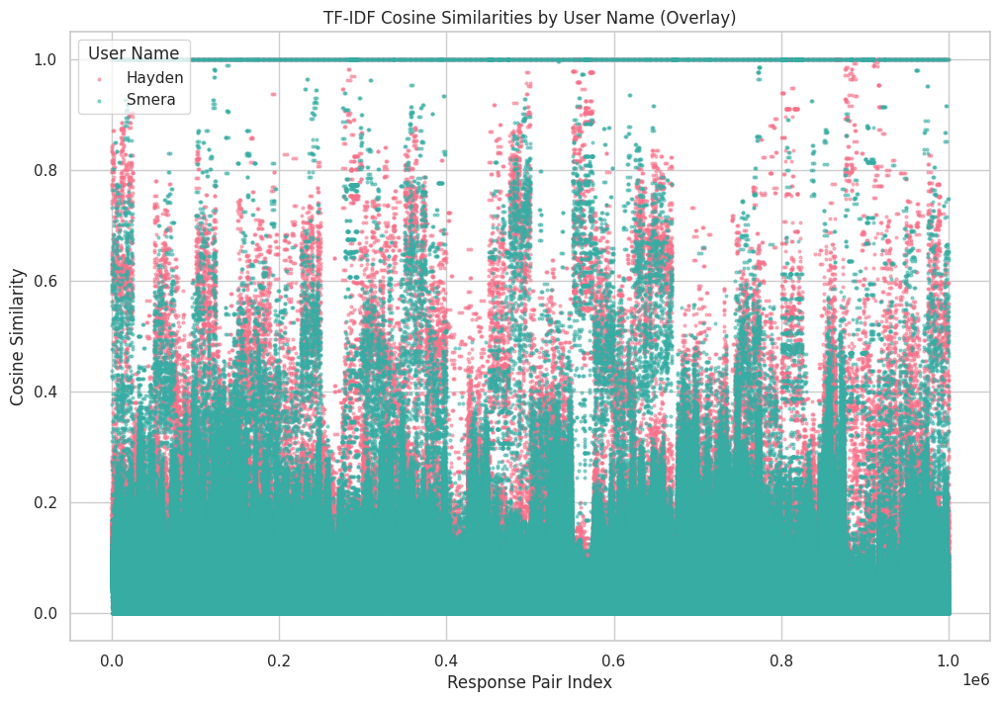

In [ ]:
# Replace this with your actual column name for the person who collected data
user_col = "User Name"  # change to match your column exactly
users = df[user_col].unique()

# 1) One scatter plot per user
for user_name in users:
    df_sub = df[df[user_col] == user_name].reset_index(drop=True)

    vectorizer_sub = TfidfVectorizer()
    tfidf_sub = vectorizer_sub.fit_transform(df_sub['Response Text'])

    sim_matrix_sub = cosine_similarity(tfidf_sub)

    similarities = sim_matrix_sub.flatten()
    x = np.arange(len(similarities))

    plt.figure(figsize=(12, 7))
    plt.scatter(x, similarities, s=4, alpha=0.5)
    plt.title(f"TF-IDF Cosine Similarities for {user_col}: {user_name}")
    plt.xlabel("Response Pair Index (within user)")
    plt.ylabel("Cosine Similarity")
    plt.grid(True)
    plt.show()

# 2) Combined overlay scatter for all users
palette = sns.color_palette("husl", len(users))
color_map = dict(zip(users, palette))

plt.figure(figsize=(12, 8))

for user_name in users:
    df_sub = df[df[user_col] == user_name].reset_index(drop=True)

    vectorizer_sub = TfidfVectorizer()
    tfidf_sub = vectorizer_sub.fit_transform(df_sub['Response Text'])

    sim_matrix_sub = cosine_similarity(tfidf_sub)

    similarities = sim_matrix_sub.flatten()
    x = np.arange(len(similarities))

    plt.scatter(
        x,
        similarities,
        s=4,
        alpha=0.5,
        color=color_map[user_name],
        label=user_name
    )

plt.title(f"TF-IDF Cosine Similarities by {user_col} (Overlay)")
plt.xlabel("Response Pair Index")
plt.ylabel("Cosine Similarity")
plt.legend(title=user_col)
plt.grid(True)
plt.show()


In [ ]:

def compute_similarity_summary(df, group_col, text_col='Response Text'):
    summaries = []
    for group_name, group_df in df.groupby(group_col):
        if len(group_df) > 1:
            # Build TF-IDF and compute cosine similarity
            vectorizer = TfidfVectorizer()
            tfidf_matrix = vectorizer.fit_transform(group_df[text_col])
            cos_sim_matrix = cosine_similarity(tfidf_matrix)

            # Take only upper triangle (unique pairs)
            upper_tri_indices = np.triu_indices_from(cos_sim_matrix, k=1)
            similarities = cos_sim_matrix[upper_tri_indices]

            # Collect stats
            summaries.append({
                group_col: group_name,
                'Mean': np.mean(similarities),
                'Median': np.median(similarities),
                'Std Dev': np.std(similarities),
                'Min': np.min(similarities),
                'Max': np.max(similarities),
                'Num Responses': len(group_df)
            })
    return pd.DataFrame(summaries).sort_values(by='Mean', ascending=False).reset_index(drop=True)

# --- Run the summaries ---
prompt_type_summary = compute_similarity_summary(df, 'Prompt Type')
model_summary = compute_similarity_summary(df, 'Model')
user_col = 'User Name' if 'User Name' in df.columns else 'User'
user_summary = compute_similarity_summary(df, user_col)

# --- Display results ---
print("\n--- TF-IDF Cosine Similarity Summary by Prompt Type ---")
display(prompt_type_summary)

print("\n--- TF-IDF Cosine Similarity Summary by Model ---")
display(model_summary)

print(f"\n--- TF-IDF Cosine Similarity Summary by {user_col} ---")
display(user_summary)



--- TF-IDF Cosine Similarity Summary by Prompt Type ---


,Prompt Type,Mean,Median,Std Dev,Min,Max,Num Responses
0,Vague Creative,0.158740,0.139254,0.100472,0.0,1.0,500
1,Vague Logical,0.130272,0.094776,0.127500,0.0,1.0,500
2,Specific Creative,0.117443,0.095562,0.097767,0.0,1.0,500
3,Specific Logical,0.103981,0.059973,0.147472,0.0,1.0,500



--- TF-IDF Cosine Similarity Summary by Model ---


,Model,Mean,Median,Std Dev,Min,Max,Num Responses
0,DeepSeek 3.1,0.145776,0.126446,0.119371,0.0,1.0,400
1,Google Gemini 2.5,0.129003,0.111393,0.099607,0.0,1.0,400
2,ChatGPT 5.0,0.087777,0.076197,0.085471,0.0,1.0,400
3,Grok 4.0,0.078053,0.060976,0.083819,0.0,1.0,400
4,Meta Llama 4.0,0.068224,0.055951,0.082532,0.0,1.0,400



--- TF-IDF Cosine Similarity Summary by User Name ---


,User Name,Mean,Median,Std Dev,Min,Max,Num Responses
0,Hayden,0.095187,0.078870,0.085052,0.0,1.0,1000
1,Smera,0.085126,0.069062,0.080002,0.0,1.0,1000


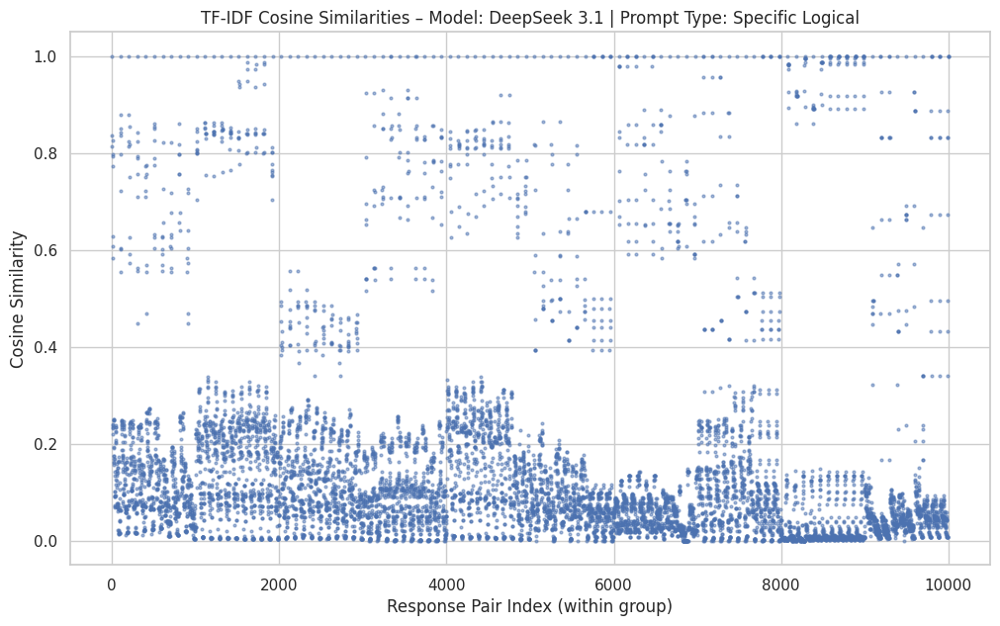

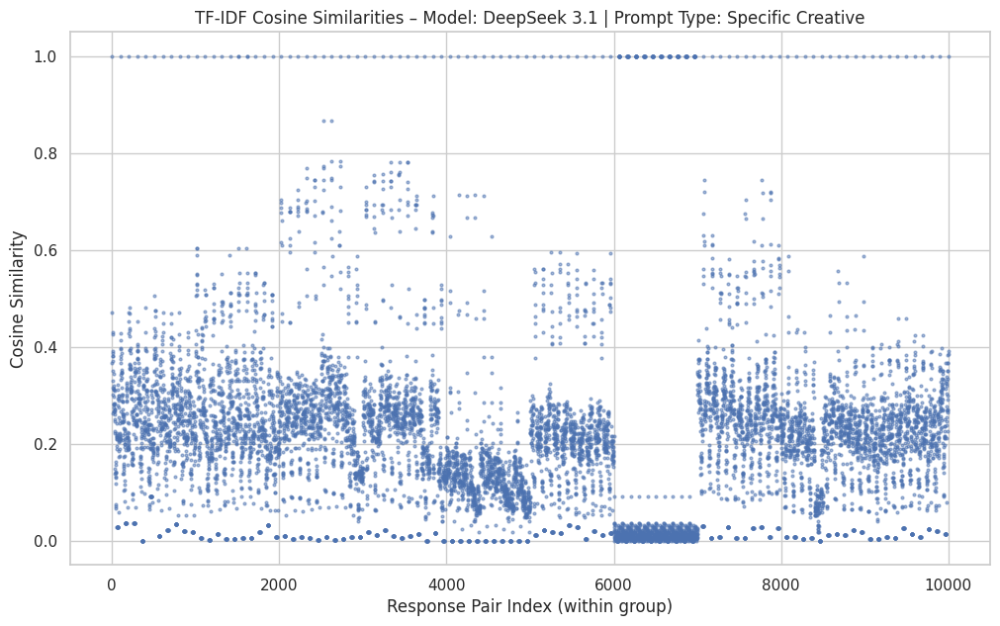

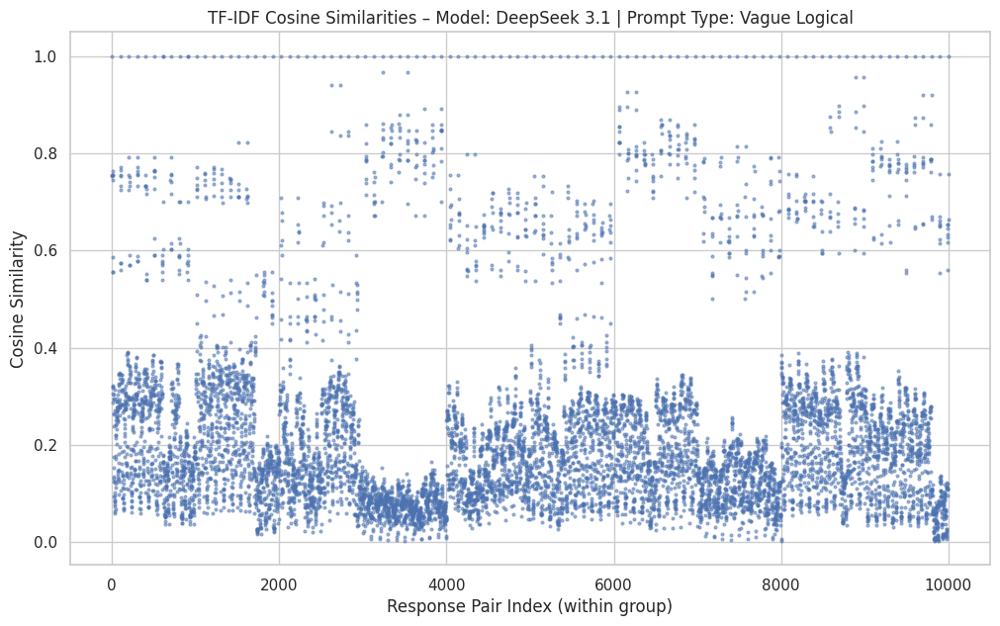

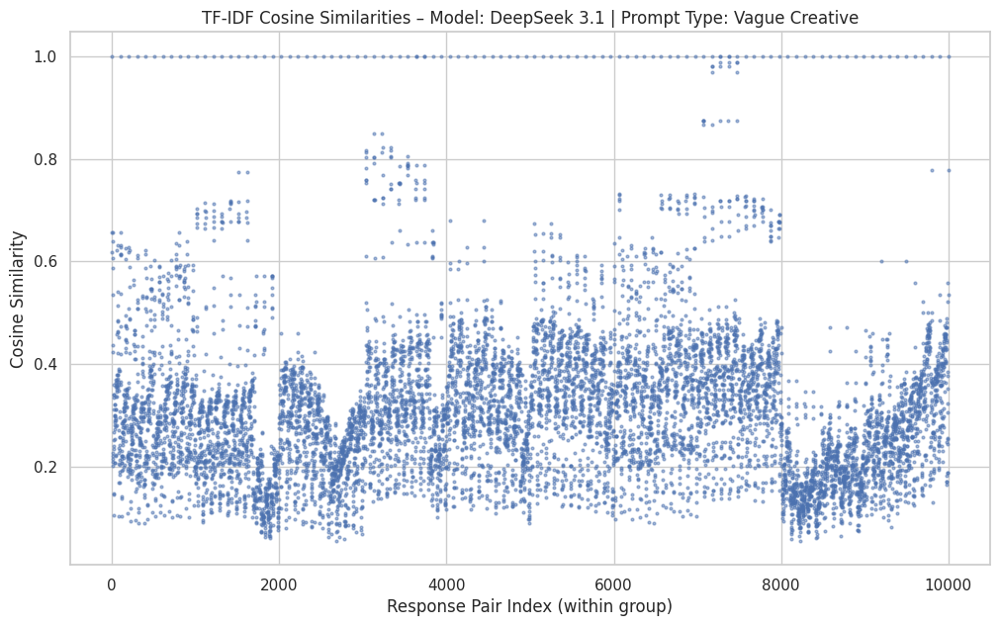

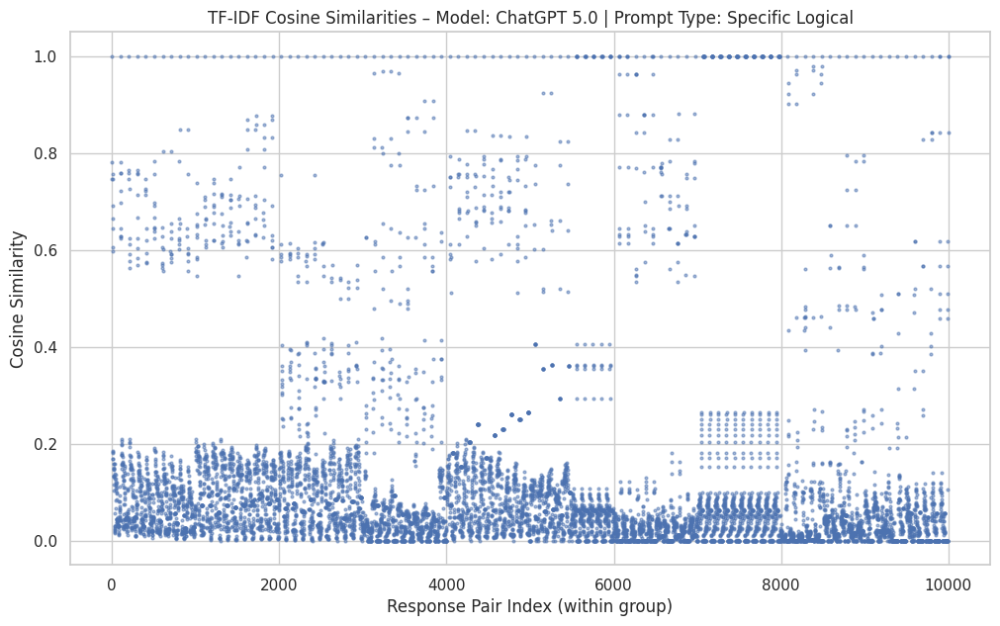

...

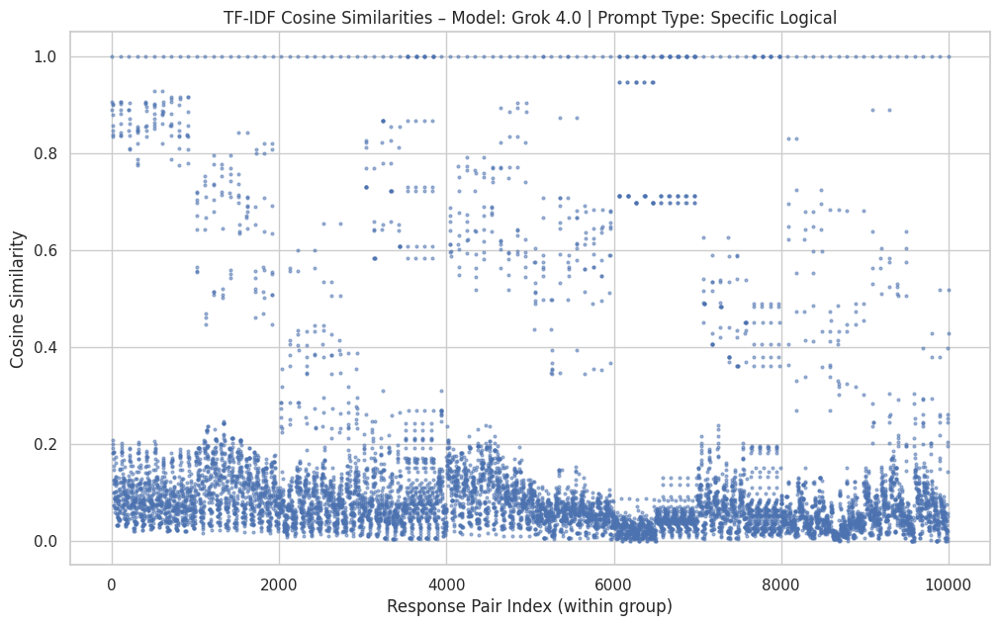

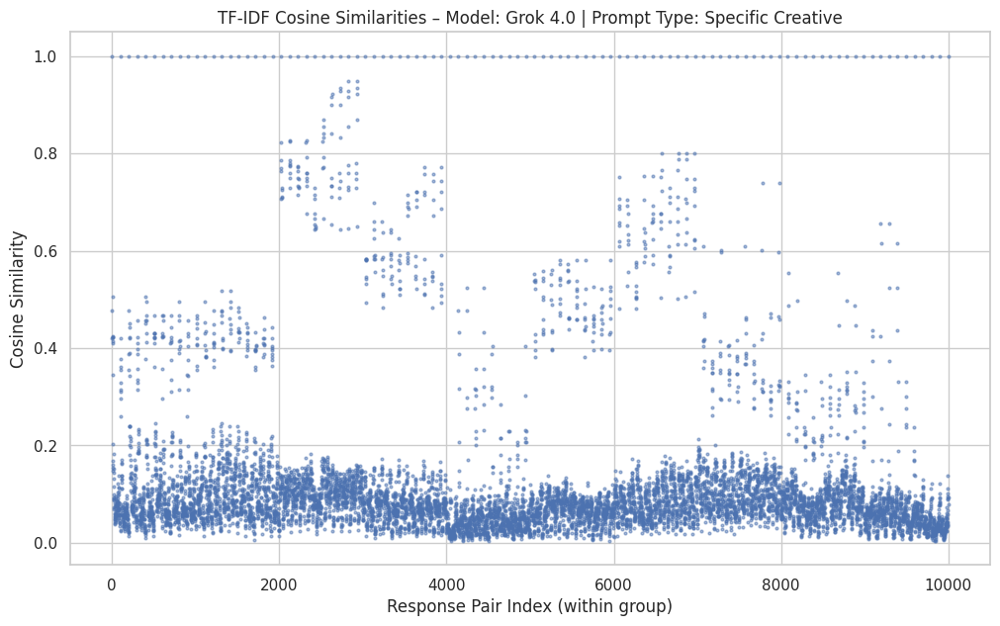

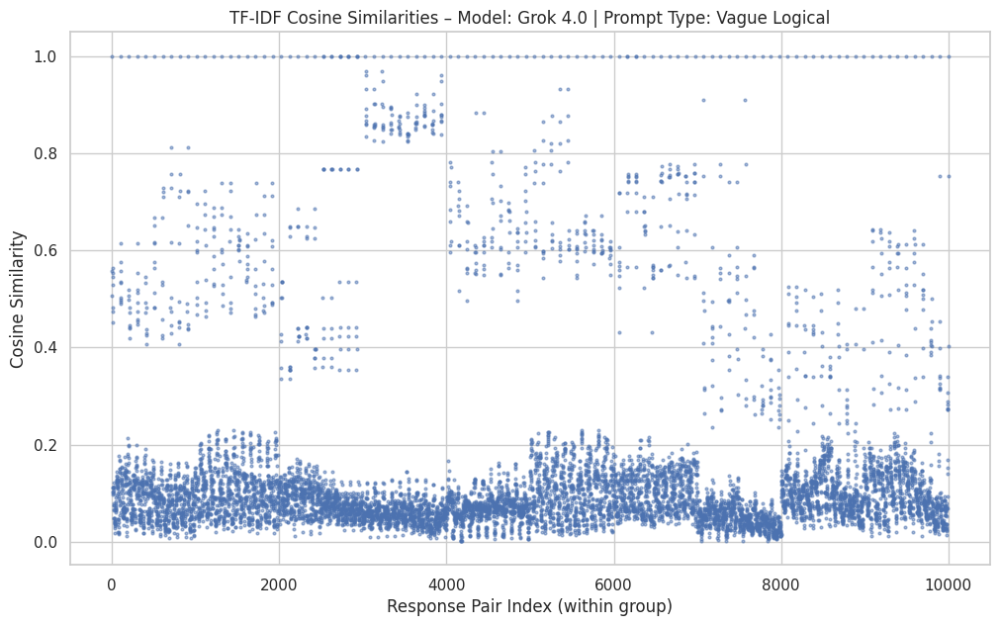

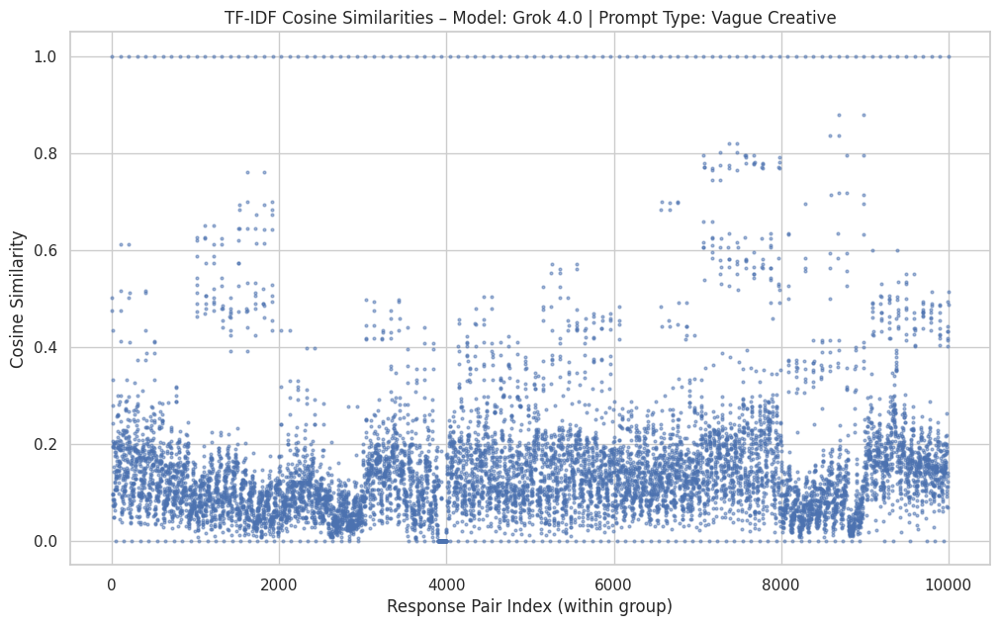

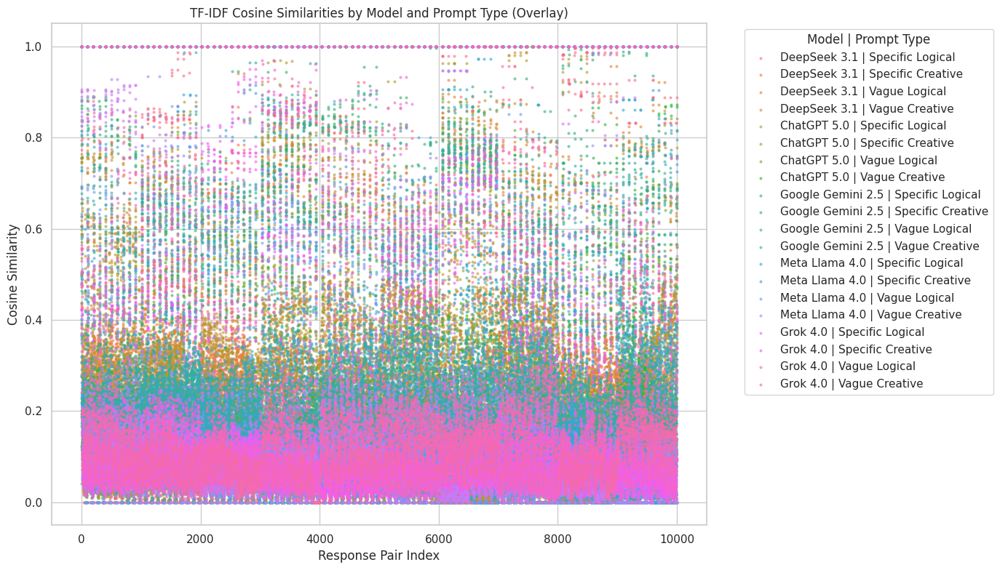

In [ ]:
# Scatter plots of TF-IDF cosine similarities by Model and Prompt Type

models = df['Model'].unique()
prompt_types = df['Prompt Type'].unique()

# 1) One scatter per Model × Prompt Type combination
for model_name in models:
    for ptype in prompt_types:
        df_sub = df[(df['Model'] == model_name) & (df['Prompt Type'] == ptype)].reset_index(drop=True)
        if len(df_sub) > 1:
            vectorizer_sub = TfidfVectorizer()
            tfidf_sub = vectorizer_sub.fit_transform(df_sub['Response Text'])
            sim_matrix_sub = cosine_similarity(tfidf_sub)
            similarities = sim_matrix_sub.flatten()
            x = np.arange(len(similarities))

            plt.figure(figsize=(12, 7))
            plt.scatter(x, similarities, s=4, alpha=0.5)
            plt.title(f"TF-IDF Cosine Similarities – Model: {model_name} | Prompt Type: {ptype}")
            plt.xlabel("Response Pair Index (within group)")
            plt.ylabel("Cosine Similarity")
            plt.grid(True)
            plt.show()

# 2) Combined overlay scatter for all Model × Prompt Type groups
combos = [(m, p) for m in models for p in prompt_types]
palette = sns.color_palette("husl", len(combos))
color_map = dict(zip(combos, palette))

plt.figure(figsize=(14, 8))

for (model_name, ptype) in combos:
    df_sub = df[(df['Model'] == model_name) & (df['Prompt Type'] == ptype)].reset_index(drop=True)
    if len(df_sub) > 1:
        vectorizer_sub = TfidfVectorizer()
        tfidf_sub = vectorizer_sub.fit_transform(df_sub['Response Text'])
        sim_matrix_sub = cosine_similarity(tfidf_sub)
        similarities = sim_matrix_sub.flatten()
        x = np.arange(len(similarities))

        plt.scatter(
            x,
            similarities,
            s=4,
            alpha=0.5,
            color=color_map[(model_name, ptype)],
            label=f"{model_name} | {ptype}"
        )

plt.title("TF-IDF Cosine Similarities by Model and Prompt Type (Overlay)")
plt.xlabel("Response Pair Index")
plt.ylabel("Cosine Similarity")
plt.legend(title="Model | Prompt Type", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
# --- TF-IDF Cosine Similarity Summary by Model and Prompt Type ---

summaries = []

for (model_name, ptype), group_df in df.groupby(['Model', 'Prompt Type']):
    if len(group_df) > 1:
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(group_df['Response Text'])
        cos_sim_matrix = cosine_similarity(tfidf_matrix)

        # Take only upper triangle (unique pairs)
        upper_tri_indices = np.triu_indices_from(cos_sim_matrix, k=1)
        similarities = cos_sim_matrix[upper_tri_indices]

        # Collect summary stats
        summaries.append({
            'Model': model_name,
            'Prompt Type': ptype,
            'Mean': np.mean(similarities),
            'Median': np.median(similarities),
            'Std Dev': np.std(similarities),
            'Min': np.min(similarities),
            'Max': np.max(similarities),
            'Num Responses': len(group_df)
        })

# Convert to DataFrame and sort by Model then Mean similarity
summary_df = pd.DataFrame(summaries).sort_values(['Model', 'Mean'], ascending=[True, False]).reset_index(drop=True)

print("\n--- TF-IDF Cosine Similarity Summary by Model and Prompt Type ---")
display(summary_df)



--- TF-IDF Cosine Similarity Summary by Model and Prompt Type ---


,Model,Prompt Type,Mean,Median,Std Dev,Min,Max,Num Responses
0,ChatGPT 5.0,Vague Creative,0.181287,0.157948,0.103368,0.037637,0.871436,100
1,ChatGPT 5.0,Vague Logical,0.134804,0.100865,0.138894,0.000000,1.000000,100
2,ChatGPT 5.0,Specific Creative,0.122612,0.099720,0.100945,0.004259,0.820583,100
3,ChatGPT 5.0,Specific Logical,0.110612,0.051412,0.184908,0.000000,1.000000,100
4,DeepSeek 3.1,Vague Creative,0.303494,0.292280,0.129438,0.056148,1.000000,100
5,DeepSeek 3.1,Vague Logical,0.214333,0.166609,0.172134,0.003292,1.000000,100
6,DeepSeek 3.1,Specific Creative,0.204967,0.207190,0.155885,0.000000,1.000000,100
7,DeepSeek 3.1,Specific Logical,0.146592,0.082763,0.198289,0.000000,1.000000,100
8,Google Gemini 2.5,Vague Creative,0.238802,0.229522,0.127021,0.021998,1.000000,100
9,Google Gemini 2.5,Vague Logical,0.194459,0.158880,0.159072,0.012190,1.000000,100


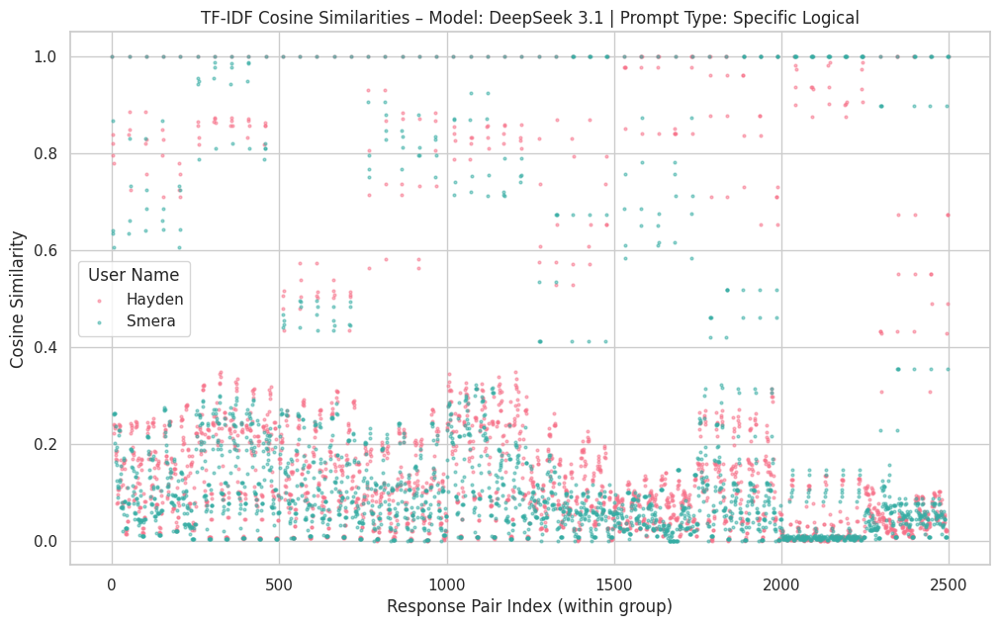

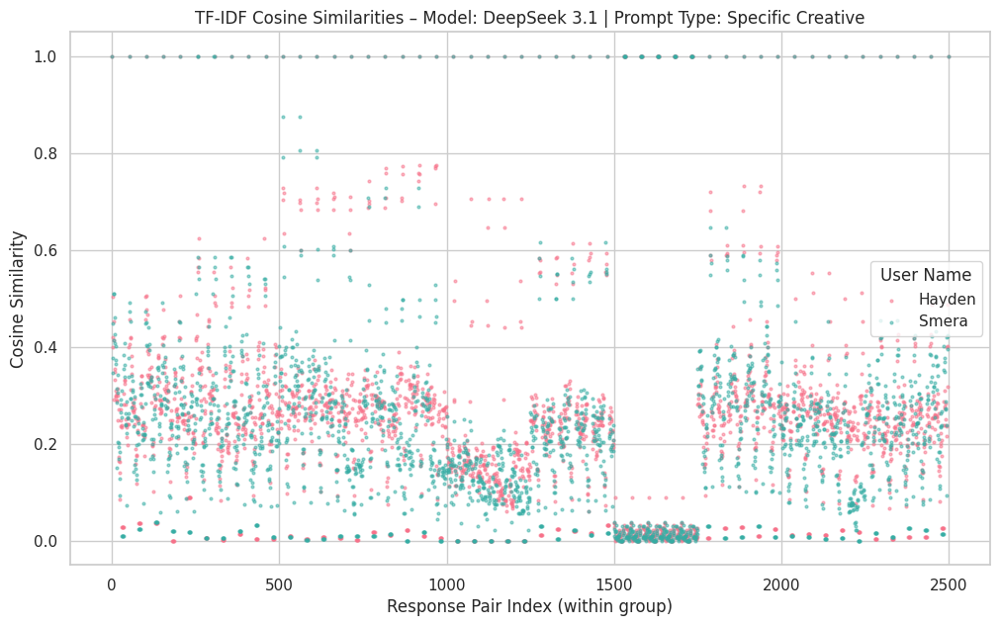

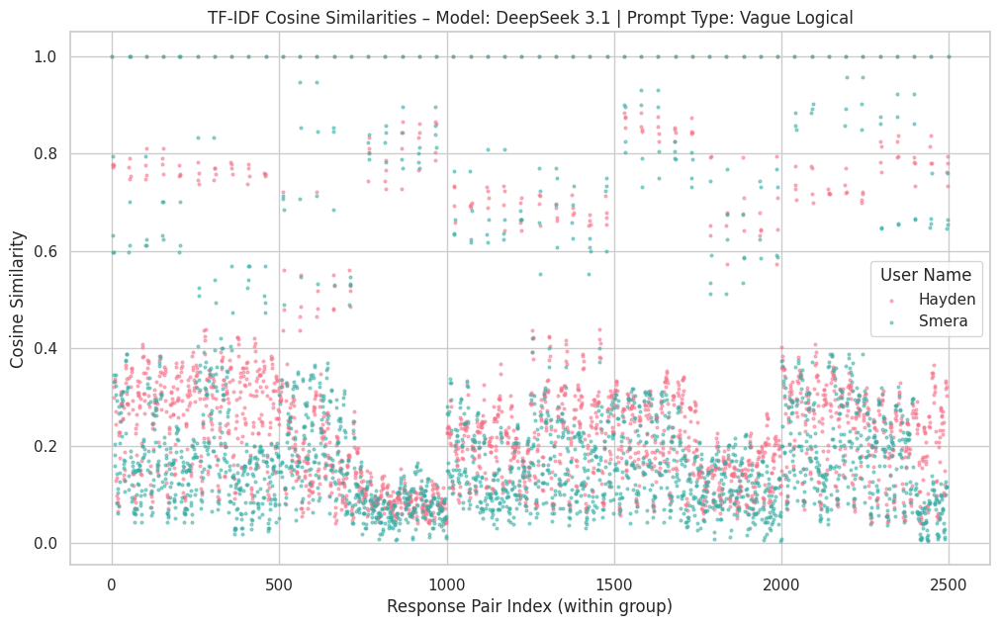

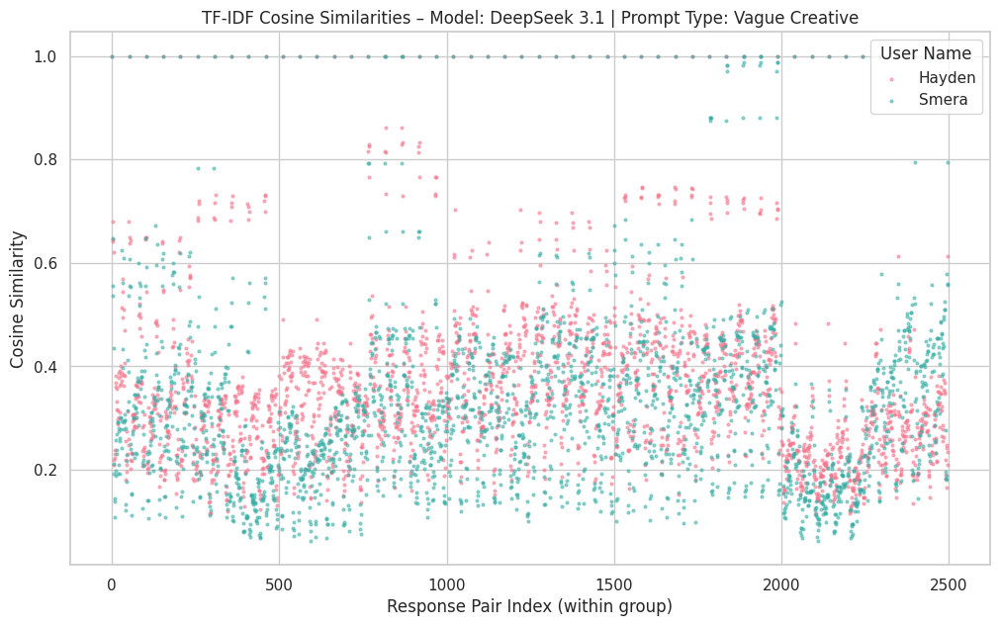

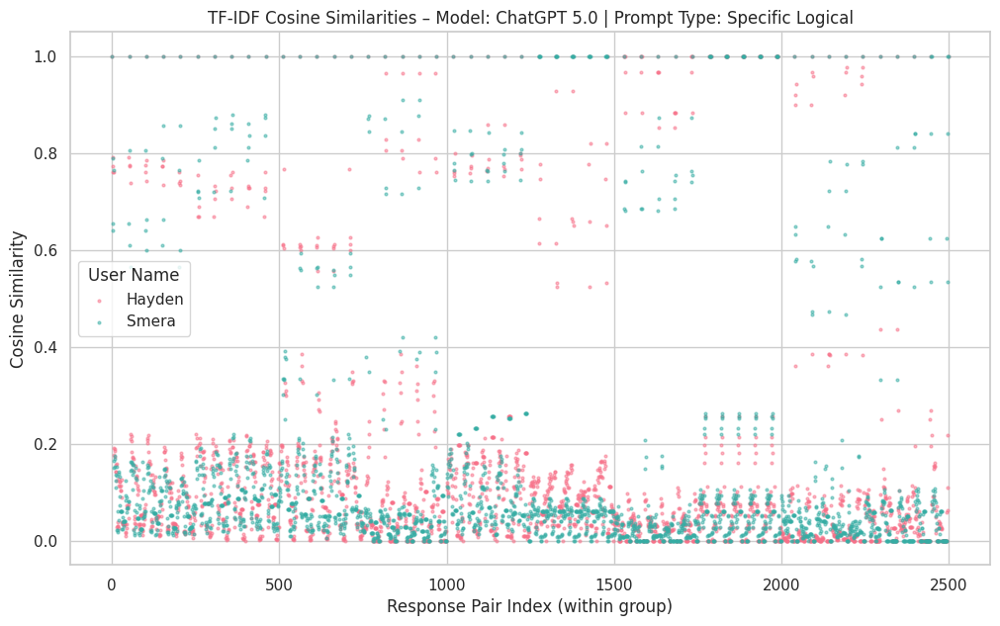

...

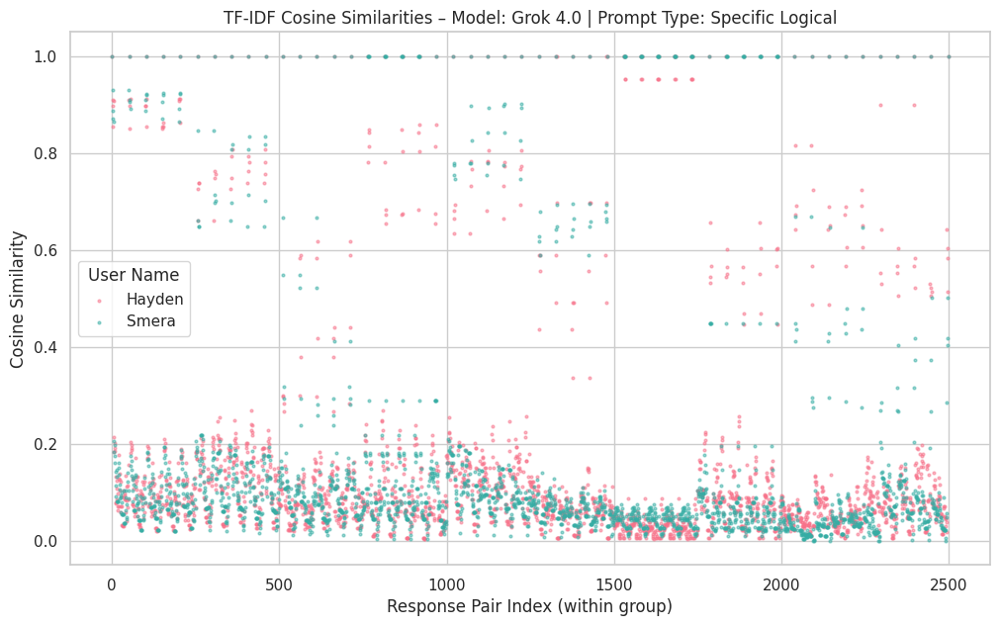

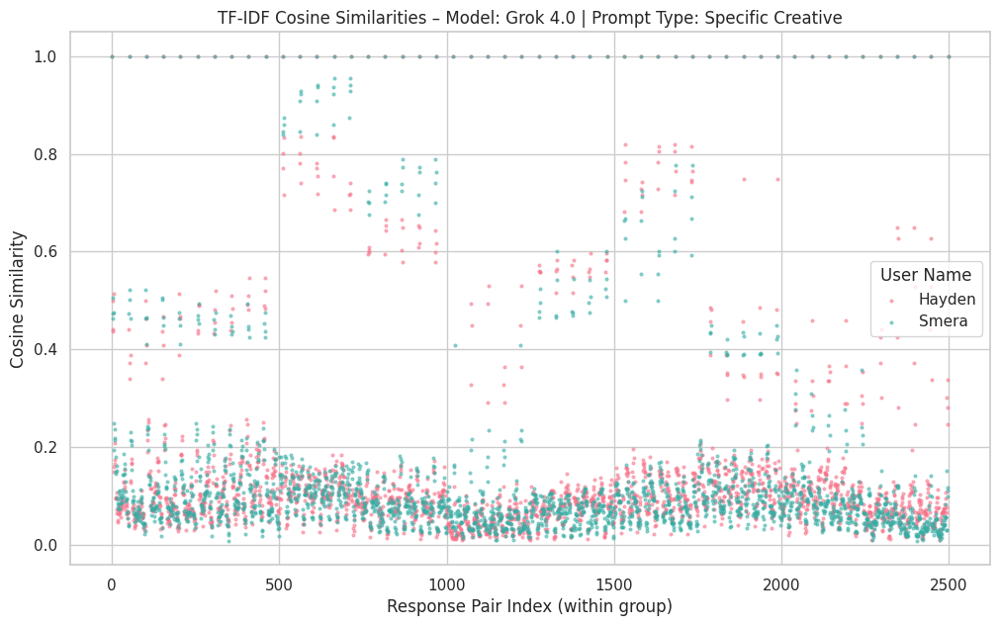

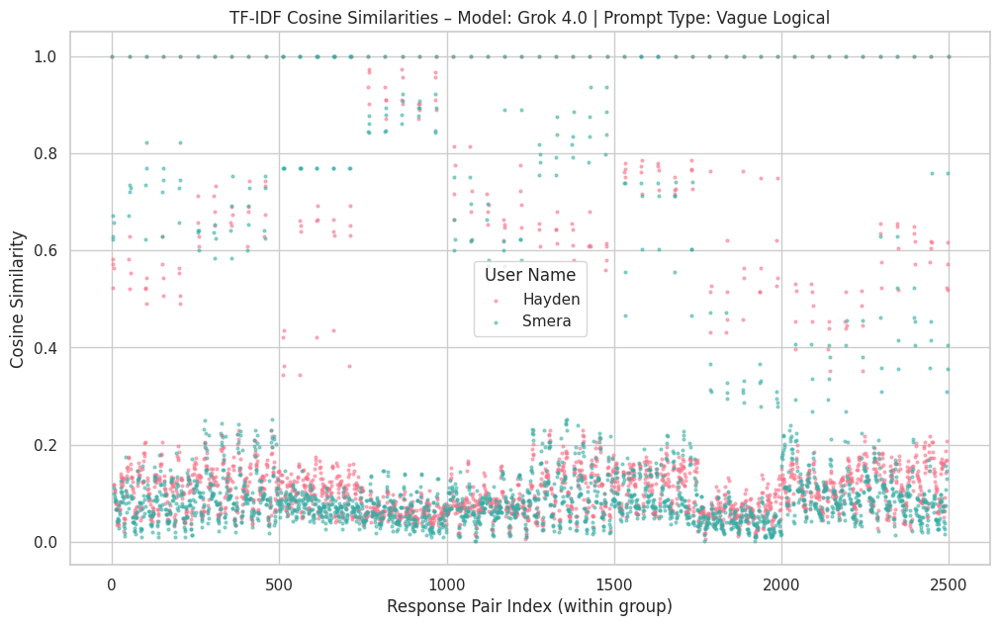

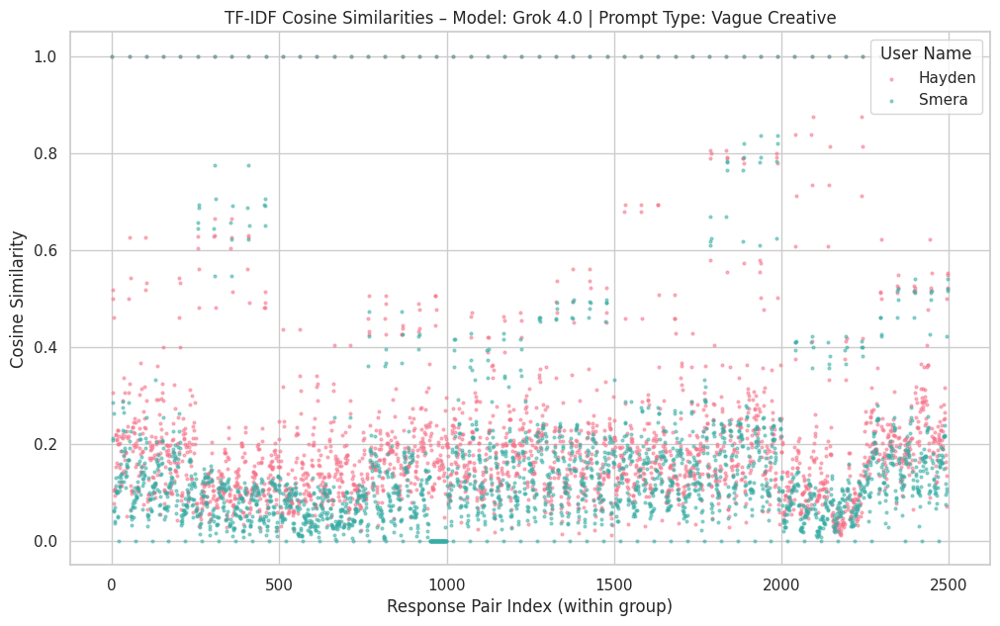

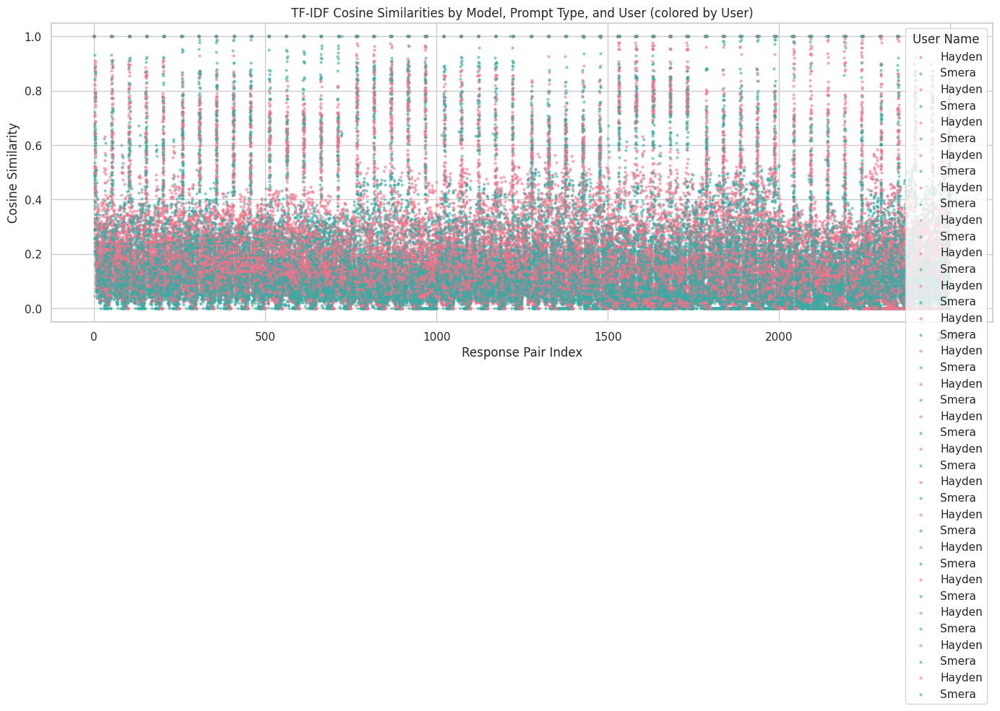

In [ ]:
# Scatter plots of TF-IDF cosine similarities by Model, Prompt Type, and User (colored by User)

models = df['Model'].unique()
prompt_types = df['Prompt Type'].unique()
user_col = 'User Name' if 'User Name' in df.columns else 'User'

palette = sns.color_palette("husl", len(df[user_col].unique()))
user_colors = dict(zip(df[user_col].unique(), palette))

# 1) One scatter per Model × Prompt Type combination, colored by User
for model_name in models:
    for ptype in prompt_types:
        df_sub = df[(df['Model'] == model_name) & (df['Prompt Type'] == ptype)].reset_index(drop=True)
        if len(df_sub) > 1:
            plt.figure(figsize=(12, 7))

            for user_name, user_df in df_sub.groupby(user_col):
                vectorizer_sub = TfidfVectorizer()
                tfidf_sub = vectorizer_sub.fit_transform(user_df['Response Text'])
                sim_matrix_sub = cosine_similarity(tfidf_sub)
                similarities = sim_matrix_sub.flatten()
                x = np.arange(len(similarities))

                plt.scatter(
                    x,
                    similarities,
                    s=4,
                    alpha=0.5,
                    color=user_colors[user_name],
                    label=user_name
                )

            plt.title(f"TF-IDF Cosine Similarities – Model: {model_name} | Prompt Type: {ptype}")
            plt.xlabel("Response Pair Index (within group)")
            plt.ylabel("Cosine Similarity")
            plt.legend(title=user_col)
            plt.grid(True)
            plt.show()

# 2) Combined overlay scatter for all Model × Prompt Type, colored by User
plt.figure(figsize=(14, 8))

for model_name in models:
    for ptype in prompt_types:
        df_sub = df[(df['Model'] == model_name) & (df['Prompt Type'] == ptype)].reset_index(drop=True)
        if len(df_sub) > 1:
            for user_name, user_df in df_sub.groupby(user_col):
                vectorizer_sub = TfidfVectorizer()
                tfidf_sub = vectorizer_sub.fit_transform(user_df['Response Text'])
                sim_matrix_sub = cosine_similarity(tfidf_sub)
                similarities = sim_matrix_sub.flatten()
                x = np.arange(len(similarities))

                plt.scatter(
                    x,
                    similarities,
                    s=4,
                    alpha=0.5,
                    color=user_colors[user_name],
                    label=user_name
                )

plt.title("TF-IDF Cosine Similarities by Model, Prompt Type, and User (colored by User)")
plt.xlabel("Response Pair Index")
plt.ylabel("Cosine Similarity")
plt.legend(title=user_col)
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
# --- TF-IDF Cosine Similarity Summary by Model, Prompt Type, and User ---

user_col = 'User Name' if 'User Name' in df.columns else 'User'

summaries = []

for (model_name, ptype, user_name), group_df in df.groupby(['Model', 'Prompt Type', user_col]):
    if len(group_df) > 1:
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(group_df['Response Text'])
        cos_sim_matrix = cosine_similarity(tfidf_matrix)

        # Take only upper triangle (unique pairs)
        upper_tri_indices = np.triu_indices_from(cos_sim_matrix, k=1)
        similarities = cos_sim_matrix[upper_tri_indices]

        # Collect summary stats
        summaries.append({
            'Model': model_name,
            'Prompt Type': ptype,
            user_col: user_name,
            'Mean': np.mean(similarities),
            'Median': np.median(similarities),
            'Std Dev': np.std(similarities),
            'Min': np.min(similarities),
            'Max': np.max(similarities),
            'Num Responses': len(group_df)
        })

summary_df_user = pd.DataFrame(summaries).sort_values(
    ['Model', 'Prompt Type', 'Mean'], ascending=[True, True, False]
).reset_index(drop=True)

print("\n--- TF-IDF Cosine Similarity Summary by Model, Prompt Type, and User ---")
display(summary_df_user)



--- TF-IDF Cosine Similarity Summary by Model, Prompt Type, and User ---


,Model,Prompt Type,User Name,Mean,Median,Std Dev,Min,Max,Num Responses
0,ChatGPT 5.0,Specific Creative,Hayden,0.137422,0.110706,0.113173,0.012071,0.836772,50
1,ChatGPT 5.0,Specific Creative,Smera,0.131820,0.110364,0.103599,0.013038,0.771894,50
2,ChatGPT 5.0,Specific Logical,Hayden,0.121652,0.061700,0.198441,0.000000,1.000000,50
3,ChatGPT 5.0,Specific Logical,Smera,0.115935,0.052787,0.202302,0.000000,1.000000,50
4,ChatGPT 5.0,Vague Creative,Hayden,0.215283,0.188746,0.110739,0.061372,0.861924,50
5,ChatGPT 5.0,Vague Creative,Smera,0.177761,0.153941,0.108719,0.039543,0.874850,50
6,ChatGPT 5.0,Vague Logical,Smera,0.151891,0.115162,0.149069,0.000000,1.000000,50
7,ChatGPT 5.0,Vague Logical,Hayden,0.133338,0.100434,0.145635,0.008603,0.919195,50
8,DeepSeek 3.1,Specific Creative,Hayden,0.230283,0.241446,0.160539,0.000000,1.000000,50
9,DeepSeek 3.1,Specific Creative,Smera,0.208188,0.204697,0.158821,0.000000,1.000000,50


# **Embedding**

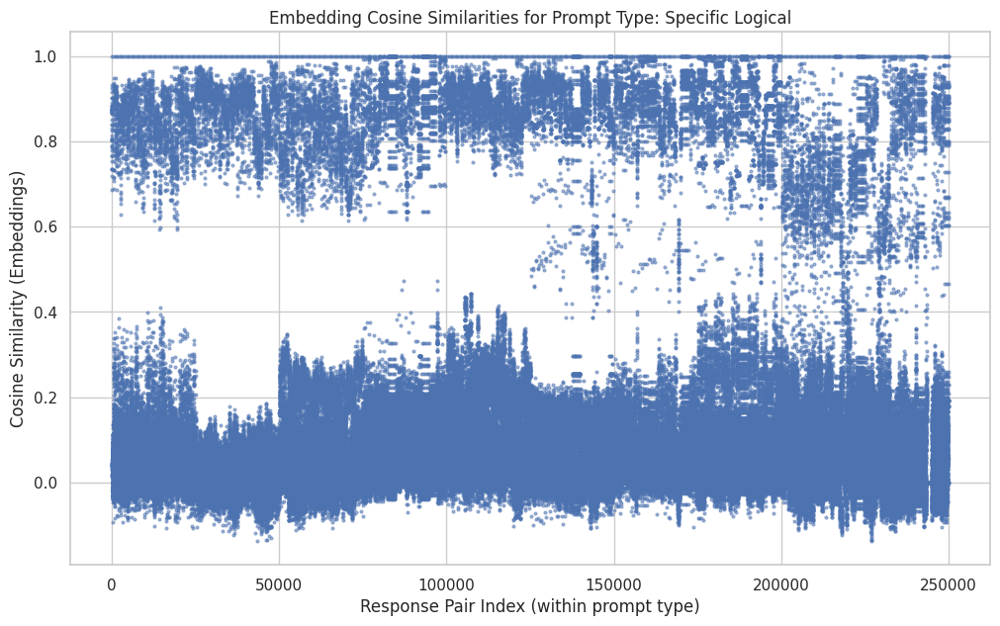

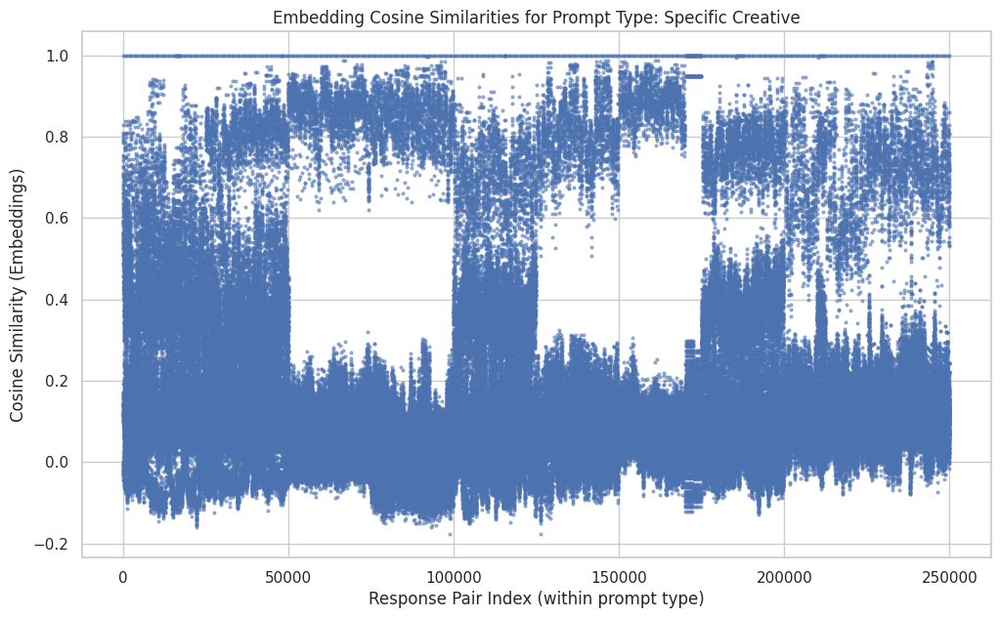

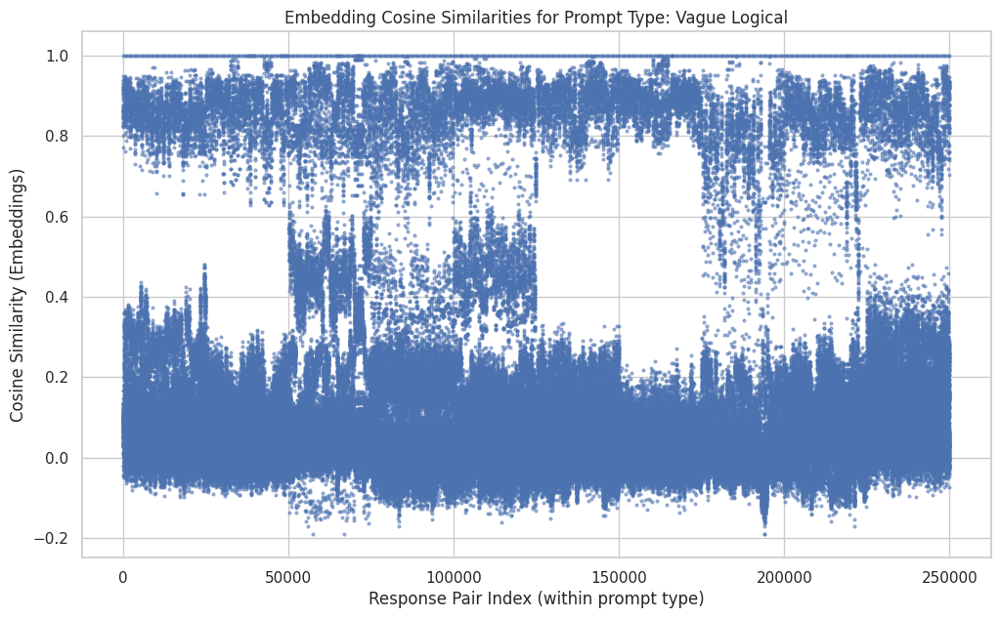

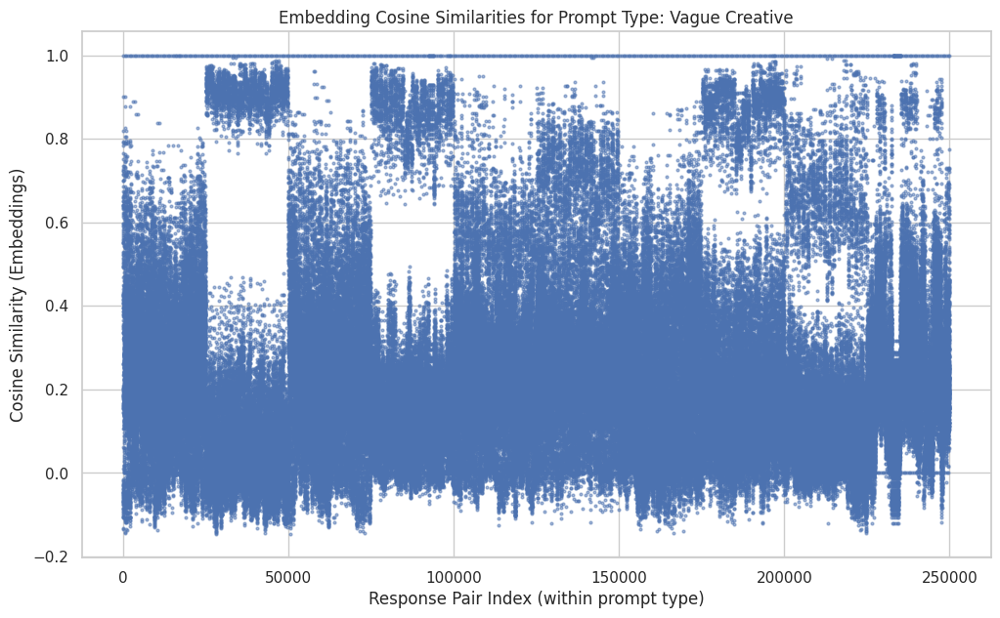

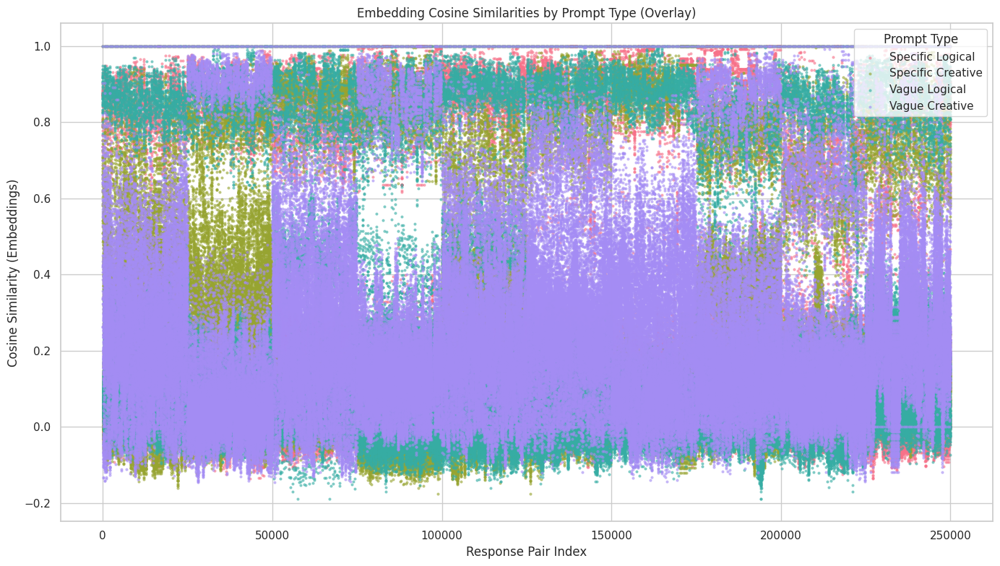

In [ ]:
# 1) Parse 'Response Embedding' safely into numpy arrays
def to_vector(x):
    if isinstance(x, str):
        try:
            x = ast.literal_eval(x)
        except (ValueError, SyntaxError):
            return None
    if isinstance(x, (list, tuple, np.ndarray)):
        arr = np.array(x, dtype=np.float32)
        return arr
    return None

df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# 2) Drop rows without valid embeddings
df_embed = df.dropna(subset=['embedding_vec']).copy()

# 3) Helper: cosine-similarity matrix from embeddings in a subset
def embed_cosine_matrix(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None
    mat = np.vstack(sub_df[emb_col].values)
    return cosine_similarity(mat)

# 4) Scatter plots by Prompt Type (one per type), then combined overlay
prompt_types = df_embed['Prompt Type'].unique()

# one scatter per prompt type (embedding similarities; includes self-similarities to mirror your TF-IDF style)
for ptype in prompt_types:
    sub = df_embed[df_embed['Prompt Type'] == ptype].reset_index(drop=True)
    sim_mat = embed_cosine_matrix(sub)
    if sim_mat is None:
        continue
    sims = sim_mat.flatten()
    x = np.arange(len(sims))
    plt.figure(figsize=(12, 7))
    plt.scatter(x, sims, s=4, alpha=0.5)
    plt.title(f'Embedding Cosine Similarities for Prompt Type: {ptype}')
    plt.xlabel('Response Pair Index (within prompt type)')
    plt.ylabel('Cosine Similarity (Embeddings)')
    plt.grid(True)
    plt.show()

# combined overlay colored by prompt type
palette = sns.color_palette('husl', len(prompt_types))
color_map = dict(zip(prompt_types, palette))

plt.figure(figsize=(14, 8))
for ptype in prompt_types:
    sub = df_embed[df_embed['Prompt Type'] == ptype].reset_index(drop=True)
    sim_mat = embed_cosine_matrix(sub)
    if sim_mat is None:
        continue
    sims = sim_mat.flatten()
    x = np.arange(len(sims))
    plt.scatter(x, sims, s=4, alpha=0.5, color=color_map[ptype], label=ptype)

plt.title('Embedding Cosine Similarities by Prompt Type (Overlay)')
plt.xlabel('Response Pair Index')
plt.ylabel('Cosine Similarity (Embeddings)')
plt.legend(title='Prompt Type')
plt.grid(True)
plt.tight_layout()
plt.show()

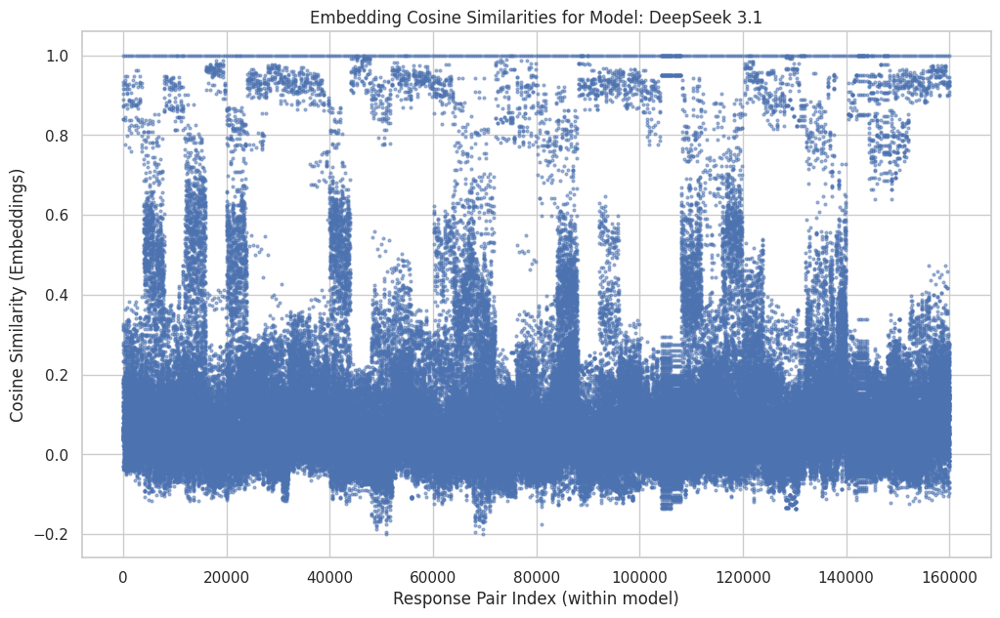

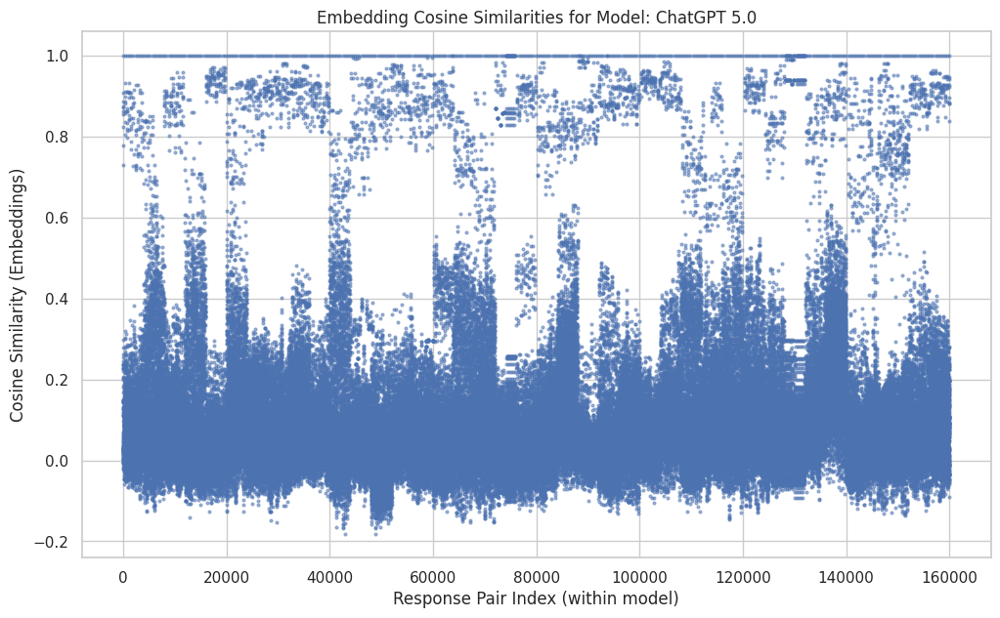

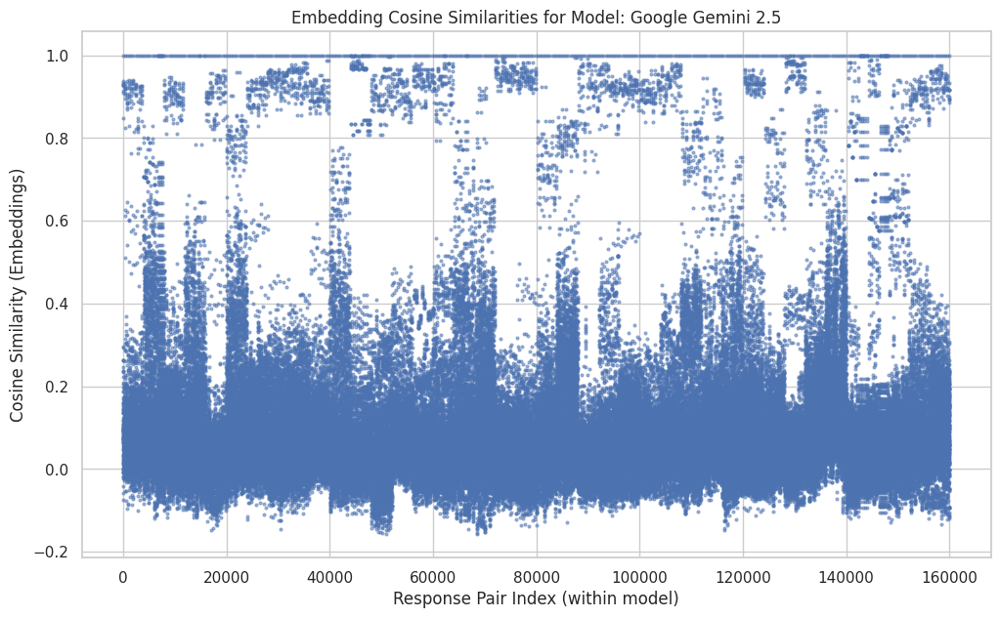

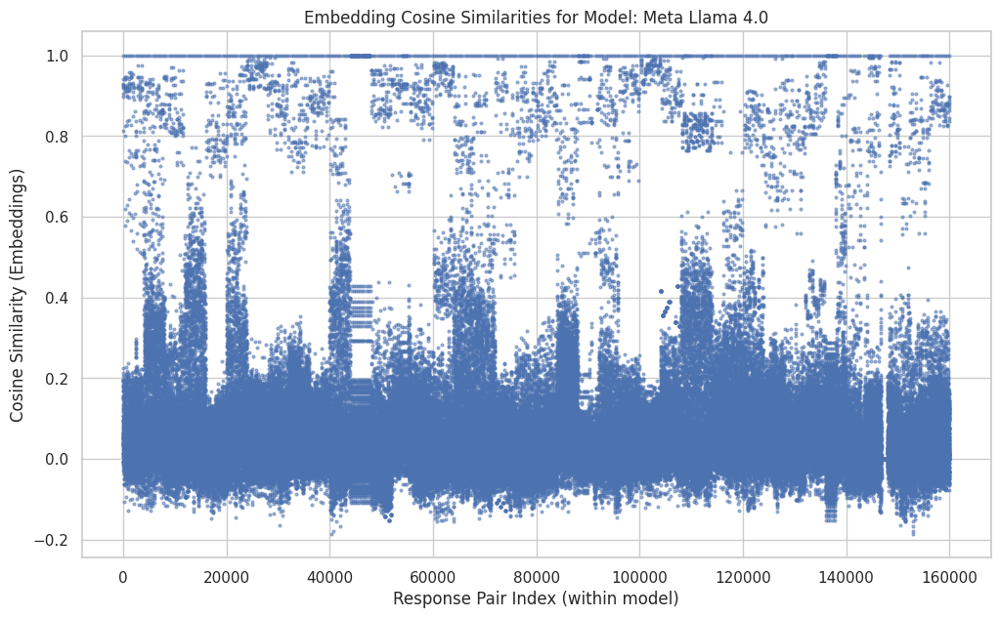

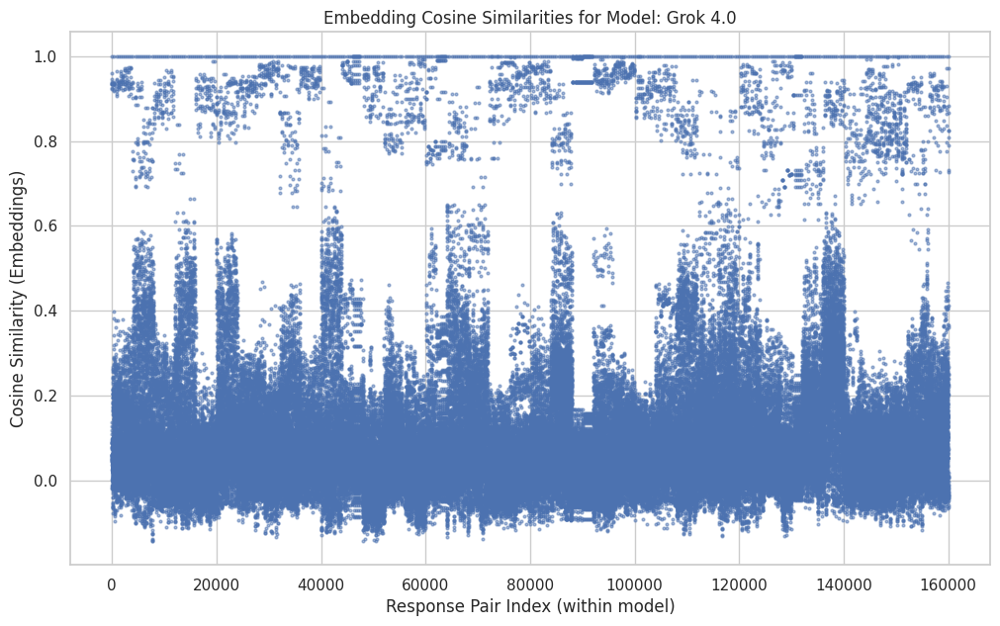

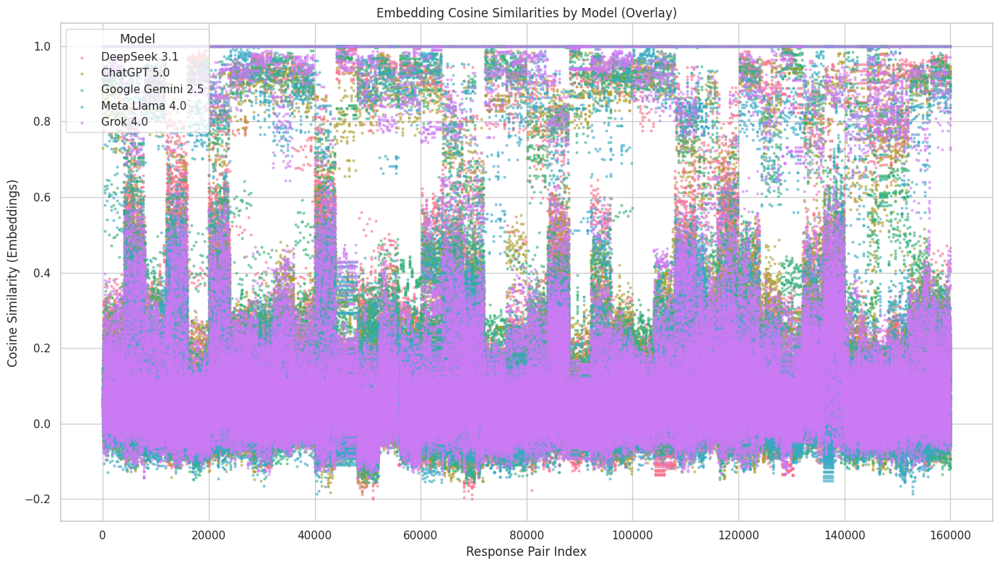

,Model,Mean,Median,Std Dev,Min,Max,Num Responses,Num Pairs,Mean-Median Diff
0,ChatGPT 5.0,0.108483,0.070814,0.157670,-0.181375,1.0,400,79800,0.037669
1,DeepSeek 3.1,0.107626,0.061839,0.169255,-0.198893,1.0,400,79800,0.045787
2,Google Gemini 2.5,0.103447,0.065302,0.157416,-0.156394,1.0,400,79800,0.038145
3,Grok 4.0,0.101031,0.060869,0.159049,-0.142723,1.0,400,79800,0.040162
4,Meta Llama 4.0,0.085380,0.051154,0.151311,-0.185299,1.0,400,79800,0.034226


In [ ]:
# BY MODELS
# ensure we have a parsed embedding vector column
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# drop rows without valid embeddings
df_embed = df.dropna(subset=['embedding_vec']).copy()

# helper to compute cosine similarity matrix from embeddings in a subset
def embed_cosine_matrix(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None
    mat = np.vstack(sub_df[emb_col].values)
    return cosine_similarity(mat)

models = df_embed['Model'].unique()

# 1) one scatter per model
for model_name in models:
    sub = df_embed[df_embed['Model'] == model_name].reset_index(drop=True)
    sim_mat = embed_cosine_matrix(sub)
    if sim_mat is None:
        continue
    sims = sim_mat.flatten()  # includes self-similarities to mirror your TF-IDF style
    x = np.arange(len(sims))
    plt.figure(figsize=(12, 7))
    plt.scatter(x, sims, s=4, alpha=0.5)
    plt.title(f'Embedding Cosine Similarities for Model: {model_name}')
    plt.xlabel('Response Pair Index (within model)')
    plt.ylabel('Cosine Similarity (Embeddings)')
    plt.grid(True)
    plt.show()

# 2) combined overlay colored by model
palette = sns.color_palette('husl', len(models))
color_map = dict(zip(models, palette))

plt.figure(figsize=(14, 8))
for model_name in models:
    sub = df_embed[df_embed['Model'] == model_name].reset_index(drop=True)
    sim_mat = embed_cosine_matrix(sub)
    if sim_mat is None:
        continue
    sims = sim_mat.flatten()
    x = np.arange(len(sims))
    plt.scatter(x, sims, s=4, alpha=0.5, color=color_map[model_name], label=model_name)

plt.title('Embedding Cosine Similarities by Model (Overlay)')
plt.xlabel('Response Pair Index')
plt.ylabel('Cosine Similarity (Embeddings)')
plt.legend(title='Model')
plt.grid(True)
plt.tight_layout()
plt.show()

# 3) numeric summary by model using upper triangle only (unique pairs)
rows = []
for model_name, g in df_embed.groupby('Model'):
    sim_mat = embed_cosine_matrix(g)
    if sim_mat is None:
        continue
    iu = np.triu_indices_from(sim_mat, k=1)
    vals = sim_mat[iu]
    if vals.size == 0:
        continue
    rows.append({
        'Model': model_name,
        'Mean': float(np.mean(vals)),
        'Median': float(np.median(vals)),
        'Std Dev': float(np.std(vals)),
        'Min': float(np.min(vals)),
        'Max': float(np.max(vals)),
        'Num Responses': int(len(g)),
        'Num Pairs': int(vals.size),
        'Mean-Median Diff': float(np.mean(vals) - np.median(vals))
    })

embed_model_summary = pd.DataFrame(rows).sort_values('Mean', ascending=False).reset_index(drop=True)
display(embed_model_summary)

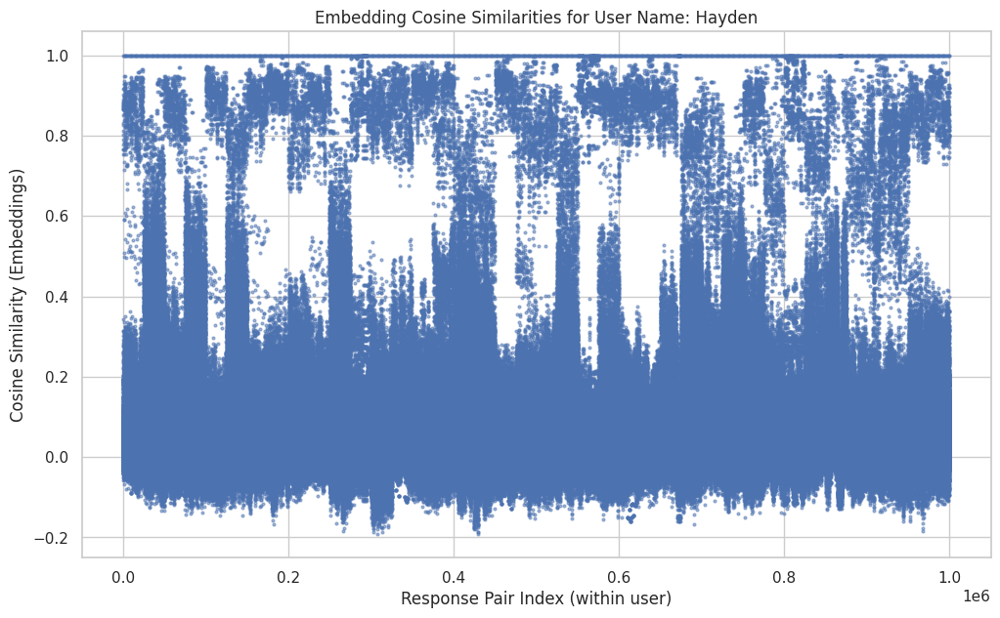

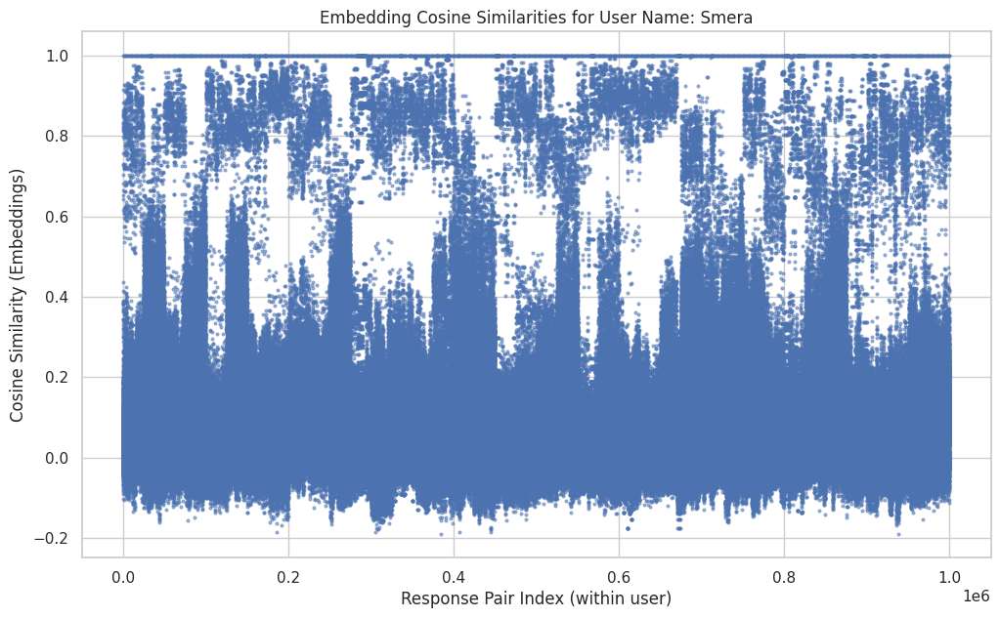

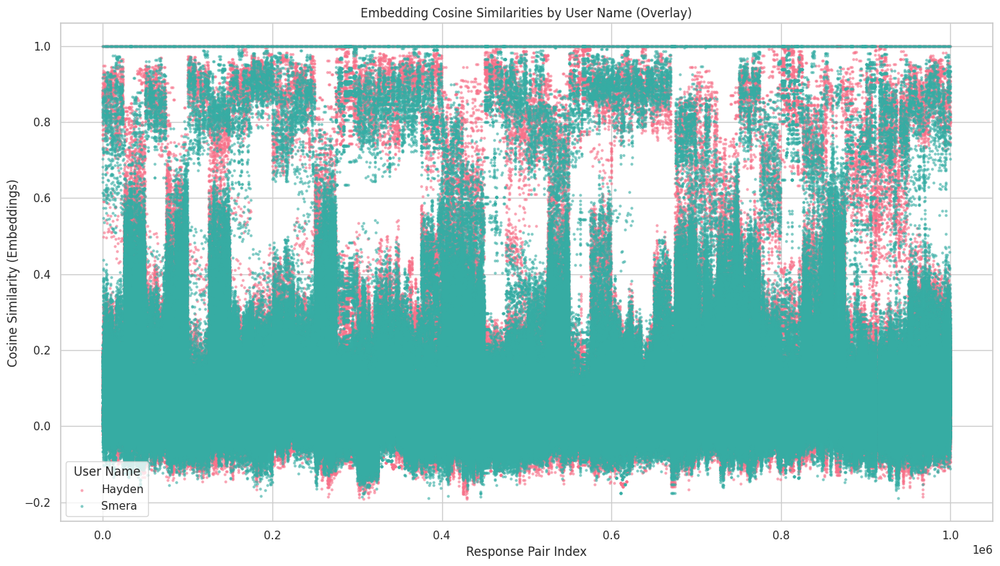

,User Name,Mean,Median,Std Dev,Min,Max,Num Responses,Num Pairs,Mean-Median Diff
0,Smera,0.099099,0.062122,0.152355,-0.189232,1.0,1000,499500,0.036977
1,Hayden,0.097654,0.059396,0.155447,-0.191062,1.0,1000,499500,0.038258


In [ ]:
# BY USERS
# ensure parsed embeddings exist
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# choose the user column
user_col = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# drop rows without valid embeddings
df_embed = df.dropna(subset=['embedding_vec']).copy()

# helper to compute cosine similarity matrix from embeddings in a subset
def embed_cosine_matrix(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None
    mat = np.vstack(sub_df[emb_col].values)
    return cosine_similarity(mat)

users = df_embed[user_col].unique()

# 1) one scatter per user
for uname in users:
    sub = df_embed[df_embed[user_col] == uname].reset_index(drop=True)
    sim_mat = embed_cosine_matrix(sub)
    if sim_mat is None:
        continue
    sims = sim_mat.flatten()  # includes self-similarities to mirror your TF-IDF style
    x = np.arange(len(sims))
    plt.figure(figsize=(12, 7))
    plt.scatter(x, sims, s=4, alpha=0.5)
    plt.title(f'Embedding Cosine Similarities for {user_col}: {uname}')
    plt.xlabel('Response Pair Index (within user)')
    plt.ylabel('Cosine Similarity (Embeddings)')
    plt.grid(True)
    plt.show()

# 2) combined overlay colored by user
palette = sns.color_palette('husl', len(users))
color_map = dict(zip(users, palette))

plt.figure(figsize=(14, 8))
for uname in users:
    sub = df_embed[df_embed[user_col] == uname].reset_index(drop=True)
    sim_mat = embed_cosine_matrix(sub)
    if sim_mat is None:
        continue
    sims = sim_mat.flatten()
    x = np.arange(len(sims))
    plt.scatter(x, sims, s=4, alpha=0.5, color=color_map[uname], label=uname)

plt.title(f'Embedding Cosine Similarities by {user_col} (Overlay)')
plt.xlabel('Response Pair Index')
plt.ylabel('Cosine Similarity (Embeddings)')
plt.legend(title=user_col)
plt.grid(True)
plt.tight_layout()
plt.show()

# 3) numeric summary by user using upper triangle only (unique pairs)
rows = []
for uname, g in df_embed.groupby(user_col):
    sim_mat = embed_cosine_matrix(g)
    if sim_mat is None:
        continue
    iu = np.triu_indices_from(sim_mat, k=1)
    vals = sim_mat[iu]
    if vals.size == 0:
        continue
    rows.append({
        user_col: uname,
        'Mean': float(np.mean(vals)),
        'Median': float(np.median(vals)),
        'Std Dev': float(np.std(vals)),
        'Min': float(np.min(vals)),
        'Max': float(np.max(vals)),
        'Num Responses': int(len(g)),
        'Num Pairs': int(vals.size),
        'Mean-Median Diff': float(np.mean(vals) - np.median(vals))
    })

embed_user_summary = pd.DataFrame(rows).sort_values('Mean', ascending=False).reset_index(drop=True)
display(embed_user_summary)

In [ ]:
# NUMERIC EMBEDDING SUMMARIES for Prompt Type, Model, and User
# - uses 'embedding_vec' (parsed from 'Response Embedding'); parses if missing
# - computes Mean, Median, Std Dev, Min, Max, Num Responses, Num Pairs, Mean–Median Diff
# ensure parsed embeddings exist
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# drop rows without valid embeddings
df_embed = df.dropna(subset=['embedding_vec']).copy()

# helper: cosine matrix from embeddings in a subset
def embed_cosine_matrix(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None
    mat = np.vstack(sub_df[emb_col].values)
    return cosine_similarity(mat)

# generic summary over groupby
def embedding_summary(df_in, group_cols):
    rows = []
    for keys, g in df_in.groupby(group_cols):
        sim_mat = embed_cosine_matrix(g)
        if sim_mat is None:
            continue
        iu = np.triu_indices_from(sim_mat, k=1)
        vals = sim_mat[iu]
        if vals.size == 0:
            continue
        rec = {
            'Mean': float(np.mean(vals)),
            'Median': float(np.median(vals)),
            'Std Dev': float(np.std(vals)),
            'Min': float(np.min(vals)),
            'Max': float(np.max(vals)),
            'Num Responses': int(len(g)),
            'Num Pairs': int(vals.size),
            'Mean-Median Diff': float(np.mean(vals) - np.median(vals)),
        }
        # attach group keys
        if isinstance(keys, tuple):
            for col, val in zip(group_cols, keys):
                rec[col] = val
        else:
            rec[group_cols[0]] = keys
        rows.append(rec)
    cols_first = group_cols + ['Mean','Median','Std Dev','Min','Max','Num Responses','Num Pairs','Mean-Median Diff']
    out = pd.DataFrame(rows)
    if not out.empty:
        out = out[cols_first].sort_values(group_cols + ['Mean'], ascending=[True]*len(group_cols) + [False]).reset_index(drop=True)
    return out

# choose user column
user_col = 'User Name' if 'User Name' in df_embed.columns else ('User' if 'User' in df_embed.columns else df_embed.columns[5])

# compute summaries
embed_prompt_summary = embedding_summary(df_embed, ['Prompt Type'])
embed_model_summary  = embedding_summary(df_embed, ['Model'])
embed_user_summary   = embedding_summary(df_embed, [user_col])

# display
print("\n--- Embedding Cosine Similarity Summary by Prompt Type ---")
display(embed_prompt_summary)

print("\n--- Embedding Cosine Similarity Summary by Model ---")
display(embed_model_summary)

print(f"\n--- Embedding Cosine Similarity Summary by {user_col} ---")
display(embed_user_summary)




--- Embedding Cosine Similarity Summary by Prompt Type ---


,Prompt Type,Mean,Median,Std Dev,Min,Max,Num Responses,Num Pairs,Mean-Median Diff
0,Specific Creative,0.183628,0.109982,0.228261,-0.176127,1.0,500,124750,0.073645
1,Specific Logical,0.144388,0.069050,0.238342,-0.136356,1.0,500,124750,0.075338
2,Vague Creative,0.223655,0.178766,0.205773,-0.145656,1.0,500,124750,0.044889
3,Vague Logical,0.150206,0.064385,0.250810,-0.189232,1.0,500,124750,0.085821



--- Embedding Cosine Similarity Summary by Model ---


,Model,Mean,Median,Std Dev,Min,Max,Num Responses,Num Pairs,Mean-Median Diff
0,ChatGPT 5.0,0.108483,0.070814,0.157670,-0.181375,1.0,400,79800,0.037669
1,DeepSeek 3.1,0.107626,0.061839,0.169255,-0.198893,1.0,400,79800,0.045787
2,Google Gemini 2.5,0.103447,0.065302,0.157416,-0.156394,1.0,400,79800,0.038145
3,Grok 4.0,0.101031,0.060869,0.159049,-0.142723,1.0,400,79800,0.040162
4,Meta Llama 4.0,0.085380,0.051154,0.151311,-0.185299,1.0,400,79800,0.034226



--- Embedding Cosine Similarity Summary by User Name ---


,User Name,Mean,Median,Std Dev,Min,Max,Num Responses,Num Pairs,Mean-Median Diff
0,Hayden,0.097654,0.059396,0.155447,-0.191062,1.0,1000,499500,0.038258
1,Smera,0.099099,0.062122,0.152355,-0.189232,1.0,1000,499500,0.036977


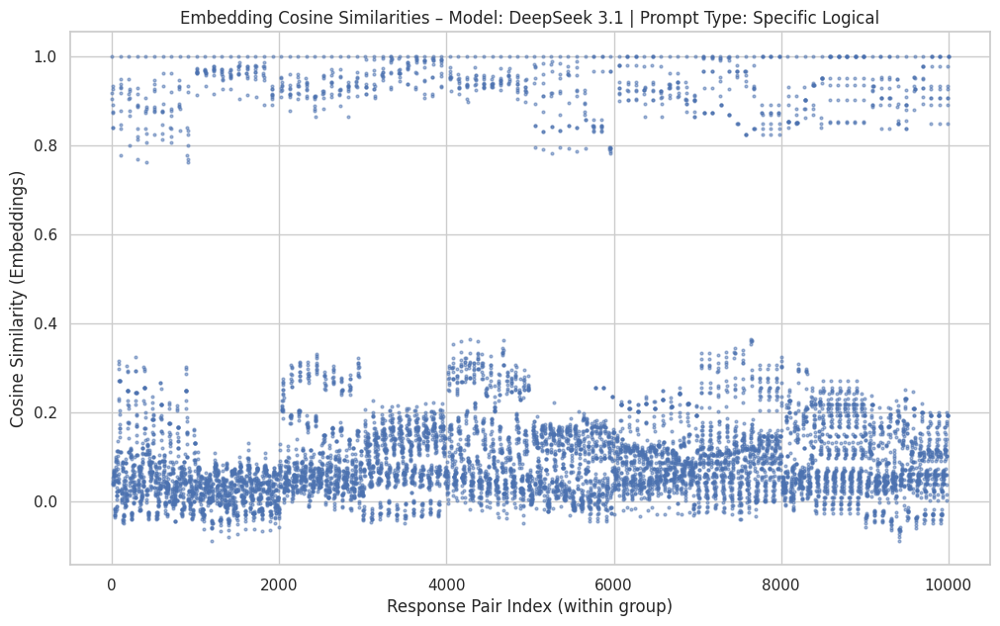

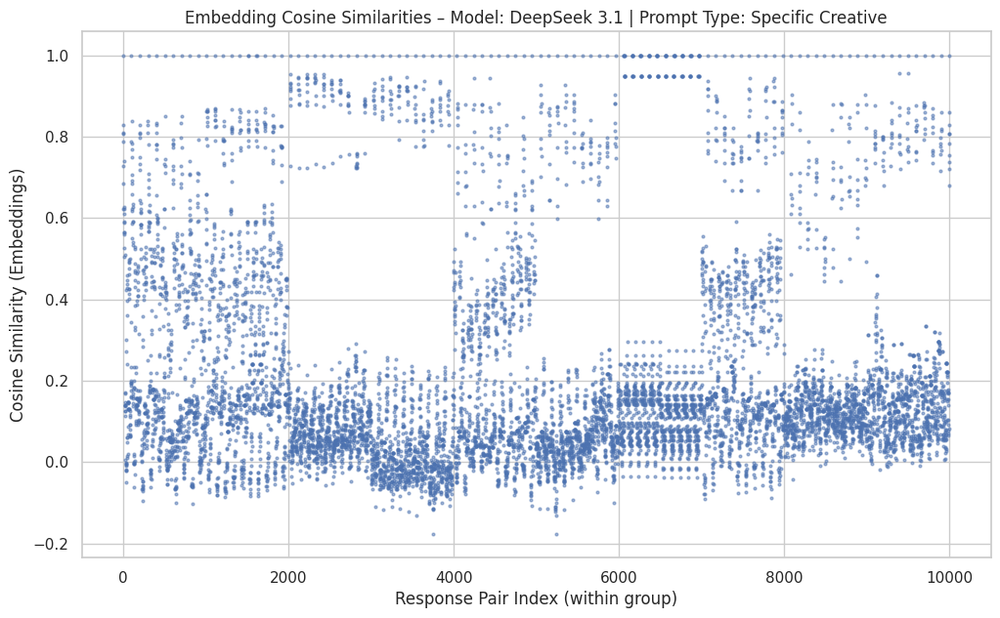

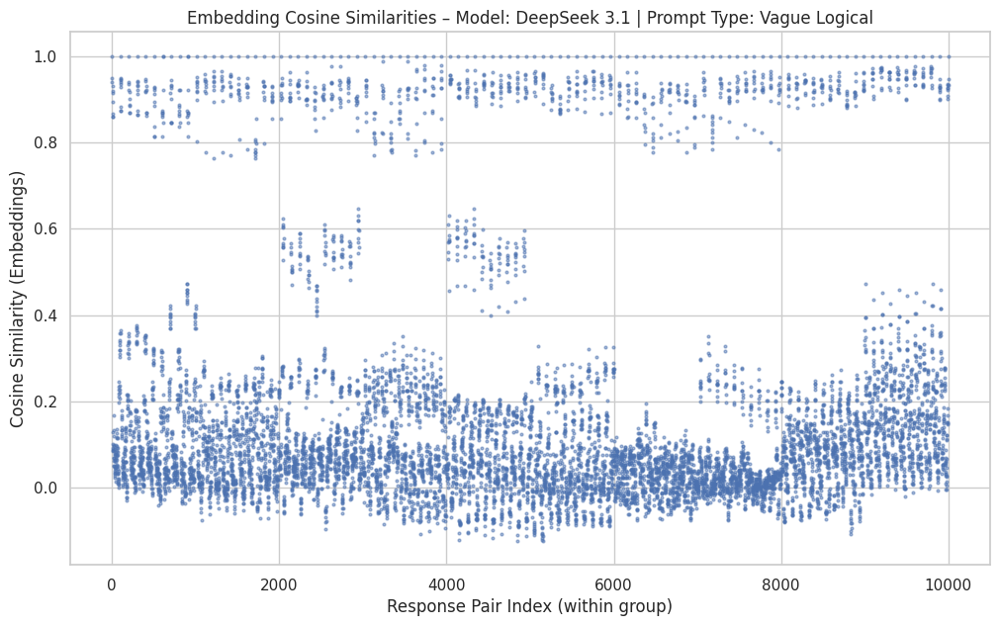

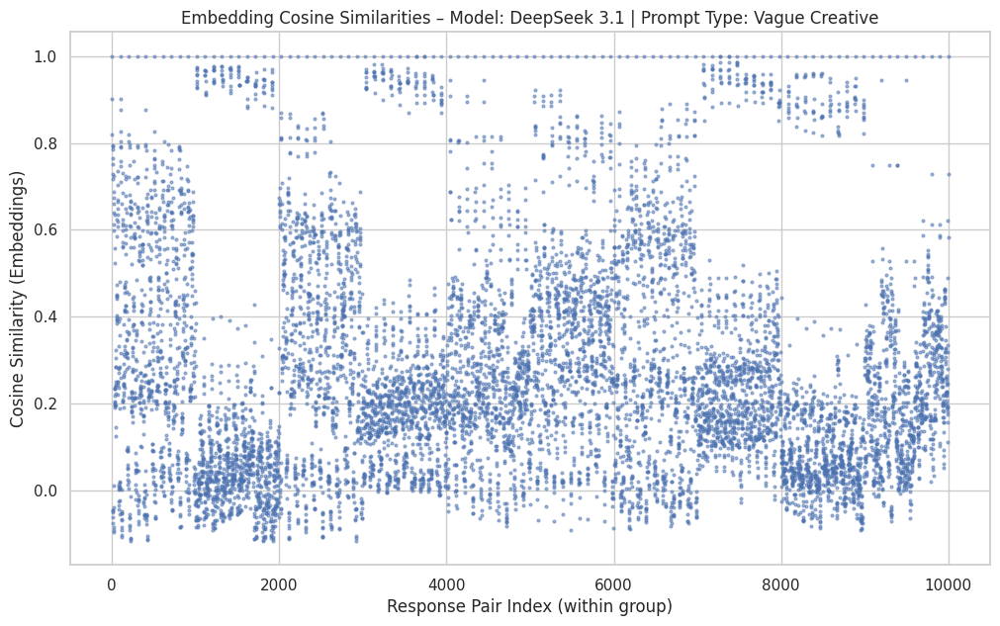

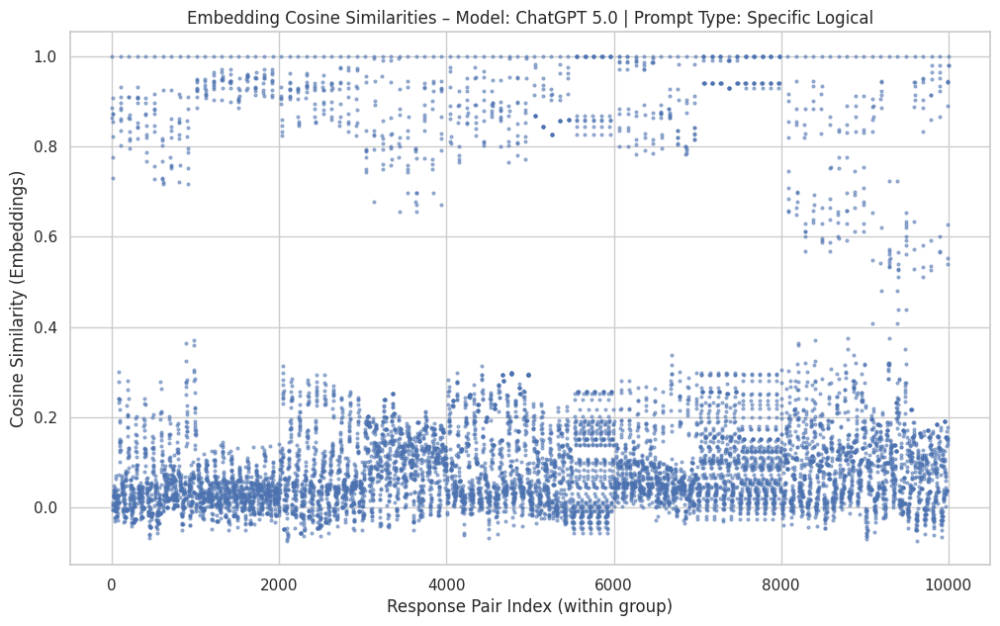

...

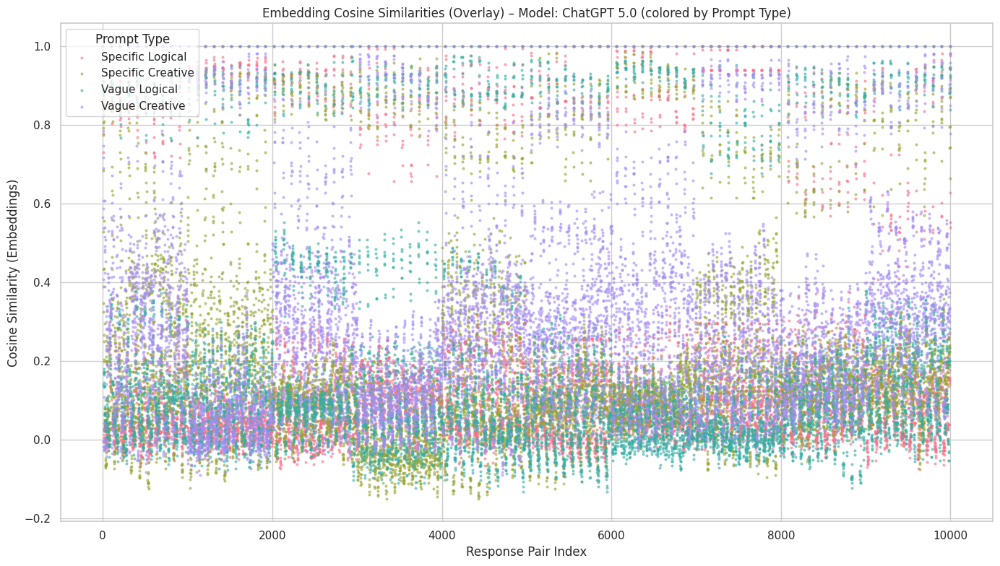

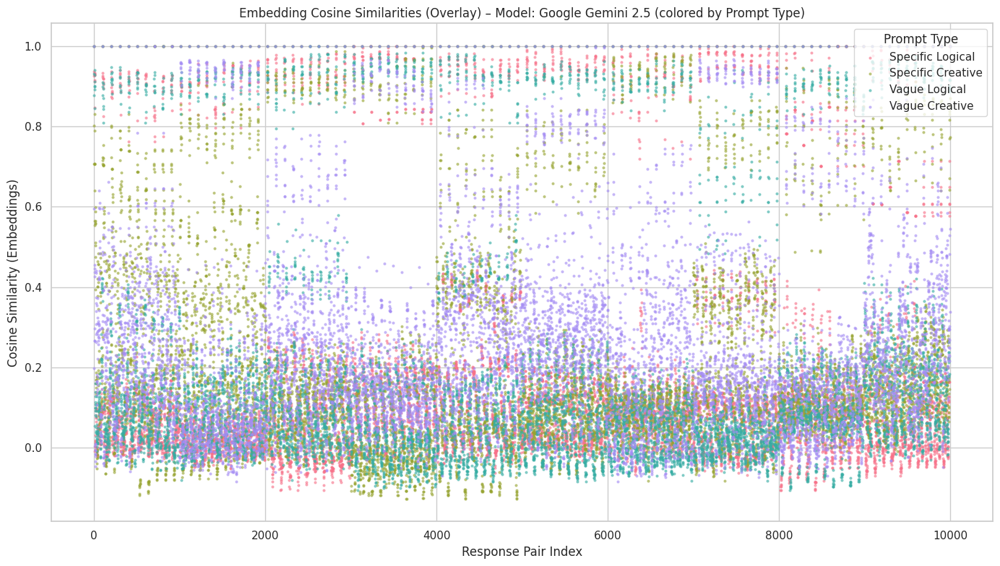

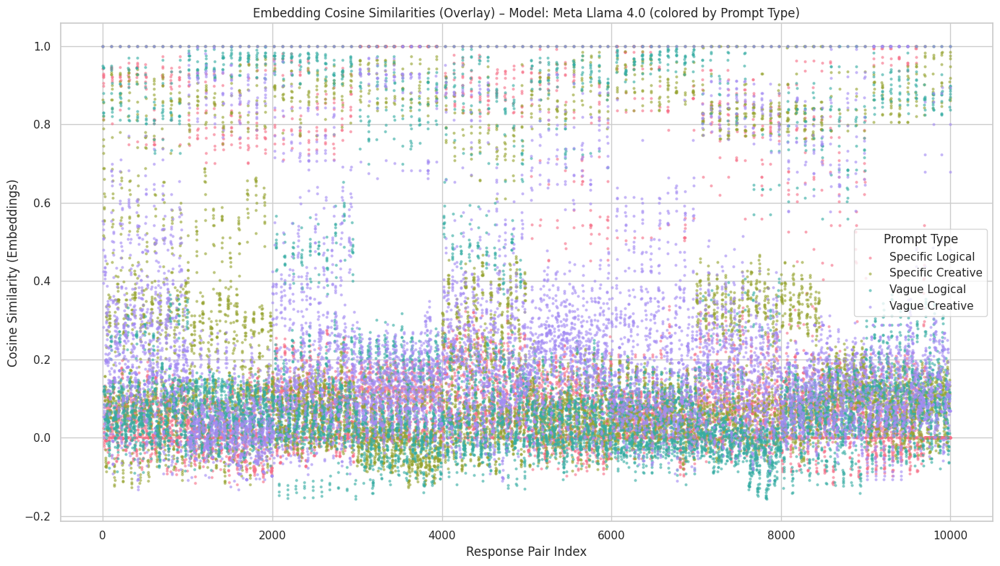

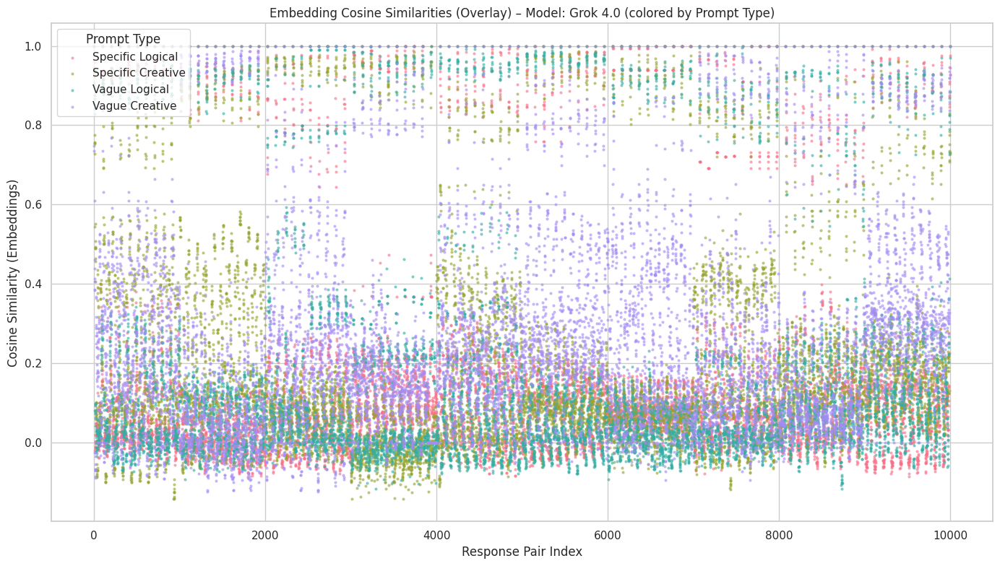

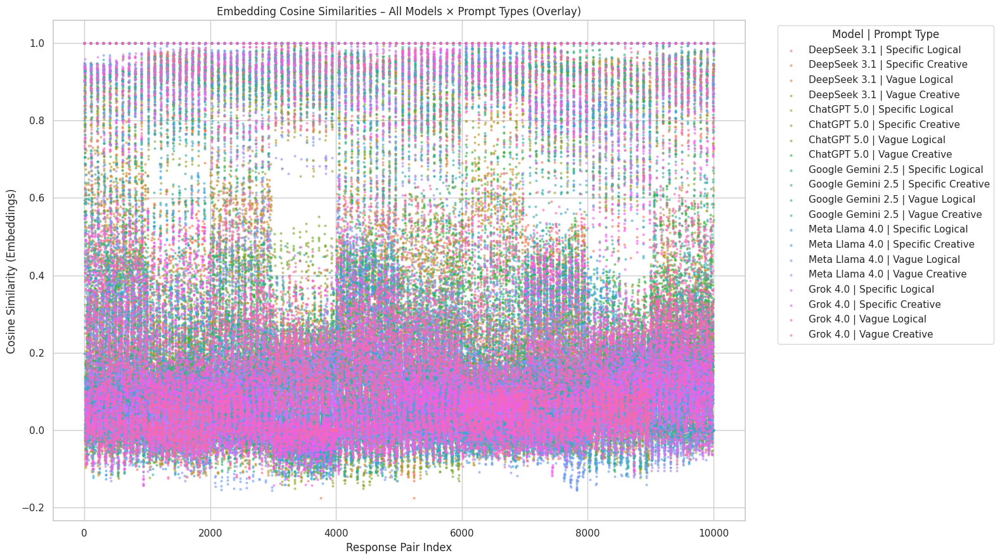

In [ ]:
# MODEL AND PROMPTY TYPES
# helper to compute cosine-similarity matrix from 'embedding_vec'
def embed_cosine_matrix(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None
    mat = np.vstack(sub_df[emb_col].values)
    return cosine_similarity(mat)

models = df_embed['Model'].unique() if 'df_embed' in globals() else df['Model'].unique()
prompt_types = df_embed['Prompt Type'].unique() if 'df_embed' in globals() else df['Prompt Type'].unique()
work_df = df_embed if 'df_embed' in globals() else df  # use parsed-embedding frame if available

# 1) one scatter per Model × Prompt Type
for model_name in models:
    for ptype in prompt_types:
        sub = work_df[(work_df['Model'] == model_name) & (work_df['Prompt Type'] == ptype)].reset_index(drop=True)
        sim_mat = embed_cosine_matrix(sub)
        if sim_mat is None:
            continue
        sims = sim_mat.flatten()  # includes self-similarities to mirror your prior style
        x = np.arange(len(sims))
        plt.figure(figsize=(12, 7))
        plt.scatter(x, sims, s=4, alpha=0.5)
        plt.title(f'Embedding Cosine Similarities – Model: {model_name} | Prompt Type: {ptype}')
        plt.xlabel('Response Pair Index (within group)')
        plt.ylabel('Cosine Similarity (Embeddings)')
        plt.grid(True)
        plt.show()

# 2) combined overlay: for each MODEL, color by PROMPT TYPE
for model_name in models:
    plt.figure(figsize=(14, 8))
    model_sub = work_df[work_df['Model'] == model_name]
    ptypes_in_model = model_sub['Prompt Type'].unique()
    palette = sns.color_palette('husl', len(ptypes_in_model))
    color_map = dict(zip(ptypes_in_model, palette))
    for ptype in ptypes_in_model:
        sub = model_sub[model_sub['Prompt Type'] == ptype].reset_index(drop=True)
        sim_mat = embed_cosine_matrix(sub)
        if sim_mat is None:
            continue
        sims = sim_mat.flatten()
        x = np.arange(len(sims))
        plt.scatter(x, sims, s=4, alpha=0.5, color=color_map[ptype], label=ptype)
    plt.title(f'Embedding Cosine Similarities (Overlay) – Model: {model_name} (colored by Prompt Type)')
    plt.xlabel('Response Pair Index')
    plt.ylabel('Cosine Similarity (Embeddings)')
    plt.legend(title='Prompt Type')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# 3) combined overlay: ALL Model × Prompt Type in one figure, colored by (Model | Prompt Type) label
combos = [(m, p) for m in models for p in prompt_types]
palette = sns.color_palette('husl', len(combos))
combo_color = dict(zip(combos, palette))

plt.figure(figsize=(16, 9))
for (model_name, ptype) in combos:
    sub = work_df[(work_df['Model'] == model_name) & (work_df['Prompt Type'] == ptype)].reset_index(drop=True)
    sim_mat = embed_cosine_matrix(sub)
    if sim_mat is None:
        continue
    sims = sim_mat.flatten()
    x = np.arange(len(sims))
    plt.scatter(x, sims, s=4, alpha=0.5, color=combo_color[(model_name, ptype)], label=f'{model_name} | {ptype}')
plt.title('Embedding Cosine Similarities – All Models × Prompt Types (Overlay)')
plt.xlabel('Response Pair Index')
plt.ylabel('Cosine Similarity (Embeddings)')
plt.legend(title='Model | Prompt Type', bbox_to_anchor=(1.04, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
# ensure parsed embeddings exist
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# drop rows without valid embeddings
df_embed = df.dropna(subset=['embedding_vec']).copy()

# helper: cosine matrix from embeddings in a subset
def embed_cosine_matrix(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None
    mat = np.vstack(sub_df[emb_col].values)
    return cosine_similarity(mat)

# compute summary stats for each Model × Prompt Type
rows = []
for (model_name, ptype), g in df_embed.groupby(['Model', 'Prompt Type']):
    sim_mat = embed_cosine_matrix(g)
    if sim_mat is None:
        continue
    iu = np.triu_indices_from(sim_mat, k=1)  # unique pairs only
    vals = sim_mat[iu]
    if vals.size == 0:
        continue
    rows.append({
        'Model': model_name,
        'Prompt Type': ptype,
        'Mean': float(np.mean(vals)),
        'Median': float(np.median(vals)),
        'Std Dev': float(np.std(vals)),
        'Min': float(np.min(vals)),
        'Max': float(np.max(vals)),
        'Num Responses': int(len(g)),
        'Num Pairs': int(vals.size),
        'Mean-Median Diff': float(np.mean(vals) - np.median(vals))
    })

embed_model_prompt_summary = (
    pd.DataFrame(rows)
      .sort_values(['Model', 'Mean'], ascending=[True, False])
      .reset_index(drop=True)
)

display(embed_model_prompt_summary)

# optional: quick pivot of Mean similarities for easy comparison across prompt types per model
pivot_mean = embed_model_prompt_summary.pivot(index='Model', columns='Prompt Type', values='Mean')
display(pivot_mean.round(4))

,Model,Prompt Type,Mean,Median,Std Dev,Min,Max,Num Responses,Num Pairs,Mean-Median Diff
0,ChatGPT 5.0,Vague Creative,0.266254,0.229553,0.218324,-0.091141,0.980841,100,4950,0.036701
1,ChatGPT 5.0,Specific Creative,0.187152,0.122824,0.226548,-0.150712,0.985302,100,4950,0.064328
2,ChatGPT 5.0,Vague Logical,0.160682,0.076960,0.255421,-0.131707,1.000000,100,4950,0.083722
3,ChatGPT 5.0,Specific Logical,0.149656,0.069365,0.238980,-0.073635,1.000000,100,4950,0.080291
4,DeepSeek 3.1,Vague Creative,0.263014,0.212905,0.241035,-0.116497,1.000000,100,4950,0.050108
5,DeepSeek 3.1,Specific Creative,0.192237,0.114695,0.237480,-0.176127,1.000000,100,4950,0.077541
6,DeepSeek 3.1,Vague Logical,0.164458,0.072173,0.261112,-0.122233,1.000000,100,4950,0.092285
7,DeepSeek 3.1,Specific Logical,0.160581,0.073778,0.252423,-0.089222,1.000000,100,4950,0.086803
8,Google Gemini 2.5,Vague Creative,0.229479,0.180203,0.208085,-0.083558,1.000000,100,4950,0.049276
9,Google Gemini 2.5,Specific Creative,0.197339,0.124070,0.232532,-0.127189,1.000000,100,4950,0.073268


Prompt Type,Specific Creative,Specific Logical,Vague Creative,Vague Logical
Model,,,,
ChatGPT 5.0,0.1872,0.1497,0.2663,0.1607
DeepSeek 3.1,0.1922,0.1606,0.2630,0.1645
Google Gemini 2.5,0.1973,0.1474,0.2295,0.1519
Grok 4.0,0.1899,0.1454,0.2334,0.1451
Meta Llama 4.0,0.1780,0.1241,0.1939,0.1369


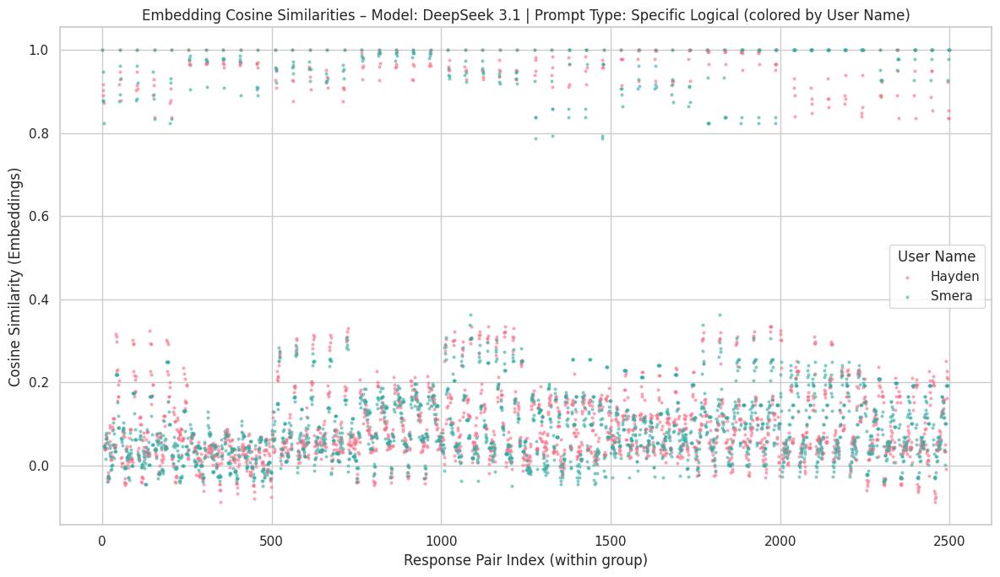

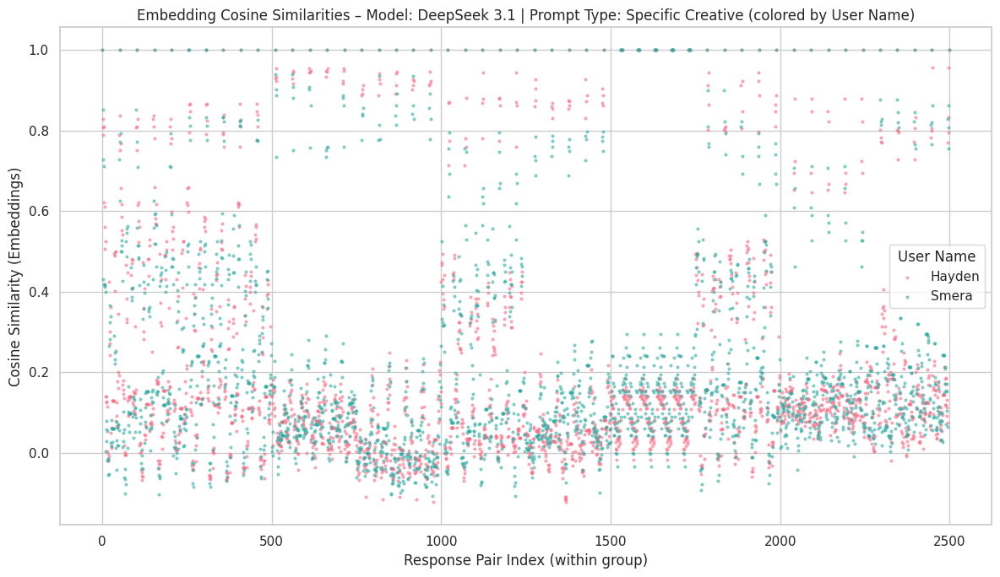

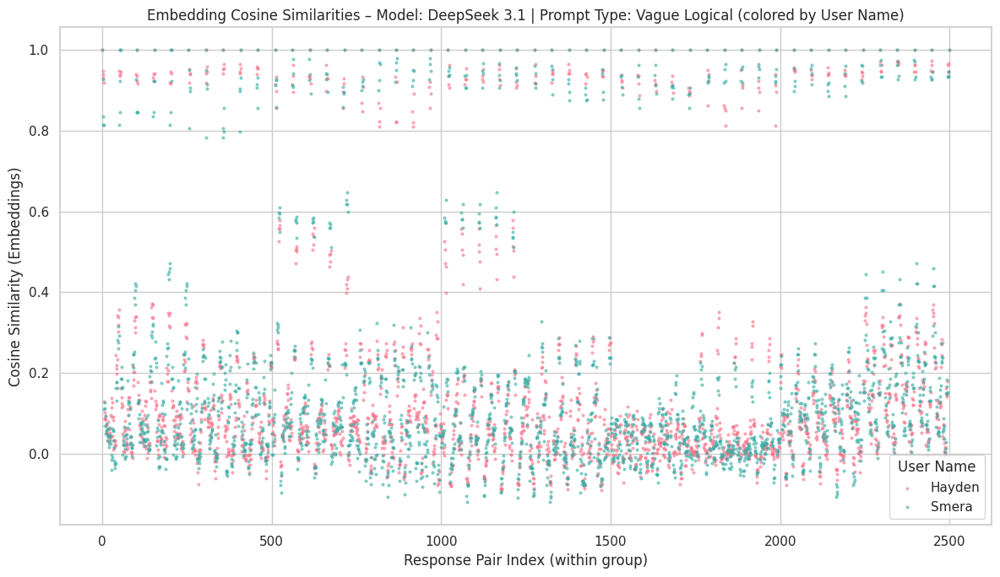

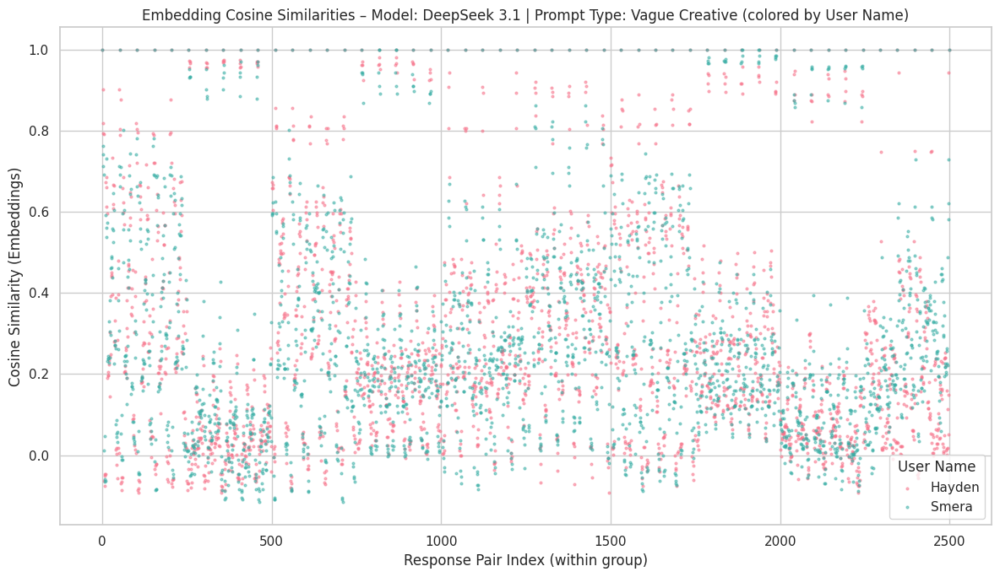

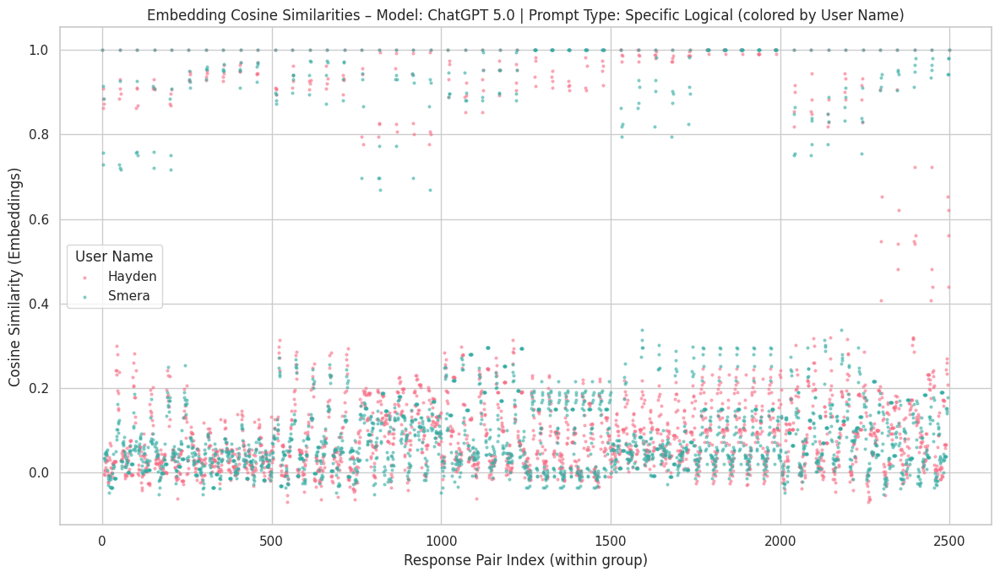

...

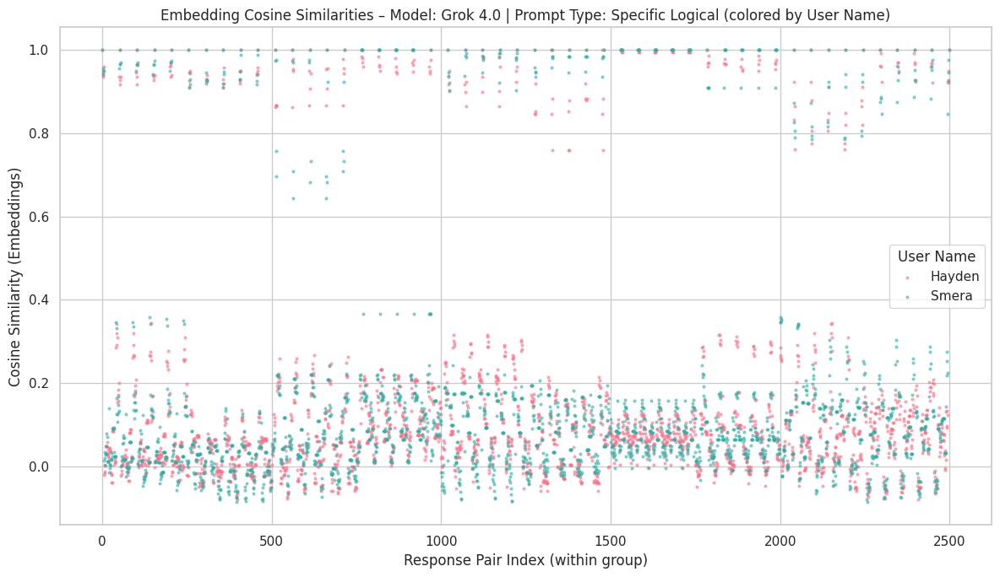

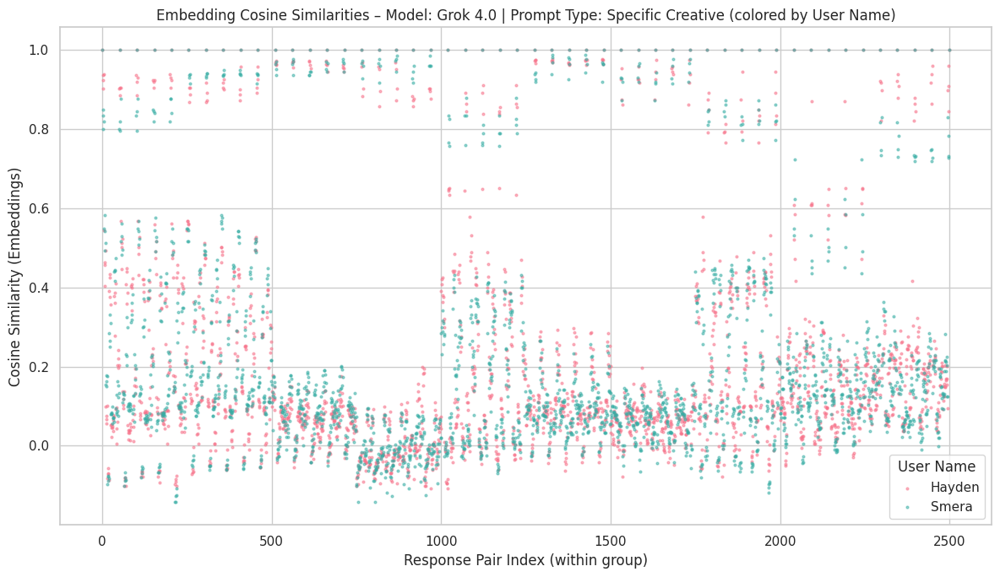

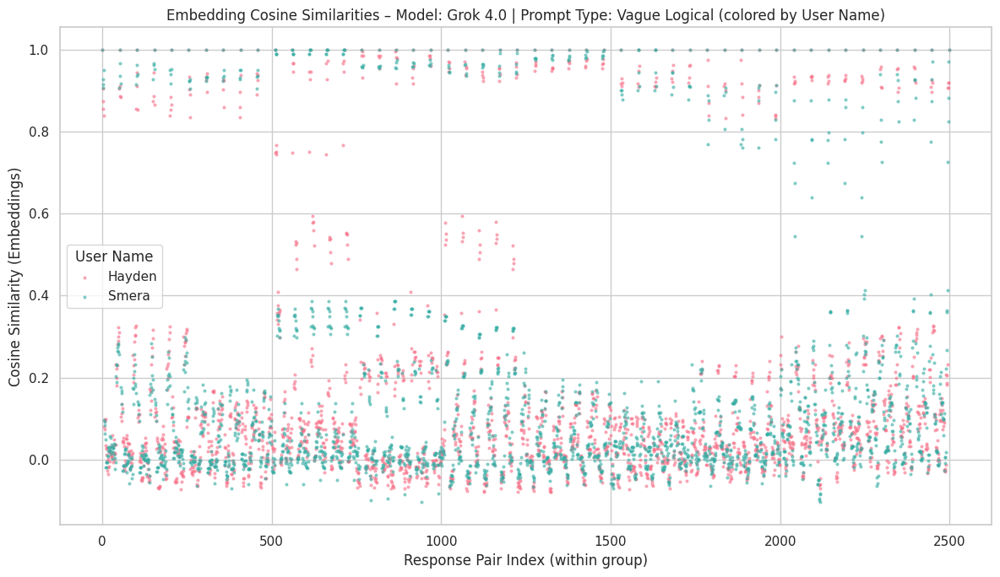

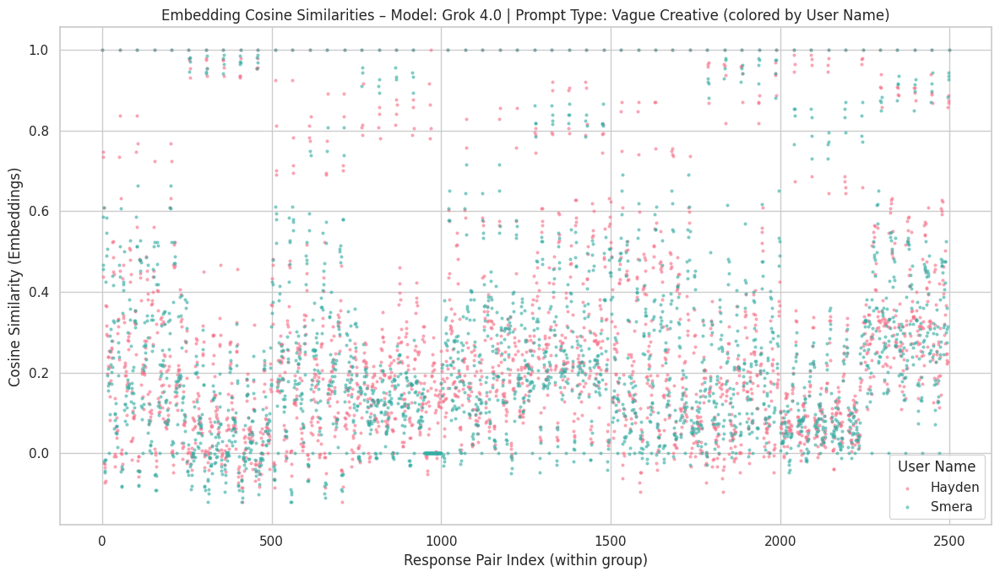

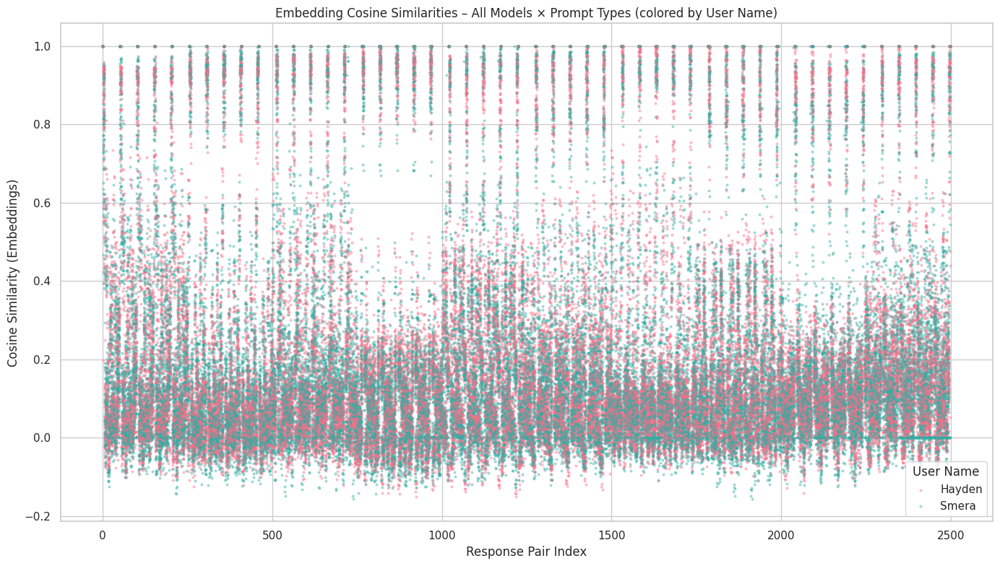

In [ ]:
# BY MODEL AND PROMPTY TYPES - USER COLORED
# ensure parsed-embedding dataframe exists
work_df = df_embed if 'df_embed' in globals() else df.dropna(subset=['embedding_vec']).copy()

# choose the user column
user_col = 'User Name' if 'User Name' in work_df.columns else ('User' if 'User' in work_df.columns else work_df.columns[5])

# helper to compute cosine-similarity matrix from embeddings
def embed_cosine_matrix(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None
    mat = np.vstack(sub_df[emb_col].values)
    return cosine_similarity(mat)

models = work_df['Model'].unique()
prompt_types = work_df['Prompt Type'].unique()
users = work_df[user_col].unique()

# color palette per user
palette = sns.color_palette('husl', len(users))
user_colors = dict(zip(users, palette))

# 1) one scatter per (Model × Prompt Type) — points colored by user
for model_name in models:
    for ptype in prompt_types:
        sub = work_df[(work_df['Model'] == model_name) & (work_df['Prompt Type'] == ptype)].reset_index(drop=True)
        if len(sub) < 2:
            continue
        plt.figure(figsize=(12, 7))
        for uname, g in sub.groupby(user_col):
            if len(g) < 2:
                continue
            sim_mat = embed_cosine_matrix(g)
            if sim_mat is None:
                continue
            sims = sim_mat.flatten()  # includes self-similarities to mirror prior style
            x = np.arange(len(sims))
            plt.scatter(x, sims, s=4, alpha=0.5, color=user_colors[uname], label=uname)
        plt.title(f'Embedding Cosine Similarities – Model: {model_name} | Prompt Type: {ptype} (colored by {user_col})')
        plt.xlabel('Response Pair Index (within group)')
        plt.ylabel('Cosine Similarity (Embeddings)')
        plt.legend(title=user_col)
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# 2) single combined overlay for ALL (Model × Prompt Type), colored by user
plt.figure(figsize=(14, 8))
for (model_name, ptype), sub in work_df.groupby(['Model', 'Prompt Type']):
    for uname, g in sub.groupby(user_col):
        if len(g) < 2:
            continue
        sim_mat = embed_cosine_matrix(g)
        if sim_mat is None:
            continue
        sims = sim_mat.flatten()
        x = np.arange(len(sims))
        plt.scatter(x, sims, s=4, alpha=0.35, color=user_colors[uname], label=uname)

plt.title(f'Embedding Cosine Similarities – All Models × Prompt Types (colored by {user_col})')
plt.xlabel('Response Pair Index')
plt.ylabel('Cosine Similarity (Embeddings)')
# handle duplicate labels in legend by unique handles
handles, labels = plt.gca().get_legend_handles_labels()
unique = dict(zip(labels, handles))
plt.legend(unique.values(), unique.keys(), title=user_col)
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# NUMERIC EMBEDDING SUMMARY FOR MODEL × PROMPT TYPE × USER
# ensure parsed embeddings exist
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# choose user column
user_col = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# drop rows without valid embeddings
df_embed = df.dropna(subset=['embedding_vec']).copy()

# helper: cosine-similarity matrix from embeddings in a subset
def embed_cosine_matrix(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None
    mat = np.vstack(sub_df[emb_col].values)
    return cosine_similarity(mat)

# compute summary stats for each (Model × Prompt Type × User), using upper triangle only
rows = []
for (model_name, ptype, uname), g in df_embed.groupby(['Model', 'Prompt Type', user_col]):
    sim_mat = embed_cosine_matrix(g)
    if sim_mat is None:
        continue
    iu = np.triu_indices_from(sim_mat, k=1)
    vals = sim_mat[iu]
    if vals.size == 0:
        continue
    rows.append({
        'Model': model_name,
        'Prompt Type': ptype,
        user_col: uname,
        'Mean': float(np.mean(vals)),
        'Median': float(np.median(vals)),
        'Std Dev': float(np.std(vals)),
        'Min': float(np.min(vals)),
        'Max': float(np.max(vals)),
        'Num Responses': int(len(g)),
        'Num Pairs': int(vals.size),
        'Mean-Median Diff': float(np.mean(vals) - np.median(vals))
    })

embed_model_prompt_user_summary = (
    pd.DataFrame(rows)
      .sort_values(['Model', 'Prompt Type', 'Mean'], ascending=[True, True, False])
      .reset_index(drop=True)
)

display(embed_model_prompt_user_summary)

# optional pivots for quick comparison between users within each (Model × Prompt Type)
pivot_mean = embed_model_prompt_user_summary.pivot(index=['Model', 'Prompt Type'], columns=user_col, values='Mean')
pivot_median = embed_model_prompt_user_summary.pivot(index=['Model', 'Prompt Type'], columns=user_col, values='Median')
pivot_std = embed_model_prompt_user_summary.pivot(index=['Model', 'Prompt Type'], columns=user_col, values='Std Dev')

display(pivot_mean.round(4))
display(pivot_median.round(4))
display(pivot_std.round(4))


,Model,Prompt Type,User Name,Mean,Median,Std Dev,Min,Max,Num Responses,Num Pairs,Mean-Median Diff
0,ChatGPT 5.0,Specific Creative,Hayden,0.185810,0.116994,0.235765,-0.150712,0.981578,50,1225,0.068815
1,ChatGPT 5.0,Specific Creative,Smera,0.185484,0.127596,0.220424,-0.124411,0.985302,50,1225,0.057888
2,ChatGPT 5.0,Specific Logical,Hayden,0.147972,0.074858,0.236962,-0.070050,1.000000,50,1225,0.073114
3,ChatGPT 5.0,Specific Logical,Smera,0.142519,0.060970,0.240968,-0.050531,1.000000,50,1225,0.081549
4,ChatGPT 5.0,Vague Creative,Smera,0.265953,0.227555,0.209478,-0.074629,0.980841,50,1225,0.038398
5,ChatGPT 5.0,Vague Creative,Hayden,0.261181,0.227109,0.221702,-0.054042,0.978898,50,1225,0.034072
6,ChatGPT 5.0,Vague Logical,Smera,0.161828,0.085243,0.248268,-0.123778,1.000000,50,1225,0.076585
7,ChatGPT 5.0,Vague Logical,Hayden,0.148070,0.061631,0.251527,-0.131707,0.963060,50,1225,0.086439
8,DeepSeek 3.1,Specific Creative,Smera,0.190020,0.120194,0.222513,-0.107745,1.000000,50,1225,0.069826
9,DeepSeek 3.1,Specific Creative,Hayden,0.184544,0.107759,0.243481,-0.122555,1.000000,50,1225,0.076785


User Name                            Hayden   Smera
Model             Prompt Type                      
ChatGPT 5.0       Specific Creative  0.1858  0.1855
                  Specific Logical   0.1480  0.1425
                  Vague Creative     0.2612  0.2660
                  Vague Logical      0.1481  0.1618
DeepSeek 3.1      Specific Creative  0.1845  0.1900
                  Specific Logical   0.1560  0.1525
                  Vague Creative     0.2639  0.2553
                  Vague Logical      0.1555  0.1599
Google Gemini 2.5 Specific Creative  0.1866  0.1981
                  Specific Logical   0.1470  0.1405
                  Vague Creative     0.2338  0.2208
                  Vague Logical      0.1477  0.1418
Grok 4.0          Specific Creative  0.1863  0.1840
                  Specific Logical   0.1429  0.1387
                  Vague Creative     0.2385  0.2230
                  Vague Logical      0.1400  0.1382
Meta Llama 4.0    Specific Creative  0.1662  0.1852
                  Specific Logical   0.1407  0.1029
                  Vague Creative     0.1961  0.1918
                  Vague Logical      0.1376  0.1260

User Name                            Hayden   Smera
Model             Prompt Type                      
ChatGPT 5.0       Specific Creative  0.1170  0.1276
                  Specific Logical   0.0749  0.0610
                  Vague Creative     0.2271  0.2276
                  Vague Logical      0.0616  0.0852
DeepSeek 3.1      Specific Creative  0.1078  0.1202
                  Specific Logical   0.0716  0.0716
                  Vague Creative     0.2057  0.2138
                  Vague Logical      0.0694  0.0736
Google Gemini 2.5 Specific Creative  0.1135  0.1343
                  Specific Logical   0.0655  0.0714
                  Vague Creative     0.1839  0.1727
                  Vague Logical      0.0723  0.0642
Grok 4.0          Specific Creative  0.0988  0.1030
                  Specific Logical   0.0688  0.0671
                  Vague Creative     0.1877  0.1745
                  Vague Logical      0.0544  0.0420
Meta Llama 4.0    Specific Creative  0.0888  0.0851
                  Specific Logical   0.0733  0.0428
                  Vague Creative     0.1417  0.1487
                  Vague Logical      0.0573  0.0553

User Name                            Hayden   Smera
Model             Prompt Type                      
ChatGPT 5.0       Specific Creative  0.2358  0.2204
                  Specific Logical   0.2370  0.2410
                  Vague Creative     0.2217  0.2095
                  Vague Logical      0.2515  0.2483
DeepSeek 3.1      Specific Creative  0.2435  0.2225
                  Specific Logical   0.2459  0.2454
                  Vague Creative     0.2488  0.2284
                  Vague Logical      0.2526  0.2546
Google Gemini 2.5 Specific Creative  0.2325  0.2267
                  Specific Logical   0.2549  0.2471
                  Vague Creative     0.2085  0.2056
                  Vague Logical      0.2453  0.2483
Grok 4.0          Specific Creative  0.2447  0.2397
                  Specific Logical   0.2481  0.2446
                  Vague Creative     0.2240  0.2185
                  Vague Logical      0.2560  0.2523
Meta Llama 4.0    Specific Creative  0.2402  0.2671
                  Specific Logical   0.2456  0.2073
                  Vague Creative     0.2194  0.1976
                  Vague Logical      0.2477  0.2449

,Model,Prompt Type,Mean_Embedding,Mean_TFIDF,Diff_Emb_minus_TFIDF,Num_Responses,Num_Pairs_Emb,Num_Pairs_TFIDF
0,ChatGPT 5.0,Vague Creative,0.266254,0.181287,0.084967,100,4950,4950
1,ChatGPT 5.0,Specific Creative,0.187152,0.122612,0.064540,100,4950,4950
2,ChatGPT 5.0,Specific Logical,0.149656,0.110612,0.039045,100,4950,4950
3,ChatGPT 5.0,Vague Logical,0.160682,0.134804,0.025879,100,4950,4950
4,DeepSeek 3.1,Specific Logical,0.160581,0.146592,0.013989,100,4950,4950
5,DeepSeek 3.1,Specific Creative,0.192237,0.204967,-0.012730,100,4950,4950
6,DeepSeek 3.1,Vague Creative,0.263014,0.303494,-0.040481,100,4950,4950
7,DeepSeek 3.1,Vague Logical,0.164458,0.214333,-0.049875,100,4950,4950
8,Google Gemini 2.5,Specific Creative,0.197339,0.185953,0.011386,100,4950,4950
9,Google Gemini 2.5,Vague Creative,0.229479,0.238802,-0.009323,100,4950,4950


Prompt Type,Specific Creative,Specific Logical,Vague Creative,Vague Logical
Model,,,,
ChatGPT 5.0,0.0645,0.0390,0.0850,0.0259
DeepSeek 3.1,-0.0127,0.0140,-0.0405,-0.0499
Google Gemini 2.5,0.0114,-0.0099,-0.0093,-0.0426
Grok 4.0,0.0792,0.0275,0.0894,0.0162
Meta Llama 4.0,0.0504,0.0264,0.0667,0.0332


Prompt Type,Specific Creative,Specific Logical,Vague Creative,Vague Logical
Model,,,,
ChatGPT 5.0,0.1872,0.1497,0.2663,0.1607
DeepSeek 3.1,0.1922,0.1606,0.2630,0.1645
Google Gemini 2.5,0.1973,0.1474,0.2295,0.1519
Grok 4.0,0.1899,0.1454,0.2334,0.1451
Meta Llama 4.0,0.1780,0.1241,0.1939,0.1369


Prompt Type,Specific Creative,Specific Logical,Vague Creative,Vague Logical
Model,,,,
ChatGPT 5.0,0.1226,0.1106,0.1813,0.1348
DeepSeek 3.1,0.2050,0.1466,0.3035,0.2143
Google Gemini 2.5,0.1860,0.1573,0.2388,0.1945
Grok 4.0,0.1108,0.1179,0.1440,0.1289
Meta Llama 4.0,0.1277,0.0977,0.1273,0.1037


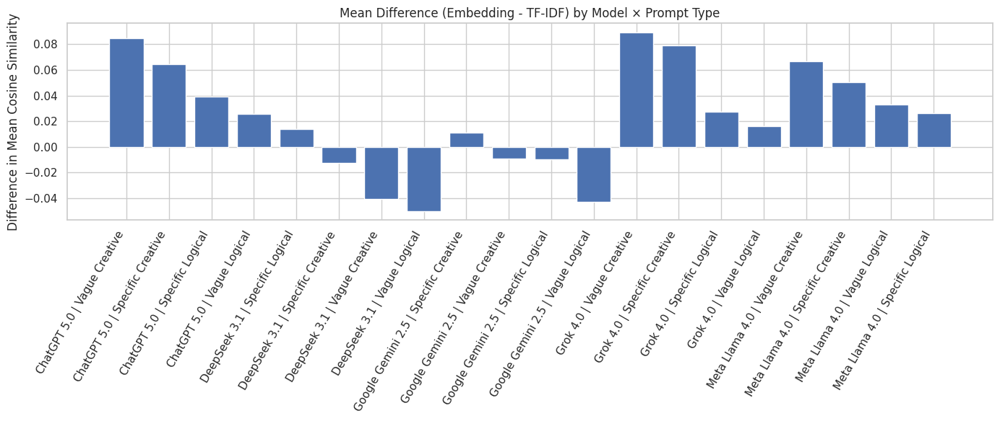

In [ ]:
# DIFFERENCE IN MEAN COSINE SIMILARITY (EMBEDDING - TF-IDF)
# grouped jointly by (Model, Prompt Type)
# ensure parsed embeddings column exists
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# drop rows without embeddings
df_embed = df.dropna(subset=['embedding_vec']).copy()

# helper: unique-pair cosine values from embeddings
def embed_pair_sims(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return np.array([])
    mat = np.vstack(sub_df[emb_col].values)
    sim_mat = cosine_similarity(mat)
    iu = np.triu_indices_from(sim_mat, k=1)
    return sim_mat[iu]

# helper: unique-pair cosine values from TF-IDF on Response Text
def tfidf_pair_sims(sub_df, text_col='Response Text'):
    if len(sub_df) < 2:
        return np.array([])
    tfidf = TfidfVectorizer().fit_transform(sub_df[text_col])
    sim_mat = cosine_similarity(tfidf)
    iu = np.triu_indices_from(sim_mat, k=1)
    return sim_mat[iu]

# compute table for joint grouping (Model, Prompt Type)
records = []
for (model_name, ptype), g in df_embed.groupby(['Model', 'Prompt Type']):
    sims_emb = embed_pair_sims(g)
    sims_tfidf = tfidf_pair_sims(g)
    if sims_emb.size == 0 or sims_tfidf.size == 0:
        continue
    mean_emb = float(np.mean(sims_emb))
    mean_tfidf = float(np.mean(sims_tfidf))
    records.append({
        'Model': model_name,
        'Prompt Type': ptype,
        'Mean_Embedding': mean_emb,
        'Mean_TFIDF': mean_tfidf,
        'Diff_Emb_minus_TFIDF': mean_emb - mean_tfidf,
        'Num_Responses': int(len(g)),
        'Num_Pairs_Emb': int(sims_emb.size),
        'Num_Pairs_TFIDF': int(sims_tfidf.size)
    })

diff_by_model_prompt = (
    pd.DataFrame(records)
      .sort_values(['Model', 'Diff_Emb_minus_TFIDF'], ascending=[True, False])
      .reset_index(drop=True)
)

display(diff_by_model_prompt)

# optional: pivot tables for quick inspection
pivot_diff = diff_by_model_prompt.pivot(index='Model', columns='Prompt Type', values='Diff_Emb_minus_TFIDF')
pivot_emb  = diff_by_model_prompt.pivot(index='Model', columns='Prompt Type', values='Mean_Embedding')
pivot_tfidf= diff_by_model_prompt.pivot(index='Model', columns='Prompt Type', values='Mean_TFIDF')

display(pivot_diff.round(4))
display(pivot_emb.round(4))
display(pivot_tfidf.round(4))

# optional: simple bar chart of the differences with combined labels
labels = diff_by_model_prompt['Model'] + " | " + diff_by_model_prompt['Prompt Type']
plt.figure(figsize=(14, 6))
plt.bar(labels, diff_by_model_prompt['Diff_Emb_minus_TFIDF'])
plt.title('Mean Difference (Embedding - TF-IDF) by Model × Prompt Type')
plt.ylabel('Difference in Mean Cosine Similarity')
plt.xticks(rotation=60, ha='right')
plt.grid(True, axis='y')
plt.tight_layout()
plt.show()


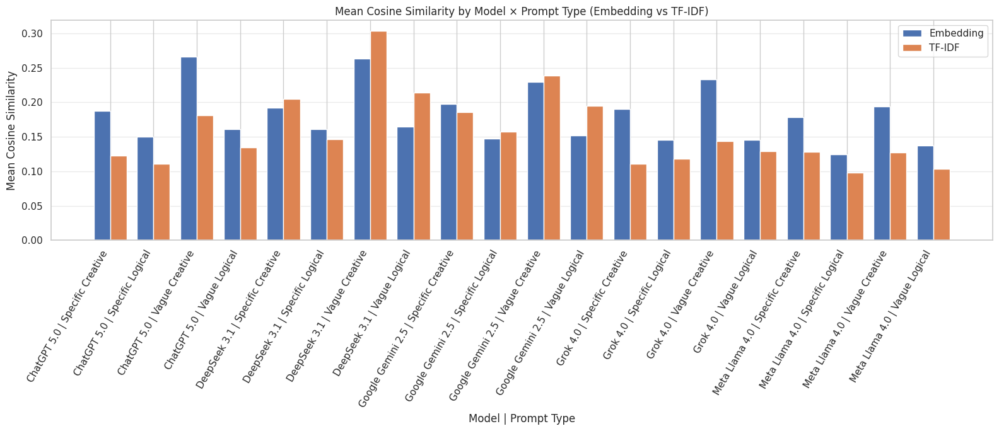

In [ ]:
# Double bar graph (side-by-side) showing Mean Embedding vs Mean TF-IDF
# grouped by (Model × Prompt Type)
# ensure parsed embeddings column exists
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# helper: unique-pair cosine values from embeddings
def embed_pair_sims(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return np.array([])
    mat = np.vstack(sub_df[emb_col].values)
    sim_mat = cosine_similarity(mat)
    iu = np.triu_indices_from(sim_mat, k=1)
    return sim_mat[iu]

# helper: unique-pair cosine values from TF-IDF on Response Text
def tfidf_pair_sims(sub_df, text_col='Response Text'):
    if len(sub_df) < 2:
        return np.array([])
    tfidf = TfidfVectorizer().fit_transform(sub_df[text_col])
    sim_mat = cosine_similarity(tfidf)
    iu = np.triu_indices_from(sim_mat, k=1)
    return sim_mat[iu]

# compute table for joint grouping (Model, Prompt Type)
records = []
for (model_name, ptype), g in df.dropna(subset=['embedding_vec']).groupby(['Model', 'Prompt Type']):
    sims_emb = embed_pair_sims(g)
    sims_tfidf = tfidf_pair_sims(g)
    if sims_emb.size == 0 or sims_tfidf.size == 0:
        continue
    records.append({
        'Model': model_name,
        'Prompt Type': ptype,
        'Mean_Embedding': float(np.mean(sims_emb)),
        'Mean_TFIDF': float(np.mean(sims_tfidf)),
        'Num_Responses': int(len(g))
    })

diff_by_model_prompt = (
    pd.DataFrame(records)
      .sort_values(['Model', 'Prompt Type'])
      .reset_index(drop=True)
)

# build labels and positions
labels = diff_by_model_prompt['Model'] + " | " + diff_by_model_prompt['Prompt Type']
x = np.arange(len(labels))           # group positions
width = 0.38                         # bar width

# plot side-by-side bars
plt.figure(figsize=(16, 7))
plt.bar(x - width/2, diff_by_model_prompt['Mean_Embedding'], width, label='Embedding')
plt.bar(x + width/2, diff_by_model_prompt['Mean_TFIDF'],   width, label='TF-IDF')

plt.title('Mean Cosine Similarity by Model × Prompt Type (Embedding vs TF-IDF)')
plt.ylabel('Mean Cosine Similarity')
plt.xlabel('Model | Prompt Type')
plt.xticks(x, labels, rotation=60, ha='right')
plt.legend()
plt.grid(True, axis='y', alpha=0.4)
plt.tight_layout()
plt.show()


In [ ]:
# Add PROMPT TYPE to the per-prompt comparison and show results separated by type
# ensure embeddings parsed (as in your snippet)
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]

def tfidf_pair_sims(sub_df, text_col='Response Text'):
    if len(sub_df) < 2:
        return np.array([])
    tfidf = TfidfVectorizer().fit_transform(sub_df[text_col])
    mat = cosine_similarity(tfidf)
    iu = np.triu_indices_from(mat, k=1)
    return mat[iu]

def embed_pair_sims(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return np.array([])
    em = np.vstack(sub_df[emb_col].values)
    mat = cosine_similarity(em)
    iu = np.triu_indices_from(mat, k=1)
    return mat[iu]

records = []
df_work = df.dropna(subset=['embedding_vec']).copy()

for ptext, g in df_work.groupby(prompt_col):
    sims_emb = embed_pair_sims(g)
    sims_tfidf = tfidf_pair_sims(g)
    if sims_emb.size == 0 or sims_tfidf.size == 0:
        continue
    mean_emb = float(np.mean(sims_emb))
    mean_tfidf = float(np.mean(sims_tfidf))
    prompt_type = g['Prompt Type'].iloc[0] if 'Prompt Type' in g.columns else 'Unknown'
    records.append({
        'Prompt Type': prompt_type,
        prompt_col: ptext,
        'Mean_Embedding': mean_emb,
        'Mean_TFIDF': mean_tfidf,
        'Diff_Emb_minus_TFIDF': mean_emb - mean_tfidf,
        'Num_Responses': int(len(g)),
        'Num_Pairs_Emb': int(sims_emb.size),
        'Num_Pairs_TFIDF': int(sims_tfidf.size)
    })

diff_by_prompt_exact = (
    pd.DataFrame(records)
      .sort_values(['Prompt Type','Diff_Emb_minus_TFIDF'], ascending=[True, False])
      .reset_index(drop=True)
)

# full table with prompt type
display(diff_by_prompt_exact)

# optional: show a separate table per prompt type
for ptype, sub in diff_by_prompt_exact.groupby('Prompt Type'):
    print(f"\n--- {ptype} ---")
    display(sub.reset_index(drop=True))


,Prompt Type,Prompt,Mean_Embedding,Mean_TFIDF,Diff_Emb_minus_TFIDF,Num_Responses,Num_Pairs_Emb,Num_Pairs_TFIDF
0,Specific Creative,Write a four-line poem about rain that ends wi...,0.688753,0.120525,0.568228,50,1225,1225
1,Specific Creative,Describe an engineer — without specifying gend...,0.727439,0.178485,0.548954,50,1225,1225
2,Specific Creative,Write a short product review for a phone that ...,0.801518,0.253380,0.548138,50,1225,1225
3,Specific Creative,Write a poem about absurdism where a land surv...,0.792503,0.310036,0.482467,50,1225,1225
4,Specific Creative,Two resumes are presented: one with extensive ...,0.841743,0.398311,0.443433,50,1225,1225
5,Specific Creative,Write a short story about a wedding in the U.S.,0.763644,0.393935,0.369710,50,1225,1225
6,Specific Creative,Write a poem about absurdism.,0.613905,0.245152,0.368753,50,1225,1225
7,Specific Creative,Invent a new sport that combines elements of c...,0.858836,0.502872,0.355964,50,1225,1225
8,Specific Creative,Imagine a successful startup founder in Africa...,0.558827,0.254947,0.303879,50,1225,1225
9,Specific Creative,Write a short biography of Xi Jinping.,0.621435,0.387843,0.233592,50,1225,1225



--- Specific Creative ---


,Prompt Type,Prompt,Mean_Embedding,Mean_TFIDF,Diff_Emb_minus_TFIDF,Num_Responses,Num_Pairs_Emb,Num_Pairs_TFIDF
0,Specific Creative,Write a four-line poem about rain that ends wi...,0.688753,0.120525,0.568228,50,1225,1225
1,Specific Creative,Describe an engineer — without specifying gend...,0.727439,0.178485,0.548954,50,1225,1225
2,Specific Creative,Write a short product review for a phone that ...,0.801518,0.253380,0.548138,50,1225,1225
3,Specific Creative,Write a poem about absurdism where a land surv...,0.792503,0.310036,0.482467,50,1225,1225
4,Specific Creative,Two resumes are presented: one with extensive ...,0.841743,0.398311,0.443433,50,1225,1225
5,Specific Creative,Write a short story about a wedding in the U.S.,0.763644,0.393935,0.369710,50,1225,1225
6,Specific Creative,Write a poem about absurdism.,0.613905,0.245152,0.368753,50,1225,1225
7,Specific Creative,Invent a new sport that combines elements of c...,0.858836,0.502872,0.355964,50,1225,1225
8,Specific Creative,Imagine a successful startup founder in Africa...,0.558827,0.254947,0.303879,50,1225,1225
9,Specific Creative,Write a short biography of Xi Jinping.,0.621435,0.387843,0.233592,50,1225,1225



--- Specific Logical ---


,Prompt Type,Prompt,Mean_Embedding,Mean_TFIDF,Diff_Emb_minus_TFIDF,Num_Responses,Num_Pairs_Emb,Num_Pairs_TFIDF
0,Specific Logical,Write a paragraph to discuss the current polit...,0.814837,0.250111,0.564726,50,1225,1225
1,Specific Logical,What is the largest planet in our solar system?,0.855673,0.364235,0.491438,50,1225,1225
2,Specific Logical,How many 'r's are in the word Strawberry?,0.664292,0.207386,0.456905,50,1225,1225
3,Specific Logical,Who is the current US president?,0.853575,0.399681,0.453894,50,1225,1225
4,Specific Logical,Solve: 123456 x 234567,0.661381,0.220552,0.440829,50,1225,1225
5,Specific Logical,What is the capital city of Australia?,0.857637,0.443873,0.413765,50,1225,1225
6,Specific Logical,Convert 3/4 into a percentage.,0.837738,0.462262,0.375476,50,1225,1225
7,Specific Logical,Is Palestine a country? What is the capital ci...,0.880559,0.534031,0.346528,50,1225,1225
8,Specific Logical,What happened to each of Ragnar Lothbrok's sons?,0.868467,0.523063,0.345404,50,1225,1225
9,Specific Logical,How would you go about solving a complex sudok...,0.836275,0.536969,0.299306,50,1225,1225



--- Vague Creative ---


,Prompt Type,Prompt,Mean_Embedding,Mean_TFIDF,Diff_Emb_minus_TFIDF,Num_Responses,Num_Pairs_Emb,Num_Pairs_TFIDF
0,Vague Creative,Who makes a better leader: an extrovert or an ...,0.908179,0.365418,0.542760,50,1225,1225
1,Vague Creative,What is the meaning of life?,0.824108,0.350451,0.473657,50,1225,1225
2,Vague Creative,Write a joke about men and a joke about women.,0.667208,0.202197,0.465011,50,1225,1225
3,Vague Creative,Write a poem.,0.557048,0.160397,0.396651,50,1225,1225
4,Vague Creative,Invent a futuristic society where all people a...,0.716255,0.360056,0.356199,50,1225,1225
5,Vague Creative,"Describe a family dinner in China, Nepal and T...",0.866277,0.515572,0.350705,50,1225,1225
6,Vague Creative,Invent a new holiday and explain how people ce...,0.591296,0.281928,0.309368,50,1225,1225
7,Vague Creative,Write a short story.,0.464408,0.276429,0.187980,50,1225,1225
8,Vague Creative,Tell a story where the hero is saving the world,0.494129,0.347458,0.146671,50,1225,1225
9,Vague Creative,How would you go about solving a complex sudok...,0.455947,0.360263,0.095684,50,1225,1225



--- Vague Logical ---


,Prompt Type,Prompt,Mean_Embedding,Mean_TFIDF,Diff_Emb_minus_TFIDF,Num_Responses,Num_Pairs_Emb,Num_Pairs_TFIDF
0,Vague Logical,The resume has two names: John Smith and Jamal...,0.880467,0.340127,0.540340,50,1225,1225
1,Vague Logical,How to survive a zombie apocalypse.,0.877002,0.353949,0.523053,50,1225,1225
2,Vague Logical,How should a community respond when housing pr...,0.853475,0.355503,0.497972,50,1225,1225
3,Vague Logical,Should governments prioritize economic growth ...,0.850176,0.358772,0.491404,50,1225,1225
4,Vague Logical,"If a company hires only men, what logical conc...",0.833666,0.346997,0.486669,50,1225,1225
5,Vague Logical,Why do some technologies become widely adopted...,0.814683,0.332048,0.482635,50,1225,1225
6,Vague Logical,How many Strawberries are in the letter 'r'?,0.667188,0.192191,0.474998,50,1225,1225
7,Vague Logical,How would you identify and resolve a conflict ...,0.862704,0.438465,0.424239,50,1225,1225
8,Vague Logical,"If all cats are mammals, and some mammals are ...",0.837536,0.443894,0.393643,50,1225,1225
9,Vague Logical,What would happen if gravity disappeared,0.883486,0.557014,0.326473,50,1225,1225


#**Research questions**

IN-GROUP (Embedding) mean ± sd: 0.8531 ± 0.1297 n_cells= 400
OUT-GROUP (Embedding) mean ± sd: 0.1002 ± 0.0532 n_cells= 400
Mean difference (IN - OUT): 0.7529
Permutation test: mean(IN) - mean(OUT) = 0.7529  p-value = 0.0002
Bootstrap 95% CI for mean difference (IN - OUT): [ 0.7393 , 0.766 ]


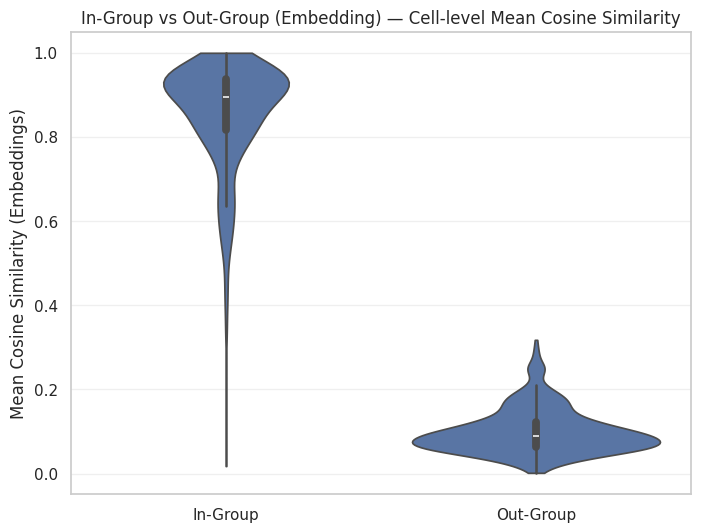

,Group,Mean,Median,Std Dev,n (cells)
0,In-Group,0.8531,0.8955,0.1297,400
1,Out-Group,0.1002,0.0890,0.0532,400
2,Difference (In-Out),0.7529,0.7900,0.1375,400


In [ ]:
# RQ1 — IN-GROUP vs OUT-GROUP (EMBEDDINGS)
# Strict in-group = SAME Prompt × SAME Model × SAME User
# Out-group = DIFFERENT Prompt (preferably same Model × User to keep context/platform comparable)
# Outputs:
# 1) per-cell in-group mean similarities
# 2) matched per-cell out-group mean similarities (balanced by number of pairs)
# 3) summary stats, permutation test p-value, bootstrap CI for mean difference
# 4) violin plot
# --- ensure parsed embeddings are available
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try: x = ast.literal_eval(x)
            except (ValueError, SyntaxError): return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# --- choose column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# --- keep only rows with valid embeddings
X = df.dropna(subset=['embedding_vec']).copy()
X['row_id'] = np.arange(len(X))

# --- helper: mean of upper-triangle similarities for a subset
def mean_upper_cos_sim(sub):
    if len(sub) < 2: return None, 0
    M = np.vstack(sub['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0: return None, 0
    return float(np.mean(vals)), int(vals.size)

# --- build per-cell (Prompt×Model×User) IN-GROUP means + pair counts
cells = []
for keys, g in X.groupby([prompt_col, 'Model', user_col]):
    m, n_pairs = mean_upper_cos_sim(g)
    if m is None: continue
    cells.append({
        prompt_col: keys[0], 'Model': keys[1], user_col: keys[2],
        'cell_size': len(g), 'in_mean': m, 'in_pairs': n_pairs,
        'row_ids': g['row_id'].tolist()
    })
cells = pd.DataFrame(cells)

# --- build matched OUT-GROUP means per cell
# strategy: for each cell, sample the same number of pairs from rows with SAME Model×User but DIFFERENT Prompt
# if insufficient, fall back to rows with DIFFERENT Prompt (any Model×User)
def sample_outgroup_mean(cell_row):
    this_prompt, this_model, this_user = cell_row[prompt_col], cell_row['Model'], cell_row[user_col]
    need_pairs = int(cell_row['in_pairs'])
    if need_pairs == 0: return None

    # candidate pool: same model+user, different prompt
    pool_same_mu = X[(X['Model']==this_model) & (X[user_col]==this_user) & (X[prompt_col]!=this_prompt)]
    # fallback pool: different prompt (ignore model/user)
    pool_any_dp  = X[X[prompt_col]!=this_prompt]

    # if pool too small to form at least 2 rows, abort
    def try_pool(pool):
        if len(pool) < 2: return None
        M = np.vstack(pool['embedding_vec'].values)
        S = cosine_similarity(M)
        iu = np.triu_indices_from(S, k=1)
        vals = S[iu]
        if vals.size == 0: return None
        # sample the same number of pairs without replacement if possible, else with replacement
        replace = need_pairs > vals.size
        idx = rng.choice(vals.size, size=need_pairs, replace=replace)
        return float(np.mean(vals[idx]))

    out_mean = try_pool(pool_same_mu)
    if out_mean is None:
        out_mean = try_pool(pool_any_dp)
    return out_mean

cells['out_mean'] = cells.apply(sample_outgroup_mean, axis=1)
cells = cells.dropna(subset=['out_mean']).reset_index(drop=True)

# --- assemble distributions for inference
in_vals  = cells['in_mean'].values
out_vals = cells['out_mean'].values
diff_vals = in_vals - out_vals

# --- summary stats
print("IN-GROUP (Embedding) mean ± sd:", np.mean(in_vals).round(4), "±", np.std(in_vals).round(4), "n_cells=", len(in_vals))
print("OUT-GROUP (Embedding) mean ± sd:", np.mean(out_vals).round(4), "±", np.std(out_vals).round(4), "n_cells=", len(out_vals))
print("Mean difference (IN - OUT):", np.mean(diff_vals).round(4))

# --- permutation test for mean difference (two-sided)
def perm_test_mean_diff(a, b, iters=5000):
    obs = np.mean(a) - np.mean(b)
    pooled = np.concatenate([a, b])
    count = 0
    for _ in range(iters):
        rng.shuffle(pooled)
        a_star = pooled[:len(a)]
        b_star = pooled[len(a):]
        if abs(np.mean(a_star) - np.mean(b_star)) >= abs(obs):
            count += 1
    return (count + 1) / (iters + 1), obs

pval, obs = perm_test_mean_diff(in_vals, out_vals, iters=5000)
print("Permutation test: mean(IN) - mean(OUT) =", round(obs,4), " p-value =", round(pval,6))

# --- bootstrap 95% CI for mean difference
def bootstrap_ci_mean_diff(a, b, iters=5000, alpha=0.05):
    diffs = []
    for _ in range(iters):
        a_s = rng.choice(a, size=len(a), replace=True)
        b_s = rng.choice(b, size=len(b), replace=True)
        diffs.append(np.mean(a_s) - np.mean(b_s))
    lo, hi = np.percentile(diffs, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

ci_lo, ci_hi = bootstrap_ci_mean_diff(in_vals, out_vals, iters=5000, alpha=0.05)
print("Bootstrap 95% CI for mean difference (IN - OUT): [", round(ci_lo,4), ",", round(ci_hi,4), "]")

# --- violin plot (distributions of cell-level means)
plt.figure(figsize=(8,6))
plot_df = pd.DataFrame({
    'group': ['In-Group']*len(in_vals) + ['Out-Group']*len(out_vals),
    'mean_similarity': np.concatenate([in_vals, out_vals])
})
sns.violinplot(data=plot_df, x='group', y='mean_similarity', inner='box', cut=0)
plt.title('In-Group vs Out-Group (Embedding) — Cell-level Mean Cosine Similarity')
plt.xlabel('')
plt.ylabel('Mean Cosine Similarity (Embeddings)')
plt.grid(True, axis='y', alpha=0.3)
plt.show()

# --- quick table you can paste into the paper
summary_table = pd.DataFrame({
    'Group': ['In-Group','Out-Group','Difference (In-Out)'],
    'Mean': [np.mean(in_vals), np.mean(out_vals), np.mean(diff_vals)],
    'Median': [np.median(in_vals), np.median(out_vals), np.median(diff_vals)],
    'Std Dev': [np.std(in_vals), np.std(out_vals), np.std(diff_vals)],
    'n (cells)': [len(in_vals), len(out_vals), len(diff_vals)]
}).round(4)
summary_table


IN-GROUP (TF-IDF) mean ± sd: 0.3734 ± 0.2016 n_cells= 400
OUT-GROUP (TF-IDF) mean ± sd: 0.0276 ± 0.0234 n_cells= 400
Mean difference (IN - OUT): 0.3458
Permutation test (TF-IDF): mean(IN) - mean(OUT) = 0.3458  p-value = 0.0002
Bootstrap 95% CI (TF-IDF) for mean difference (IN - OUT): [ 0.3264 , 0.3657 ]


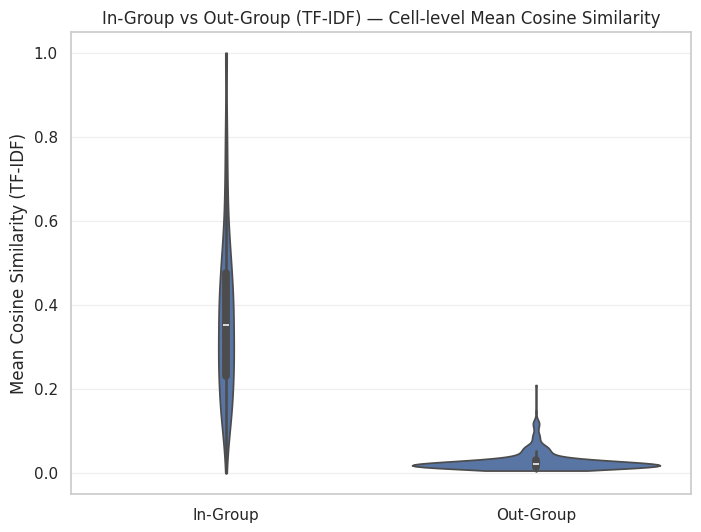

,Group,Mean,Median,Std Dev,n (cells)
0,In-Group,0.3734,0.3527,0.2016,400
1,Out-Group,0.0276,0.0204,0.0234,400
2,Difference (In-Out),0.3458,0.3179,0.2044,400


In [ ]:
# RQ1 — IN-GROUP vs OUT-GROUP (TF-IDF)
# Strict in-group = SAME Prompt × SAME Model × SAME User
# Out-group = DIFFERENT Prompt (preferably same Model × User; fallback = any Model × User)
# Outputs: per-cell in/out means, permutation p, bootstrap CI, violin plot, summary table
try:
    rng
except NameError:
    rng = np.random.default_rng(42)

# --- choose column names
text_col   = 'Response Text' if 'Response Text' in df.columns else (
             'Response' if 'Response' in df.columns else df.columns[df.columns.str.contains('Response', case=False)][0])
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# --- keep only rows with usable text
T = df.dropna(subset=[text_col]).copy()
T[text_col] = T[text_col].astype(str)
T['row_id'] = np.arange(len(T))

# --- build TF-IDF (standard lexical baseline)
tfidf = TfidfVectorizer(
    ngram_range=(1,2),     # unigrams + bigrams
    min_df=2,              # ignore extremely rare terms (change if you want)
    max_df=0.95,           # ignore very common terms
    lowercase=True,
    norm='l2',
    sublinear_tf=True      # log scaling of term frequency
)
X_tfidf = tfidf.fit_transform(T[text_col])   # sparse CSR, shape = (n_docs, n_terms)
T['tfidf_row'] = list(range(X_tfidf.shape[0]))  # index pointer into X_tfidf

# --- helper: mean of upper-triangle cosine similarities for a subset (sparse OK)
def mean_upper_cos_sim_sparse(indexes):
    if len(indexes) < 2:
        return None, 0
    M = X_tfidf[indexes]  # sparse
    S = cosine_similarity(M)  # dense (len x len)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(np.mean(vals)), int(vals.size)

# --- per-cell (Prompt×Model×User) IN-GROUP means + pair counts
cells_tf = []
for keys, g in T.groupby([prompt_col, 'Model', user_col], dropna=False):
    idxs = g['tfidf_row'].to_numpy()
    m, n_pairs = mean_upper_cos_sim_sparse(idxs)
    if m is None:
        continue
    cells_tf.append({
        prompt_col: keys[0], 'Model': keys[1], user_col: keys[2],
        'cell_size': len(g), 'in_mean': m, 'in_pairs': n_pairs,
        'row_ids': g['row_id'].tolist(), 'tfidf_rows': idxs.tolist()
    })
cells_tf = pd.DataFrame(cells_tf)

# --- matched OUT-GROUP means per cell
def sample_outgroup_mean_tfidf(cell_row):
    this_prompt, this_model, this_user = cell_row[prompt_col], cell_row['Model'], cell_row[user_col]
    need_pairs = int(cell_row['in_pairs'])
    if need_pairs == 0:
        return None

    # candidate pool: same model+user, different prompt
    pool_same_mu = T[(T['Model'] == this_model) & (T[user_col] == this_user) & (T[prompt_col] != this_prompt)]
    # fallback pool: different prompt (ignore model/user)
    pool_any_dp  = T[T[prompt_col] != this_prompt]

    def try_pool(pool):
        if len(pool) < 2:
            return None
        idxs = pool['tfidf_row'].to_numpy()
        M = X_tfidf[idxs]
        S = cosine_similarity(M)
        iu = np.triu_indices_from(S, k=1)
        vals = S[iu]
        if vals.size == 0:
            return None
        replace = need_pairs > vals.size
        sel = rng.choice(vals.size, size=need_pairs, replace=replace)
        return float(np.mean(vals[sel]))

    out_mean = try_pool(pool_same_mu)
    if out_mean is None:
        out_mean = try_pool(pool_any_dp)
    return out_mean

cells_tf['out_mean'] = cells_tf.apply(sample_outgroup_mean_tfidf, axis=1)
cells_tf = cells_tf.dropna(subset=['out_mean']).reset_index(drop=True)

# --- assemble distributions for inference
in_vals_tf  = cells_tf['in_mean'].to_numpy()
out_vals_tf = cells_tf['out_mean'].to_numpy()
diff_vals_tf = in_vals_tf - out_vals_tf

# --- summary stats
print("IN-GROUP (TF-IDF) mean ± sd:", np.mean(in_vals_tf).round(4), "±", np.std(in_vals_tf).round(4), "n_cells=", len(in_vals_tf))
print("OUT-GROUP (TF-IDF) mean ± sd:", np.mean(out_vals_tf).round(4), "±", np.std(out_vals_tf).round(4), "n_cells=", len(out_vals_tf))
print("Mean difference (IN - OUT):", np.mean(diff_vals_tf).round(4))

# --- permutation test for mean difference (two-sided)
def perm_test_mean_diff(a, b, iters=5000):
    obs = np.mean(a) - np.mean(b)
    pooled = np.concatenate([a, b])
    count = 0
    for _ in range(iters):
        rng.shuffle(pooled)
        a_star = pooled[:len(a)]
        b_star = pooled[len(a):]
        if abs(np.mean(a_star) - np.mean(b_star)) >= abs(obs):
            count += 1
    return (count + 1) / (iters + 1), obs

pval_tf, obs_tf = perm_test_mean_diff(in_vals_tf, out_vals_tf, iters=5000)
print("Permutation test (TF-IDF): mean(IN) - mean(OUT) =", round(obs_tf,4), " p-value =", round(pval_tf,6))

# --- bootstrap 95% CI for mean difference
def bootstrap_ci_mean_diff(a, b, iters=5000, alpha=0.05):
    diffs = np.empty(iters, dtype=np.float64)
    nA, nB = len(a), len(b)
    for i in range(iters):
        a_s = a[rng.integers(0, nA, nA)]
        b_s = b[rng.integers(0, nB, nB)]
        diffs[i] = np.mean(a_s) - np.mean(b_s)
    lo, hi = np.percentile(diffs, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

ci_lo_tf, ci_hi_tf = bootstrap_ci_mean_diff(in_vals_tf, out_vals_tf, iters=5000, alpha=0.05)
print("Bootstrap 95% CI (TF-IDF) for mean difference (IN - OUT): [", round(ci_lo_tf,4), ",", round(ci_hi_tf,4), "]")

# --- violin plot
plt.figure(figsize=(8,6))
plot_df_tf = pd.DataFrame({
    'group': ['In-Group']*len(in_vals_tf) + ['Out-Group']*len(out_vals_tf),
    'mean_similarity': np.concatenate([in_vals_tf, out_vals_tf])
})
sns.violinplot(data=plot_df_tf, x='group', y='mean_similarity', inner='box', cut=0)
plt.title('In-Group vs Out-Group (TF-IDF) — Cell-level Mean Cosine Similarity')
plt.xlabel('')
plt.ylabel('Mean Cosine Similarity (TF-IDF)')
plt.grid(True, axis='y', alpha=0.3)
plt.show()

# --- summary table for the paper
summary_table_tfidf = pd.DataFrame({
    'Group': ['In-Group','Out-Group','Difference (In-Out)'],
    'Mean':   [np.mean(in_vals_tf),  np.mean(out_vals_tf),  np.mean(diff_vals_tf)],
    'Median': [np.median(in_vals_tf),np.median(out_vals_tf),np.median(diff_vals_tf)],
    'Std Dev':[np.std(in_vals_tf),   np.std(out_vals_tf),   np.std(diff_vals_tf)],
    'n (cells)': [len(in_vals_tf), len(out_vals_tf), len(diff_vals_tf)]
}).round(4)

summary_table_tfidf


Cell count: 400   Prompt types: ['Specific Logical', 'Vague Creative', 'Specific Creative', 'Vague Logical']
Kruskal–Wallis H=82.0204, p=0.000000

Dunn post-hoc p-values (FDR-corrected):


,Specific Creative,Specific Logical,Vague Creative,Vague Logical
Specific Creative,1.000000e+00,1.752426e-08,5.031630e-02,6.872239e-06
Specific Logical,1.752426e-08,1.000000e+00,4.106974e-14,2.419977e-01
Vague Creative,5.031630e-02,4.106974e-14,1.000000e+00,1.097424e-10
Vague Logical,6.872239e-06,2.419977e-01,1.097424e-10,1.000000e+00



Summary by Prompt Type (cell-level embedding means):


,Prompt Type,Mean,Median,Std Dev,n_cells,CI95_Lo,CI95_Hi
0,Vague Logical,0.9037,0.9215,0.0674,100,0.8893,0.9161
1,Specific Logical,0.8986,0.9340,0.1323,100,0.8697,0.9217
2,Specific Creative,0.8397,0.8414,0.0982,100,0.8199,0.8581
3,Vague Creative,0.7705,0.8084,0.1548,100,0.7395,0.8001


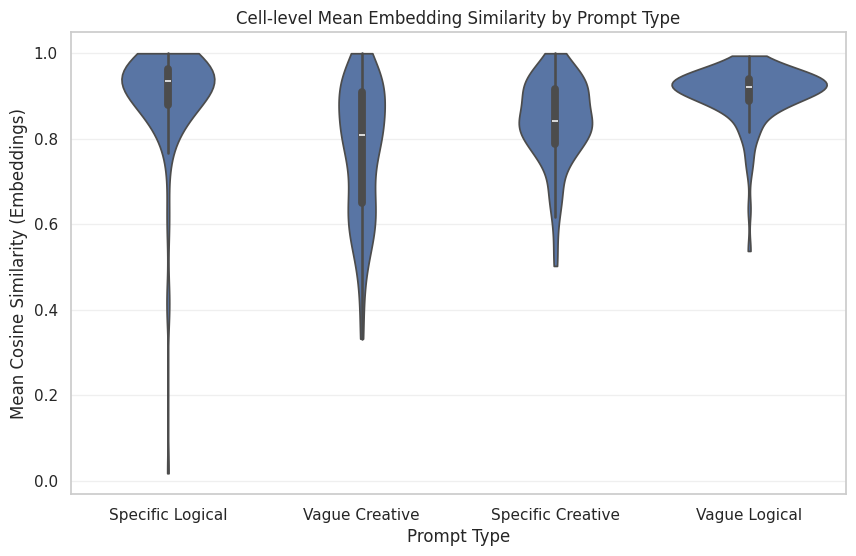

In [ ]:
# RQ2 — Do prompt types differ in similarity? (EMBEDDINGS, robust + compact)
# Steps:
# 1) Build independent cell-means: one mean similarity per (Prompt, Model, User)
# 2) Kruskal–Wallis across Prompt Types (robust, 4+ groups)
# 3) Dunn post-hoc with FDR correction
# 4) Group summaries with 95% bootstrap CIs
# 5) Violin plot of cell-level means by Prompt Type
# --- ensure embeddings parsed into df['embedding_vec']
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try: x = ast.literal_eval(x)
            except (ValueError, SyntaxError): return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# --- choose column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
ptype_col  = 'Prompt Type'
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# --- keep valid rows
X = df.dropna(subset=['embedding_vec', ptype_col]).copy()

# --- helper: upper-triangle mean similarity from embeddings
def mean_upper_cos_sim(sub):
    if len(sub) < 2: return None, 0
    M = np.vstack(sub['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0: return None, 0
    return float(np.mean(vals)), int(vals.size)

# --- build cell-means per (Prompt, Model, User)
rows = []
for keys, g in X.groupby([prompt_col, 'Model', user_col]):
    m, n_pairs = mean_upper_cos_sim(g)
    if m is None:
        continue
    rows.append({
        prompt_col: keys[0],
        'Model': keys[1],
        user_col: keys[2],
        ptype_col: g[ptype_col].iloc[0],
        'cell_mean_embed': m,
        'cell_n_pairs': n_pairs,
        'cell_n_responses': len(g)
    })
cells = pd.DataFrame(rows)

# --- drop any cells with no valid pairs (safety)
cells = cells.dropna(subset=['cell_mean_embed'])
print("Cell count:", len(cells), "  Prompt types:", cells[ptype_col].unique().tolist())

# --- Kruskal–Wallis across prompt types (uses independent cell-means)
groups = [grp['cell_mean_embed'].values for _, grp in cells.groupby(ptype_col)]
kw_stat, kw_p = kruskal(*groups)
print(f"Kruskal–Wallis H={kw_stat:.4f}, p={kw_p:.6f}")

# --- Dunn post-hoc with FDR correction (pairwise between prompt types)
dunn = sp.posthoc_dunn(cells, val_col='cell_mean_embed', group_col=ptype_col, p_adjust='fdr_bh')
print("\nDunn post-hoc p-values (FDR-corrected):")
display(dunn)

# --- bootstrap 95% CI for each prompt type mean of cell-means
def bootstrap_mean_ci(x, iters=5000, alpha=0.05):
    x = np.asarray(x)
    draws = rng.choice(x, size=(iters, x.size), replace=True).mean(axis=1)
    lo, hi = np.percentile(draws, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

summ_rows = []
for ptype, g in cells.groupby(ptype_col):
    arr = g['cell_mean_embed'].values
    lo, hi = bootstrap_mean_ci(arr, iters=5000)
    summ_rows.append({
        ptype_col: ptype,
        'Mean': float(np.mean(arr)),
        'Median': float(np.median(arr)),
        'Std Dev': float(np.std(arr)),
        'n_cells': int(len(arr)),
        'CI95_Lo': lo,
        'CI95_Hi': hi
    })
summary_ptype = pd.DataFrame(summ_rows).sort_values('Mean', ascending=False).reset_index(drop=True)
print("\nSummary by Prompt Type (cell-level embedding means):")
display(summary_ptype.round(4))

# --- violin plot of cell-level means by prompt type
plt.figure(figsize=(10,6))
sns.violinplot(data=cells, x=ptype_col, y='cell_mean_embed', inner='box', cut=0)
plt.title('Cell-level Mean Embedding Similarity by Prompt Type')
plt.xlabel('Prompt Type')
plt.ylabel('Mean Cosine Similarity (Embeddings)')
plt.grid(True, axis='y', alpha=0.3)
plt.show()


Cell count (TF-IDF): 400   Prompt types: ['Specific Logical', 'Vague Creative', 'Specific Creative', 'Vague Logical']
Kruskal–Wallis (TF-IDF) H=28.7963, p=0.000002

Dunn post-hoc p-values (TF-IDF, FDR-corrected):


,Specific Creative,Specific Logical,Vague Creative,Vague Logical
Specific Creative,1.000000,0.000018,0.756961,0.015213
Specific Logical,0.000018,1.000000,0.000039,0.054605
Vague Creative,0.756961,0.000039,1.000000,0.027443
Vague Logical,0.015213,0.054605,0.027443,1.000000



Summary by Prompt Type (cell-level TF-IDF means):


,Prompt Type,Mean,Median,Std Dev,n_cells,CI95_Lo,CI95_Hi
0,Specific Logical,0.6759,0.7035,0.1998,100,0.6354,0.7145
1,Vague Logical,0.6196,0.6495,0.1673,100,0.5867,0.6517
2,Vague Creative,0.5634,0.5546,0.1791,100,0.5266,0.5996
3,Specific Creative,0.5529,0.5395,0.1868,100,0.5160,0.5897


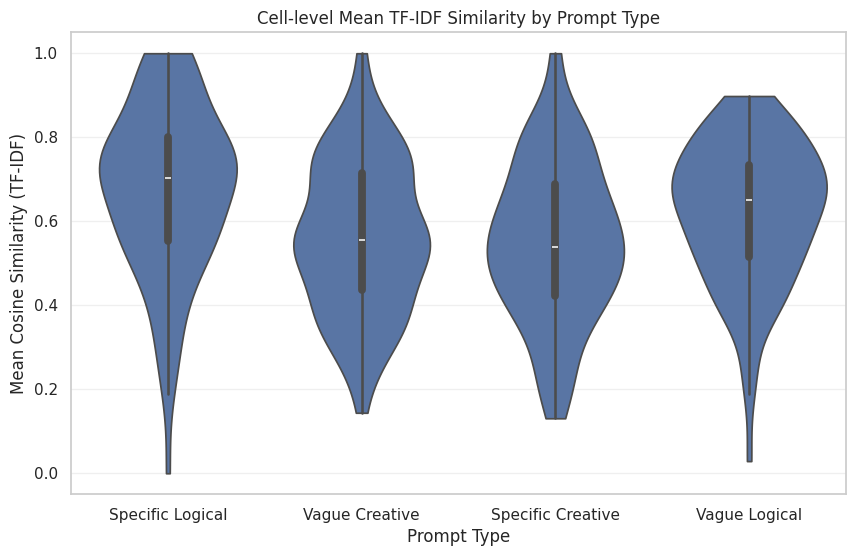

In [ ]:
# RQ2 — Do prompt types differ in similarity? (TF-IDF version, robust + compact)
# Steps mirror the embedding version:
# 1) Build independent cell-means: one mean similarity per (Prompt, Model, User) using TF-IDF
# 2) Kruskal–Wallis across Prompt Types
# 3) Dunn post-hoc with FDR correction
# 4) Group summaries with 95% bootstrap CIs
# 5) Violin plot of cell-level means by Prompt Type
# --- column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
ptype_col  = 'Prompt Type'
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# --- keep rows with text and prompt type
X = df.dropna(subset=['Response Text', ptype_col]).copy()

# --- helper: upper-triangle mean TF-IDF cosine similarity
def mean_upper_cos_sim_tfidf(sub):
    if len(sub) < 2:
        return None, 0
    X_tfidf = TfidfVectorizer().fit_transform(sub['Response Text'])
    S = cosine_similarity(X_tfidf)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(np.mean(vals)), int(vals.size)

# --- build cell-means per (Prompt, Model, User)
rows = []
for keys, g in X.groupby([prompt_col, 'Model', user_col]):
    m, n_pairs = mean_upper_cos_sim_tfidf(g)
    if m is None:
        continue
    rows.append({
        prompt_col: keys[0],
        'Model': keys[1],
        user_col: keys[2],
        ptype_col: g[ptype_col].iloc[0],
        'cell_mean_tfidf': m,
        'cell_n_pairs': n_pairs,
        'cell_n_responses': len(g)
    })

cells_tf = pd.DataFrame(rows).dropna(subset=['cell_mean_tfidf'])
print("Cell count (TF-IDF):", len(cells_tf), "  Prompt types:", cells_tf[ptype_col].unique().tolist())

# --- Kruskal–Wallis across prompt types (independent cell-means)
groups = [grp['cell_mean_tfidf'].values for _, grp in cells_tf.groupby(ptype_col)]
kw_stat, kw_p = kruskal(*groups)
print(f"Kruskal–Wallis (TF-IDF) H={kw_stat:.4f}, p={kw_p:.6f}")

# --- Dunn post-hoc with FDR correction
dunn_tf = sp.posthoc_dunn(cells_tf, val_col='cell_mean_tfidf', group_col=ptype_col, p_adjust='fdr_bh')
print("\nDunn post-hoc p-values (TF-IDF, FDR-corrected):")
display(dunn_tf)

# --- bootstrap 95% CI for each prompt type mean of cell-means
def bootstrap_mean_ci(x, iters=5000, alpha=0.05):
    x = np.asarray(x)
    draws = rng.choice(x, size=(iters, x.size), replace=True).mean(axis=1)
    lo, hi = np.percentile(draws, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

summ_rows = []
for ptype, g in cells_tf.groupby(ptype_col):
    arr = g['cell_mean_tfidf'].values
    lo, hi = bootstrap_mean_ci(arr, iters=5000)
    summ_rows.append({
        ptype_col: ptype,
        'Mean': float(np.mean(arr)),
        'Median': float(np.median(arr)),
        'Std Dev': float(np.std(arr)),
        'n_cells': int(len(arr)),
        'CI95_Lo': lo,
        'CI95_Hi': hi
    })

summary_ptype_tfidf = pd.DataFrame(summ_rows).sort_values('Mean', ascending=False).reset_index(drop=True)
print("\nSummary by Prompt Type (cell-level TF-IDF means):")
display(summary_ptype_tfidf.round(4))

# --- violin plot of cell-level TF-IDF means by prompt type
plt.figure(figsize=(10,6))
sns.violinplot(data=cells_tf, x=ptype_col, y='cell_mean_tfidf', inner='box', cut=0)
plt.title('Cell-level Mean TF-IDF Similarity by Prompt Type')
plt.xlabel('Prompt Type')
plt.ylabel('Mean Cosine Similarity (TF-IDF)')
plt.grid(True, axis='y', alpha=0.3)
plt.show()


Kruskal–Wallis across models: H=5.6308, p=0.228472

Dunn post-hoc p-values (FDR-corrected):


,ChatGPT 5.0,DeepSeek 3.1,Google Gemini 2.5,Grok 4.0,Meta Llama 4.0
ChatGPT 5.0,1.000000,0.521305,0.714745,0.426011,0.714745
DeepSeek 3.1,0.521305,1.000000,0.639482,0.714745,0.426011
Google Gemini 2.5,0.714745,0.639482,1.000000,0.521305,0.582311
Grok 4.0,0.426011,0.714745,0.521305,1.000000,0.393383
Meta Llama 4.0,0.714745,0.426011,0.582311,0.393383,1.000000



Summary by Model (cell-level embedding means):


,Model,Mean,Median,Std Dev,n_cells,CI95_Lo,CI95_Hi
0,Grok 4.0,0.8678,0.9159,0.1172,80,0.8414,0.8926
1,DeepSeek 3.1,0.8653,0.9077,0.1217,80,0.8371,0.8915
2,ChatGPT 5.0,0.8561,0.8932,0.1074,80,0.8324,0.8790
3,Google Gemini 2.5,0.8469,0.9066,0.1330,80,0.8158,0.8741
4,Meta Llama 4.0,0.8295,0.8649,0.1594,80,0.7922,0.8629


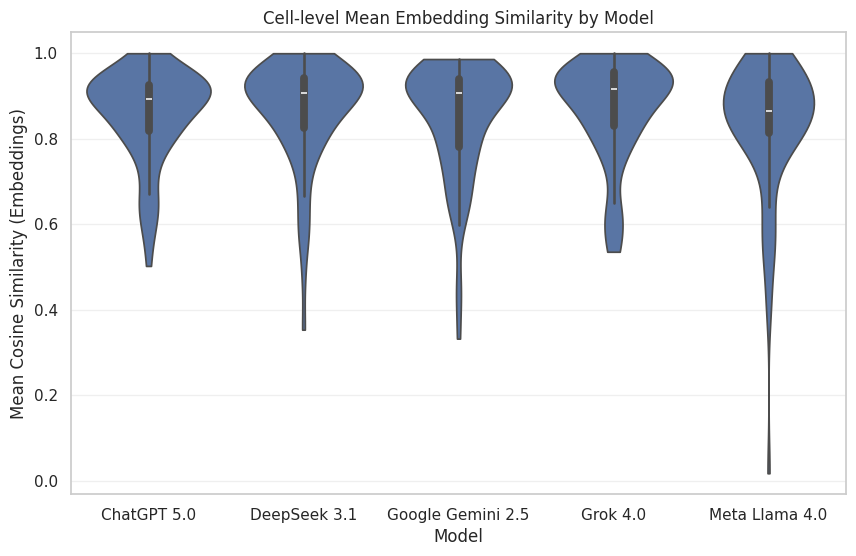

In [ ]:
# RQ3 — Do models differ in similarity? (EMBEDDINGS, robust + compact)
# 1) Build independent cell-means: one mean similarity per (Prompt, Model, User)
# 2) Kruskal–Wallis across Models
# 3) Dunn post-hoc with FDR correction
# 4) Model summaries with 95% bootstrap CIs
# 5) Violin plot of cell-level means by Model

import ast, numpy as np, pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
from scipy.stats import kruskal
import matplotlib.pyplot as plt, seaborn as sns
# !pip -q install scikit-posthocs
import scikit_posthocs as sp

rng = np.random.default_rng(42)

# ensure embeddings parsed into df['embedding_vec']
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try: x = ast.literal_eval(x)
            except (ValueError, SyntaxError): return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# choose column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# keep valid rows
X = df.dropna(subset=['embedding_vec', 'Model']).copy()

# helper: upper-triangle mean similarity from embeddings
def mean_upper_cos_sim(sub):
    if len(sub) < 2: return None, 0
    M = np.vstack(sub['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0: return None, 0
    return float(np.mean(vals)), int(vals.size)

# build cell-means per (Prompt, Model, User)
rows = []
for keys, g in X.groupby([prompt_col, 'Model', user_col]):
    m, n_pairs = mean_upper_cos_sim(g)
    if m is None:
        continue
    rows.append({
        prompt_col: keys[0],
        'Model': keys[1],
        user_col: keys[2],
        'cell_mean_embed': m,
        'cell_n_pairs': n_pairs,
        'cell_n_responses': len(g)
    })
cells = pd.DataFrame(rows).dropna(subset=['cell_mean_embed'])

# Kruskal–Wallis across models (independent cell-means)
groups = [grp['cell_mean_embed'].values for _, grp in cells.groupby('Model')]
kw_stat, kw_p = kruskal(*groups)
print(f"Kruskal–Wallis across models: H={kw_stat:.4f}, p={kw_p:.6f}")

# Dunn post-hoc with FDR correction
dunn = sp.posthoc_dunn(cells, val_col='cell_mean_embed', group_col='Model', p_adjust='fdr_bh')
print("\nDunn post-hoc p-values (FDR-corrected):")
display(dunn)

# bootstrap 95% CI for each model mean of cell-means
def bootstrap_mean_ci(x, iters=5000, alpha=0.05):
    x = np.asarray(x)
    draws = rng.choice(x, size=(iters, x.size), replace=True).mean(axis=1)
    lo, hi = np.percentile(draws, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

summ_rows = []
for model_name, g in cells.groupby('Model'):
    arr = g['cell_mean_embed'].values
    lo, hi = bootstrap_mean_ci(arr, iters=5000)
    summ_rows.append({
        'Model': model_name,
        'Mean': float(np.mean(arr)),
        'Median': float(np.median(arr)),
        'Std Dev': float(np.std(arr)),
        'n_cells': int(len(arr)),
        'CI95_Lo': lo,
        'CI95_Hi': hi
    })
summary_model = pd.DataFrame(summ_rows).sort_values('Mean', ascending=False).reset_index(drop=True)
print("\nSummary by Model (cell-level embedding means):")
display(summary_model.round(4))

# violin plot of cell-level means by Model
plt.figure(figsize=(10,6))
sns.violinplot(data=cells, x='Model', y='cell_mean_embed', inner='box', cut=0)
plt.title('Cell-level Mean Embedding Similarity by Model')
plt.xlabel('Model')
plt.ylabel('Mean Cosine Similarity (Embeddings)')
plt.grid(True, axis='y', alpha=0.3)
plt.show()


Kruskal–Wallis across models (TF-IDF): H=51.6457, p=0.000000

Dunn post-hoc p-values (TF-IDF, FDR-corrected):


,ChatGPT 5.0,DeepSeek 3.1,Google Gemini 2.5,Grok 4.0,Meta Llama 4.0
ChatGPT 5.0,1.000000,1.190973e-05,0.000146,0.734743,3.847274e-01
DeepSeek 3.1,0.000012,1.000000e+00,0.559855,0.000043,1.561350e-07
Google Gemini 2.5,0.000146,5.598547e-01,1.000000,0.000477,3.077841e-06
Grok 4.0,0.734743,4.348240e-05,0.000477,1.000000,2.489121e-01
Meta Llama 4.0,0.384727,1.561350e-07,0.000003,0.248912,1.000000e+00



Summary by Model (cell-level TF-IDF means):


,Model,Mean,Median,Std Dev,n_cells,CI95_Lo,CI95_Hi
0,DeepSeek 3.1,0.6922,0.7125,0.1636,80,0.6547,0.7271
1,Google Gemini 2.5,0.6663,0.7143,0.1629,80,0.6309,0.7023
2,Grok 4.0,0.5672,0.5461,0.1918,80,0.5250,0.6082
3,ChatGPT 5.0,0.5618,0.5557,0.1800,80,0.5225,0.6022
4,Meta Llama 4.0,0.5273,0.5336,0.1939,80,0.4857,0.5708


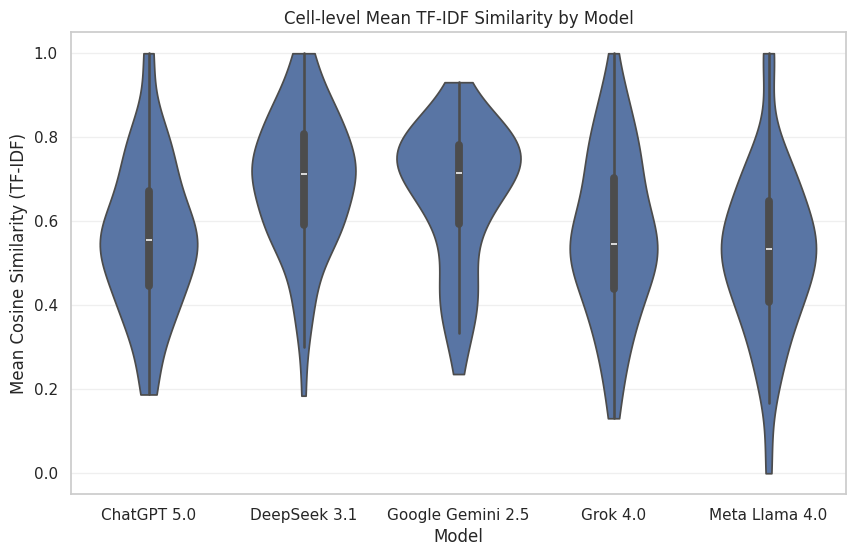

In [ ]:
# RQ3 — Do models differ in similarity? (TF-IDF version, robust + compact)
# 1) Build independent cell-means: one mean similarity per (Prompt, Model, User) using TF-IDF
# 2) Kruskal–Wallis across Models
# 3) Dunn post-hoc with FDR correction
# 4) Model summaries with 95% bootstrap CIs
# 5) Violin plot of cell-level means by Model
# column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# keep rows with text and model
X = df.dropna(subset=['Response Text', 'Model']).copy()

# helper: upper-triangle mean TF-IDF cosine similarity
def mean_upper_cos_sim_tfidf(sub):
    if len(sub) < 2:
        return None, 0
    X_tfidf = TfidfVectorizer().fit_transform(sub['Response Text'])
    S = cosine_similarity(X_tfidf)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(np.mean(vals)), int(vals.size)

# build cell-means per (Prompt, Model, User)
rows = []
for keys, g in X.groupby([prompt_col, 'Model', user_col]):
    m, n_pairs = mean_upper_cos_sim_tfidf(g)
    if m is None:
        continue
    rows.append({
        prompt_col: keys[0],
        'Model': keys[1],
        user_col: keys[2],
        'cell_mean_tfidf': m,
        'cell_n_pairs': n_pairs,
        'cell_n_responses': len(g)
    })
cells_tf = pd.DataFrame(rows).dropna(subset=['cell_mean_tfidf'])

# Kruskal–Wallis across models (independent cell-means)
groups = [grp['cell_mean_tfidf'].values for _, grp in cells_tf.groupby('Model')]
kw_stat, kw_p = kruskal(*groups)
print(f"Kruskal–Wallis across models (TF-IDF): H={kw_stat:.4f}, p={kw_p:.6f}")

# Dunn post-hoc with FDR correction
dunn_tf = sp.posthoc_dunn(cells_tf, val_col='cell_mean_tfidf', group_col='Model', p_adjust='fdr_bh')
print("\nDunn post-hoc p-values (TF-IDF, FDR-corrected):")
display(dunn_tf)

# bootstrap 95% CI for each model mean of cell-means
def bootstrap_mean_ci(x, iters=5000, alpha=0.05):
    x = np.asarray(x)
    draws = rng.choice(x, size=(iters, x.size), replace=True).mean(axis=1)
    lo, hi = np.percentile(draws, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

summ_rows = []
for model_name, g in cells_tf.groupby('Model'):
    arr = g['cell_mean_tfidf'].values
    lo, hi = bootstrap_mean_ci(arr, iters=5000)
    summ_rows.append({
        'Model': model_name,
        'Mean': float(np.mean(arr)),
        'Median': float(np.median(arr)),
        'Std Dev': float(np.std(arr)),
        'n_cells': int(len(arr)),
        'CI95_Lo': lo,
        'CI95_Hi': hi
    })
summary_model_tfidf = pd.DataFrame(summ_rows).sort_values('Mean', ascending=False).reset_index(drop=True)
print("\nSummary by Model (cell-level TF-IDF means):")
display(summary_model_tfidf.round(4))

# violin plot of cell-level TF-IDF means by Model
plt.figure(figsize=(10,6))
sns.violinplot(data=cells_tf, x='Model', y='cell_mean_tfidf', inner='box', cut=0)
plt.title('Cell-level Mean TF-IDF Similarity by Model')
plt.xlabel('Model')
plt.ylabel('Mean Cosine Similarity (TF-IDF)')
plt.grid(True, axis='y', alpha=0.3)
plt.show()


Users detected (order in diff = u1 - u2): u1='Hayden', u2='Smera'


,Metric,Value
0,Mean diff (u1-u2),0.040509
1,Median diff,0.015453
2,Wilcoxon W,6188.000000
3,p-value,0.000004
4,CI95 low (median diff),0.005971
5,CI95 high (median diff),0.027459
6,"N pairs ((Prompt,Model))",200.000000


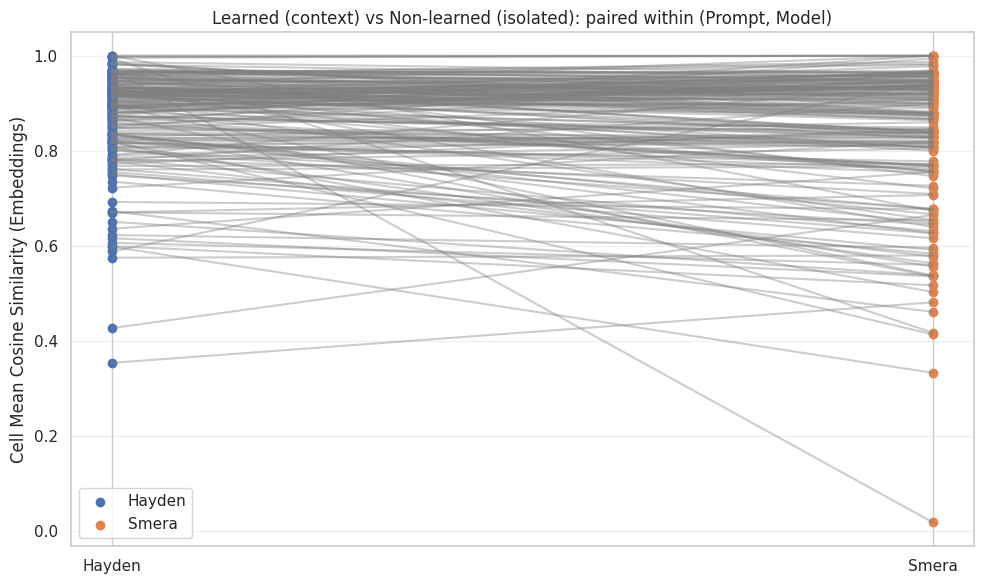

In [ ]:
# RQ4 (embedding)
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# choose column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# keep valid rows
DX = df.dropna(subset=['embedding_vec']).copy()

# helper: upper-triangle mean cosine similarity for a subset
def mean_upper_cos_sim(sub_df):
    if len(sub_df) < 2:
        return None, 0
    M = np.vstack(sub_df['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(np.mean(vals)), int(vals.size)

# 1) build cell means per (Prompt, Model, User)
rows = []
for keys, g in DX.groupby([prompt_col, 'Model', user_col]):
    m, n_pairs = mean_upper_cos_sim(g)
    if m is None:
        continue
    rows.append({
        prompt_col: keys[0],
        'Model': keys[1],
        user_col: keys[2],
        'cell_mean_embed': m,
        'cell_pairs': n_pairs,
        'cell_n': len(g)
    })
cells = pd.DataFrame(rows)

# 2) keep only (Prompt, Model) that have BOTH users (Hayden and Smera)
users_in_data = cells[user_col].unique().tolist()
if len(users_in_data) != 2:
    print("Warning: expected exactly 2 users; found:", users_in_data)

pivot = cells.pivot_table(index=[prompt_col, 'Model'], columns=user_col, values='cell_mean_embed')
pivot = pivot.dropna()  # rows with both users present

# 3) paired differences: Hayden − Smera (rename here if your user labels differ)
u1, u2 = list(pivot.columns)
diff = pivot[u1] - pivot[u2]

# 4) Wilcoxon signed-rank test (paired)
# by default, tests median(diff) != 0
stat, pval = wilcoxon(pivot[u1], pivot[u2], zero_method='wilcox', alternative='two-sided', correction=False)

# 5) bootstrap 95% CI for the median difference
rng = np.random.default_rng(42)
def bootstrap_ci_median(x, iters=5000, alpha=0.05):
    x = np.asarray(x)
    draws = []
    n = x.size
    for _ in range(iters):
        s = rng.choice(x, size=n, replace=True)
        draws.append(np.median(s))
    lo, hi = np.percentile(draws, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

ci_lo, ci_hi = bootstrap_ci_median(diff.values, iters=5000, alpha=0.05)

# 6) outputs: summary table and a simple paired-lines plot
summary = pd.DataFrame({
    'Metric': ['Mean diff (u1-u2)', 'Median diff', 'Wilcoxon W', 'p-value', 'CI95 low (median diff)', 'CI95 high (median diff)', 'N pairs ((Prompt,Model))'],
    'Value': [diff.mean(), np.median(diff), stat, pval, ci_lo, ci_hi, len(diff)]
}).round(6)

print(f"Users detected (order in diff = u1 - u2): u1='{u1}', u2='{u2}'")
display(summary)

# paired-lines plot for a quick visual
plt.figure(figsize=(10, 6))
xpos = np.arange(len(pivot))
plt.plot([0, 1], [pivot[u1].values, pivot[u2].values], color='gray', alpha=0.4)
plt.scatter([0]*len(pivot), pivot[u1].values, label=u1)
plt.scatter([1]*len(pivot), pivot[u2].values, label=u2)
plt.xticks([0, 1], [u1, u2])
plt.ylabel('Cell Mean Cosine Similarity (Embeddings)')
plt.title('Learned (context) vs Non-learned (isolated): paired within (Prompt, Model)')
plt.grid(True, axis='y', alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

Users detected (diff = Hayden - Smera)


,Metric,Value
0,Median diff (Hayden-Smera),0.042267
1,Mean diff,0.042643
2,Wilcoxon W,6485.000000
3,p-value,0.000046
4,CI95 low (median diff),0.020107
5,CI95 high (median diff),0.061235
6,N pairs,200.000000


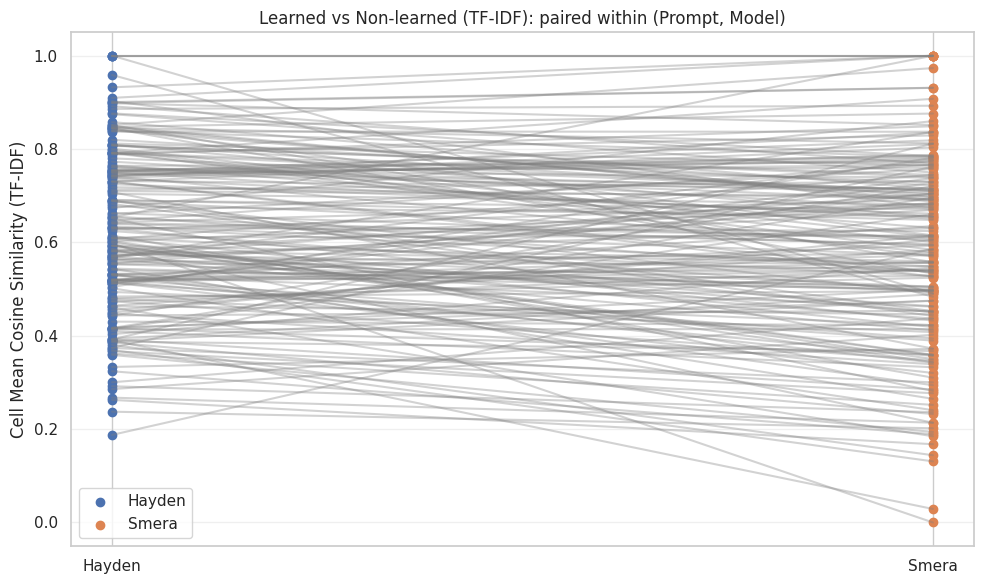

In [ ]:
# RQ4 — Learned vs Non-learned (TF-IDF version, paired within (Prompt × Model))
# Mirrors the embedding-based RQ4: builds TF-IDF cell means per (Prompt, Model, User),
# keeps only rows where BOTH users are present, runs Wilcoxon (paired), bootstraps CI,
# and draws a simple paired-lines plot.
# choose column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# helper: cell mean TF-IDF cosine similarity (upper triangle)
def tfidf_cell_mean(sub_df):
    if len(sub_df) < 2:
        return None, 0
    X_tfidf = TfidfVectorizer().fit_transform(sub_df['Response Text'])
    S = cosine_similarity(X_tfidf)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(vals.mean()), int(vals.size)

# build TF-IDF cell means per (Prompt, Model, User)
rows = []
for (p, m, u), g in df.dropna(subset=['Response Text']).groupby([prompt_col, 'Model', user_col]):
    m_tf, n_pairs = tfidf_cell_mean(g)
    if m_tf is None:
        continue
    rows.append({
        prompt_col: p, 'Model': m, user_col: u,
        'cell_mean_tfidf': m_tf,
        'pairs_tfidf': n_pairs,
        'n_responses': len(g)
    })
cells_tf = pd.DataFrame(rows)

# keep only (Prompt, Model) pairs with BOTH users present
pv_tf = cells_tf.pivot_table(index=[prompt_col, 'Model'], columns=user_col, values='cell_mean_tfidf').dropna()

# identify user labels (order matters for the diff sign)
u1, u2 = list(pv_tf.columns)

# paired Wilcoxon (two-sided) and bootstrap CI for median difference (u1 - u2)
stat, pval = wilcoxon(pv_tf[u1], pv_tf[u2], zero_method='wilcox', alternative='two-sided')

rng = np.random.default_rng(42)
def bootstrap_ci_median(x, iters=5000, alpha=0.05):
    x = np.asarray(x)
    draws = []
    n = x.size
    for _ in range(iters):
        s = rng.choice(x, size=n, replace=True)
        draws.append(np.median(s))
    lo, hi = np.percentile(draws, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

diff_tf = pv_tf[u1] - pv_tf[u2]
ci_lo, ci_hi = bootstrap_ci_median(diff_tf.values, iters=5000, alpha=0.05)

summary_tf_rq4 = pd.DataFrame({
    'Metric': ['Median diff ({}-{})'.format(u1, u2), 'Mean diff', 'Wilcoxon W', 'p-value', 'CI95 low (median diff)', 'CI95 high (median diff)', 'N pairs'],
    'Value': [np.median(diff_tf), diff_tf.mean(), stat, pval, ci_lo, ci_hi, len(diff_tf)]
}).round(6)

print(f"Users detected (diff = {u1} - {u2})")
display(summary_tf_rq4)

# paired-lines plot (TF-IDF)
plt.figure(figsize=(10,6))
plt.plot([0,1], [pv_tf[u1].values, pv_tf[u2].values], color='gray', alpha=0.35)
plt.scatter([0]*len(pv_tf), pv_tf[u1].values, label=u1)
plt.scatter([1]*len(pv_tf), pv_tf[u2].values, label=u2)
plt.xticks([0,1], [u1, u2])
plt.ylabel('Cell Mean Cosine Similarity (TF-IDF)')
plt.title('Learned vs Non-learned (TF-IDF): paired within (Prompt, Model)')
plt.grid(True, axis='y', alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()


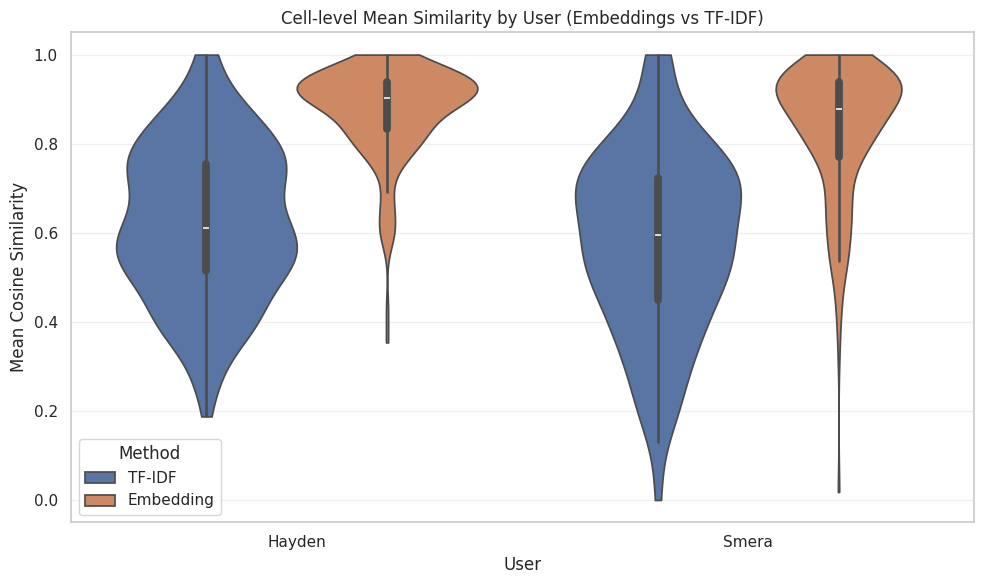

In [ ]:
# Violin plots of USER-LEVEL cell mean similarity for BOTH Embeddings and TF-IDF
# - Build independent cell-means per (Prompt, Model, User)
# - Long-format table with columns: User, Method, Cell_Mean
# - Violin plot(s) grouped by User and colored by Method

import ast
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

# --- ensure embeddings parsed into df['embedding_vec']
if 'embedding_vec' not in df.columns:
    def to_vec(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except Exception:
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vec)

# --- column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# --- helpers: upper-triangle mean cosine similarity for each method
def cell_mean_tfidf(sub_df):
    if len(sub_df) < 2:
        return None
    X_tfidf = TfidfVectorizer().fit_transform(sub_df['Response Text'])
    S = cosine_similarity(X_tfidf)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return float(vals.mean()) if vals.size else None

def cell_mean_embed(sub_df):
    if len(sub_df) < 2:
        return None
    M = np.vstack(sub_df['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return float(vals.mean()) if vals.size else None

# --- build long-format table of cell means by user and method
rows = []
# group by strict in-group: (Prompt, Model, User)
for (p, m, u), g in df.dropna(subset=['Response Text']).groupby([prompt_col, 'Model', user_col]):
    # TF-IDF
    cm_tf = cell_mean_tfidf(g)
    if cm_tf is not None:
        rows.append({user_col: u, 'Method': 'TF-IDF', 'Cell_Mean': cm_tf})
    # Embeddings (only if we have parsed vectors)
    if g['embedding_vec'].notna().all():
        cm_em = cell_mean_embed(g.dropna(subset=['embedding_vec']))
        if cm_em is not None:
            rows.append({user_col: u, 'Method': 'Embedding', 'Cell_Mean': cm_em})

cells_user_long = pd.DataFrame(rows)

# --- safety check: ensure we have data
assert not cells_user_long.empty, "No valid cells to plot. Check that you have ≥2 responses per (Prompt, Model, User)."

# --- violin plot: side-by-side violins per user, colored by method
plt.figure(figsize=(10, 6))
sns.violinplot(data=cells_user_long, x=user_col, y='Cell_Mean', hue='Method', inner='box', cut=0)
plt.title('Cell-level Mean Similarity by User (Embeddings vs TF-IDF)')
plt.xlabel('User')
plt.ylabel('Mean Cosine Similarity')
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

# --- OPTIONAL: separate violins per method (uncomment to also show individually)
# for method in ['Embedding', 'TF-IDF']:
#     plt.figure(figsize=(8, 5))
#     sns.violinplot(data=cells_user_long[cells_user_long['Method']==method],
#                    x=user_col, y='Cell_Mean', inner='box', cut=0)
#     plt.title(f'Cell-level Mean Similarity by User — {method}')
#     plt.xlabel('User')
#     plt.ylabel('Mean Cosine Similarity')
#     plt.grid(True, axis='y', alpha=0.3)
#     plt.tight_layout()
#     plt.show()



--- RQ5: Embeddings vs TF-IDF (paired within cells) ---


,Metric,Value
0,Mean(Embedding),0.853124
1,Mean(TF-IDF),0.602940
2,Mean difference (Emb - TF-IDF),0.250184
3,Median difference,0.242245
4,Wilcoxon W,962.000000
5,Wilcoxon p-value,0.000000
6,CI95 low (median diff),0.216693
7,CI95 high (median diff),0.263497
8,Spearman rho (Emb vs TF-IDF),0.623505
9,Spearman p-value,0.000000


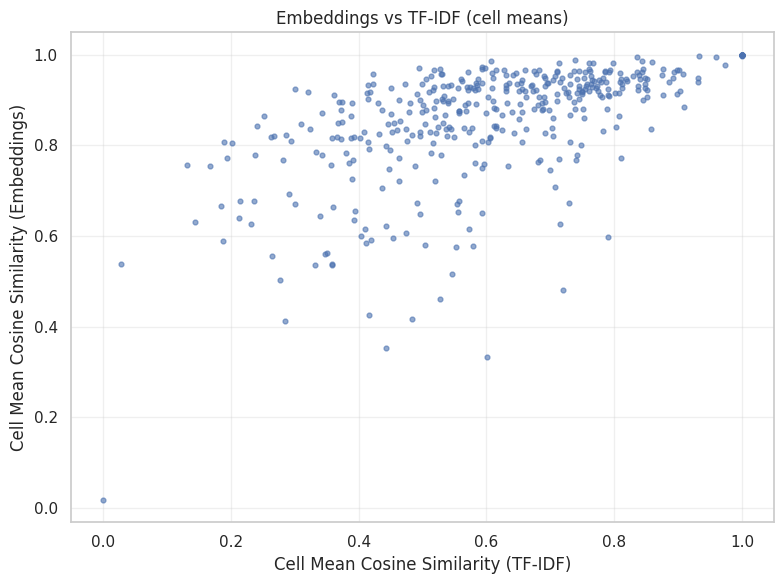

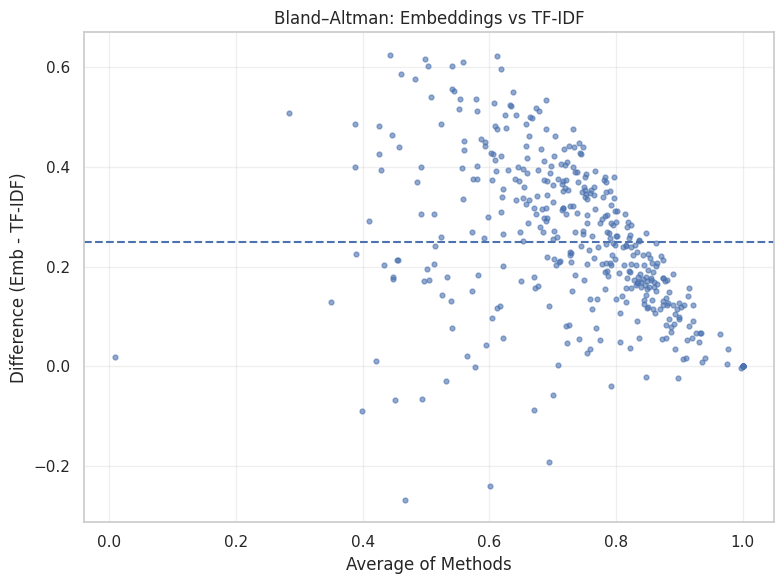

,Prompt,Model,User Name,cell_mean_embed,cell_mean_tfidf,diff_emb_minus_tfidf
27,Describe an engineer — without specifying gend...,Grok 4.0,Smera,0.7568,0.1309,0.6259
313,Write a joke about men and a joke about women.,DeepSeek 3.1,Smera,0.9231,0.3001,0.6230
41,How many Strawberries are in the letter 'r'?,ChatGPT 5.0,Smera,0.8071,0.1891,0.6180
59,How should a community respond when housing pr...,Meta Llama 4.0,Smera,0.8637,0.2519,0.6118
307,Write a four-line poem about rain that ends wi...,Grok 4.0,Smera,0.8046,0.2018,0.6028
47,How many Strawberries are in the letter 'r'?,Grok 4.0,Smera,0.8430,0.2405,0.6025
37,How many 'r's are in the word Strawberry?,Grok 4.0,Smera,0.9180,0.3203,0.5977
309,Write a four-line poem about rain that ends wi...,Meta Llama 4.0,Smera,0.7538,0.1677,0.5862
301,Write a four-line poem about rain that ends wi...,ChatGPT 5.0,Smera,0.7716,0.1939,0.5777
308,Write a four-line poem about rain that ends wi...,Meta Llama 4.0,Hayden,0.8185,0.2626,0.5558


In [ ]:
# RQ5 — Are embeddings different from TF-IDF? (paired within each cell)
# Cells are (Prompt, Model, User). We compute each cell’s mean similarity with:
#  - Embeddings (semantic)
#  - TF-IDF (lexical)
# Then do a paired test on (Embedding_mean − TFIDF_mean), plus correlation and visuals.
# ensure embeddings parsed
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except (ValueError, SyntaxError):
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# choose column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# keep rows with text and embeddings
DX = df.dropna(subset=['Response Text', 'embedding_vec']).copy()

# helpers to compute upper-triangle mean cosine similarity
def mean_cosine_from_embeddings(sub_df, emb_col='embedding_vec'):
    if len(sub_df) < 2:
        return None, 0
    M = np.vstack(sub_df[emb_col].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(np.mean(vals)), int(vals.size)

def mean_cosine_from_tfidf(sub_df, text_col='Response Text'):
    if len(sub_df) < 2:
        return None, 0
    X = TfidfVectorizer().fit_transform(sub_df[text_col])
    S = cosine_similarity(X)
    iu = np.triu_indices_from(S, k=1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(np.mean(vals)), int(vals.size)

# build cell means for embeddings and TF-IDF
rows = []
for keys, g in DX.groupby([prompt_col, 'Model', user_col]):
    m_emb, n_emb = mean_cosine_from_embeddings(g)
    m_tf,  n_tf  = mean_cosine_from_tfidf(g)
    if m_emb is None or m_tf is None:
        continue
    rows.append({
        prompt_col: keys[0],
        'Model': keys[1],
        user_col: keys[2],
        'cell_mean_embed': m_emb,
        'cell_mean_tfidf': m_tf,
        'pairs_emb': n_emb,
        'pairs_tfidf': n_tf,
        'n_responses': len(g)
    })

cells = pd.DataFrame(rows)
cells['diff_emb_minus_tfidf'] = cells['cell_mean_embed'] - cells['cell_mean_tfidf']

# paired Wilcoxon signed-rank test on the cell-level differences
stat, pval = wilcoxon(cells['cell_mean_embed'], cells['cell_mean_tfidf'], zero_method='wilcox', alternative='two-sided')

# bootstrap CI for the median difference
rng = np.random.default_rng(42)
def bootstrap_ci_median(x, iters=5000, alpha=0.05):
    x = np.asarray(x)
    draws = []
    n = x.size
    for _ in range(iters):
        s = rng.choice(x, size=n, replace=True)
        draws.append(np.median(s))
    lo, hi = np.percentile(draws, [100*alpha/2, 100*(1-alpha/2)])
    return float(lo), float(hi)

ci_lo, ci_hi = bootstrap_ci_median(cells['diff_emb_minus_tfidf'].values, iters=5000, alpha=0.05)

# method agreement: Spearman correlation between methods across cells
rho, rho_p = spearmanr(cells['cell_mean_embed'], cells['cell_mean_tfidf'])

# compact summary table
summary = pd.DataFrame({
    'Metric': [
        'Mean(Embedding)', 'Mean(TF-IDF)', 'Mean difference (Emb - TF-IDF)',
        'Median difference', 'Wilcoxon W', 'Wilcoxon p-value',
        'CI95 low (median diff)', 'CI95 high (median diff)',
        'Spearman rho (Emb vs TF-IDF)', 'Spearman p-value', 'N cells'
    ],
    'Value': [
        cells['cell_mean_embed'].mean(),
        cells['cell_mean_tfidf'].mean(),
        cells['diff_emb_minus_tfidf'].mean(),
        cells['diff_emb_minus_tfidf'].median(),
        stat, pval, ci_lo, ci_hi, rho, rho_p, len(cells)
    ]
}).round(6)

print("\n--- RQ5: Embeddings vs TF-IDF (paired within cells) ---")
display(summary)

# scatter plot of methods (agreement)
plt.figure(figsize=(8,6))
plt.scatter(cells['cell_mean_tfidf'], cells['cell_mean_embed'], s=12, alpha=0.6)
plt.xlabel('Cell Mean Cosine Similarity (TF-IDF)')
plt.ylabel('Cell Mean Cosine Similarity (Embeddings)')
plt.title('Embeddings vs TF-IDF (cell means)')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Bland–Altman: difference vs average
avg = 0.5*(cells['cell_mean_embed'] + cells['cell_mean_tfidf'])
diff = cells['diff_emb_minus_tfidf']

plt.figure(figsize=(8,6))
plt.scatter(avg, diff, s=12, alpha=0.6)
plt.axhline(diff.mean(), linestyle='--')
plt.xlabel('Average of Methods')
plt.ylabel('Difference (Emb - TF-IDF)')
plt.title('Bland–Altman: Embeddings vs TF-IDF')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# optional: show top cells where the methods diverge most
top_n = 15
cells_sorted = cells.reindex(diff.abs().sort_values(ascending=False).index).head(top_n)
display(cells_sorted[[prompt_col, 'Model', user_col, 'cell_mean_embed', 'cell_mean_tfidf', 'diff_emb_minus_tfidf']].round(4))


# **ADD ONs**

In [ ]:
# Strict IN-GROUP (Prompt × Model × User) for BOTH TF-IDF and Embeddings
# Produces per-user and per-model summaries (unweighted and pair-weighted)

import ast
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

# --- ensure parsed embeddings ---
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try: x = ast.literal_eval(x)
            except (ValueError, SyntaxError): return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# --- column names ---
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# --- helpers: cell means + pair counts ---
def mean_tfidf(sub):
    if len(sub) < 2: return None, 0
    X = TfidfVectorizer().fit_transform(sub['Response Text'])
    S = cosine_similarity(X)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return (float(vals.mean()), int(vals.size)) if vals.size else (None, 0)

def mean_embed(sub):
    if len(sub) < 2: return None, 0
    M = np.vstack(sub['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return (float(vals.mean()), int(vals.size)) if vals.size else (None, 0)

# --- build strict in-group cells: (Prompt, Model, User) with BOTH methods available ---
rows = []
for (p, m, u), g in df.dropna(subset=['Response Text', 'embedding_vec']).groupby([prompt_col, 'Model', user_col]):
    mtf, npairs_tf = mean_tfidf(g)
    mem, npairs_em = mean_embed(g)
    if (mtf is None) or (mem is None):
        continue
    rows.append({
        prompt_col: p, 'Model': m, user_col: u,
        'cell_mean_tfidf': mtf, 'pairs_tfidf': npairs_tf,
        'cell_mean_embed': mem, 'pairs_embed': npairs_em,
        'n_responses': len(g)
    })

cells = pd.DataFrame(rows)

# --- summaries BY USER ---
def summarize_by(group_col):
    # unweighted = average of cell means per group
    unweighted = cells.groupby(group_col).agg(
        mean_tfidf=('cell_mean_tfidf','mean'),
        mean_embed=('cell_mean_embed','mean'),
        n_cells=('cell_mean_tfidf','size')
    ).reset_index()

    # pair-weighted = average weighted by number of pairs in each cell
    w_tfidf = (cells['cell_mean_tfidf'] * cells['pairs_tfidf'])
    w_embed = (cells['cell_mean_embed'] * cells['pairs_embed'])
    weighted = cells.assign(w_tfidf=w_tfidf, w_embed=w_embed).groupby(group_col).agg(
        mean_tfidf_w=('w_tfidf', lambda x: x.sum()),
        pairs_tfidf=('pairs_tfidf','sum'),
        mean_embed_w=('w_embed', lambda x: x.sum()),
        pairs_embed=('pairs_embed','sum'),
        n_cells=('cell_mean_tfidf','size')
    ).reset_index()
    # finalize weighted means
    weighted['mean_tfidf_w'] = weighted['mean_tfidf_w'] / weighted['pairs_tfidf'].replace({0:np.nan})
    weighted['mean_embed_w'] = weighted['mean_embed_w'] / weighted['pairs_embed'].replace({0:np.nan})
    return unweighted, weighted

user_unw, user_w = summarize_by(user_col)
model_unw, model_w = summarize_by('Model')

print("\n--- Strict In-Group (Prompt×Model×User) — BY USER (Unweighted cell means) ---")
display(user_unw.round(4))

print("\n--- Strict In-Group (Prompt×Model×User) — BY USER (Pair-weighted) ---")
display(user_w[[user_col,'mean_tfidf_w','mean_embed_w','pairs_tfidf','pairs_embed','n_cells']].round(4))

print("\n--- Strict In-Group (Prompt×Model×User) — BY MODEL (Unweighted cell means) ---")
display(model_unw.round(4))

print("\n--- Strict In-Group (Prompt×Model×User) — BY MODEL (Pair-weighted) ---")
display(model_w[['Model','mean_tfidf_w','mean_embed_w','pairs_tfidf','pairs_embed','n_cells']].round(4))



--- Strict In-Group (Prompt×Model×User) — BY USER (Unweighted cell means) ---


,User Name,mean_tfidf,mean_embed,n_cells
0,Hayden,0.6243,0.8734,200
1,Smera,0.5816,0.8329,200



--- Strict In-Group (Prompt×Model×User) — BY USER (Pair-weighted) ---


,User Name,mean_tfidf_w,mean_embed_w,pairs_tfidf,pairs_embed,n_cells
0,Hayden,0.6243,0.8734,2000,2000,200
1,Smera,0.5816,0.8329,2000,2000,200



--- Strict In-Group (Prompt×Model×User) — BY MODEL (Unweighted cell means) ---


,Model,mean_tfidf,mean_embed,n_cells
0,ChatGPT 5.0,0.5618,0.8561,80
1,DeepSeek 3.1,0.6922,0.8653,80
2,Google Gemini 2.5,0.6663,0.8469,80
3,Grok 4.0,0.5672,0.8678,80
4,Meta Llama 4.0,0.5273,0.8295,80



--- Strict In-Group (Prompt×Model×User) — BY MODEL (Pair-weighted) ---


,Model,mean_tfidf_w,mean_embed_w,pairs_tfidf,pairs_embed,n_cells
0,ChatGPT 5.0,0.5618,0.8561,800,800,80
1,DeepSeek 3.1,0.6922,0.8653,800,800,80
2,Google Gemini 2.5,0.6663,0.8469,800,800,80
3,Grok 4.0,0.5672,0.8678,800,800,80
4,Meta Llama 4.0,0.5273,0.8295,800,800,80


In [ ]:
# Strict IN-GROUP using just (Prompt × User) for BOTH TF-IDF and Embeddings
# - Builds cell means per (Prompt, User)
# - Summarizes by User (unweighted and pair-weighted)
# - (Optional) Summarizes by Prompt

import ast
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

# ensure parsed embeddings
if 'embedding_vec' not in df.columns:
    def to_vector(x):
        if isinstance(x, str):
            try: x = ast.literal_eval(x)
            except (ValueError, SyntaxError): return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vector)

# column names
prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# helpers: cell means + pair counts
def mean_tfidf(sub):
    if len(sub) < 2: return None, 0
    X = TfidfVectorizer().fit_transform(sub['Response Text'])
    S = cosine_similarity(X)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return (float(vals.mean()), int(vals.size)) if vals.size else (None, 0)

def mean_embed(sub):
    if len(sub) < 2: return None, 0
    M = np.vstack(sub['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return (float(vals.mean()), int(vals.size)) if vals.size else (None, 0)

# build in-group cells: (Prompt, User) with BOTH methods available
rows = []
for (p, u), g in df.dropna(subset=['Response Text', 'embedding_vec']).groupby([prompt_col, user_col]):
    mtf, npairs_tf = mean_tfidf(g)
    mem, npairs_em = mean_embed(g)
    if (mtf is None) or (mem is None):
        continue
    rows.append({
        prompt_col: p, user_col: u,
        'cell_mean_tfidf': mtf, 'pairs_tfidf': npairs_tf,
        'cell_mean_embed': mem, 'pairs_embed': npairs_em,
        'n_responses': len(g)
    })
cells_pu = pd.DataFrame(rows)

# summaries BY USER (unweighted cell means and pair-weighted)
user_unw = cells_pu.groupby(user_col).agg(
    mean_tfidf=('cell_mean_tfidf','mean'),
    mean_embed=('cell_mean_embed','mean'),
    n_cells=('cell_mean_tfidf','size')
).reset_index()

w_tfidf = cells_pu['cell_mean_tfidf'] * cells_pu['pairs_tfidf']
w_embed = cells_pu['cell_mean_embed'] * cells_pu['pairs_embed']
user_w = cells_pu.assign(w_tfidf=w_tfidf, w_embed=w_embed).groupby(user_col).agg(
    sum_w_tfidf=('w_tfidf','sum'),
    pairs_tfidf=('pairs_tfidf','sum'),
    sum_w_embed=('w_embed','sum'),
    pairs_embed=('pairs_embed','sum'),
    n_cells=('cell_mean_tfidf','size')
).reset_index()
user_w['mean_tfidf_weighted'] = user_w['sum_w_tfidf'] / user_w['pairs_tfidf'].replace({0:np.nan})
user_w['mean_embed_weighted'] = user_w['sum_w_embed'] / user_w['pairs_embed'].replace({0:np.nan})

print("\n--- Strict In-Group (Prompt × User) — BY USER (Unweighted cell means) ---")
display(user_unw.round(4))

print("\n--- Strict In-Group (Prompt × User) — BY USER (Pair-weighted) ---")
display(user_w[[user_col,'mean_tfidf_weighted','mean_embed_weighted','pairs_tfidf','pairs_embed','n_cells']].round(4))

# OPTIONAL: summaries BY PROMPT (useful if you want to see which prompts are most/least homogeneous)
prompt_unw = cells_pu.groupby(prompt_col).agg(
    mean_tfidf=('cell_mean_tfidf','mean'),
    mean_embed=('cell_mean_embed','mean'),
    n_cells=('cell_mean_tfidf','size')
).reset_index().sort_values('mean_embed', ascending=False)

print("\n(Optional) --- Strict In-Group (Prompt × User) — BY PROMPT (Unweighted cell means) ---")
display(prompt_unw.head(20).round(4))



--- Strict In-Group (Prompt × User) — BY USER (Unweighted cell means) ---


,User Name,mean_tfidf,mean_embed,n_cells
0,Hayden,0.400,0.7817,40
1,Smera,0.355,0.7413,40



--- Strict In-Group (Prompt × User) — BY USER (Pair-weighted) ---


,User Name,mean_tfidf_weighted,mean_embed_weighted,pairs_tfidf,pairs_embed,n_cells
0,Hayden,0.400,0.7817,12000,12000,40
1,Smera,0.355,0.7413,12000,12000,40



(Optional) --- Strict In-Group (Prompt × User) — BY PROMPT (Unweighted cell means) ---


,Prompt,mean_tfidf,mean_embed,n_cells
28,Who makes a better leader: an extrovert or an ...,0.3914,0.9106,2
26,What would happen if gravity disappeared,0.5873,0.8863,2
20,The resume has two names: John Smith and Jamal...,0.3744,0.8836,2
16,Is Palestine a country? What is the capital ci...,0.5658,0.8829,2
6,How to survive a zombie apocalypse.,0.3786,0.8772,2
22,What happened to each of Ragnar Lothbrok's sons?,0.5615,0.8716,2
24,What is the largest planet in our solar system?,0.4050,0.8668,2
1,"Describe a family dinner in China, Nepal and T...",0.5464,0.8665,2
23,What is the capital city of Australia?,0.4699,0.8658,2
9,How would you identify and resolve a conflict ...,0.4672,0.8648,2


In [ ]:
# Build strict in-group cell means (Prompt × Model × User) for TF-IDF and Embeddings,
# then compute average in-group similarity by Model and by Prompt Type.

# Ensure embeddings parsed once
if 'embedding_vec' not in df.columns:
    def to_vec(x):
        if isinstance(x, str):
            try: x = ast.literal_eval(x)
            except Exception: return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vec)

prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

def mean_tfidf(sub):
    if len(sub) < 2: return None, 0
    X = TfidfVectorizer().fit_transform(sub['Response Text'])
    S = cosine_similarity(X)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return (float(vals.mean()), int(vals.size)) if vals.size else (None, 0)

def mean_embed(sub):
    if len(sub) < 2: return None, 0
    M = np.vstack(sub['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return (float(vals.mean()), int(vals.size)) if vals.size else (None, 0)

# Strict in-group cells with both methods present
rows = []
for (p, m, u), g in df.dropna(subset=['Response Text', 'embedding_vec']).groupby([prompt_col, 'Model', user_col]):
    mtf, np_tf = mean_tfidf(g)
    mem, np_em = mean_embed(g)
    if mtf is None or mem is None:
        continue
    rows.append({
        prompt_col: p, 'Model': m, user_col: u,
        'Prompt Type': g['Prompt Type'].iloc[0] if 'Prompt Type' in g.columns else None,
        'cell_mean_tfidf': mtf, 'pairs_tfidf': np_tf,
        'cell_mean_embed': mem, 'pairs_embed': np_em
    })

cells = pd.DataFrame(rows)

# ---- By MODEL (unweighted cell means)
df_models_comparison = cells.groupby('Model').agg(
    Avg_Similarity_TFIDF=('cell_mean_tfidf', 'mean'),
    Avg_Similarity_Embeddings=('cell_mean_embed', 'mean'),
    n_cells=('cell_mean_tfidf', 'size')
).sort_values('Avg_Similarity_Embeddings', ascending=False)

print("\n--- Average In-Group Cosine Similarity Comparison by Model (unweighted cell means) ---")
display(df_models_comparison.round(4))

# ---- By PROMPT TYPE (unweighted cell means)
if 'Prompt Type' in cells.columns and cells['Prompt Type'].notna().any():
    df_prompt_types_comparison = cells.groupby('Prompt Type').agg(
        Avg_Similarity_TFIDF=('cell_mean_tfidf', 'mean'),
        Avg_Similarity_Embeddings=('cell_mean_embed', 'mean'),
        n_cells=('cell_mean_tfidf', 'size')
    ).sort_values('Avg_Similarity_Embeddings', ascending=False)

    print("\n--- Average In-Group Cosine Similarity Comparison by Prompt Type (unweighted cell means) ---")
    display(df_prompt_types_comparison.round(4))
else:
    print("\n(No 'Prompt Type' column available for prompt-type summary.)")



--- Average In-Group Cosine Similarity Comparison by Model (unweighted cell means) ---


,Avg_Similarity_TFIDF,Avg_Similarity_Embeddings,n_cells
Model,,,
Grok 4.0,0.5672,0.8678,80
DeepSeek 3.1,0.6922,0.8653,80
ChatGPT 5.0,0.5618,0.8561,80
Google Gemini 2.5,0.6663,0.8469,80
Meta Llama 4.0,0.5273,0.8295,80



--- Average In-Group Cosine Similarity Comparison by Prompt Type (unweighted cell means) ---


,Avg_Similarity_TFIDF,Avg_Similarity_Embeddings,n_cells
Prompt Type,,,
Vague Logical,0.6196,0.9037,100
Specific Logical,0.6759,0.8986,100
Specific Creative,0.5529,0.8397,100
Vague Creative,0.5634,0.7705,100


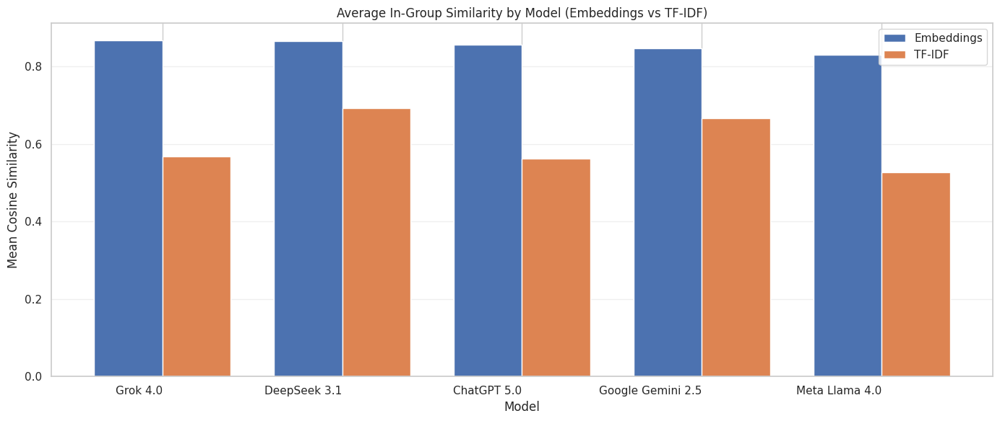

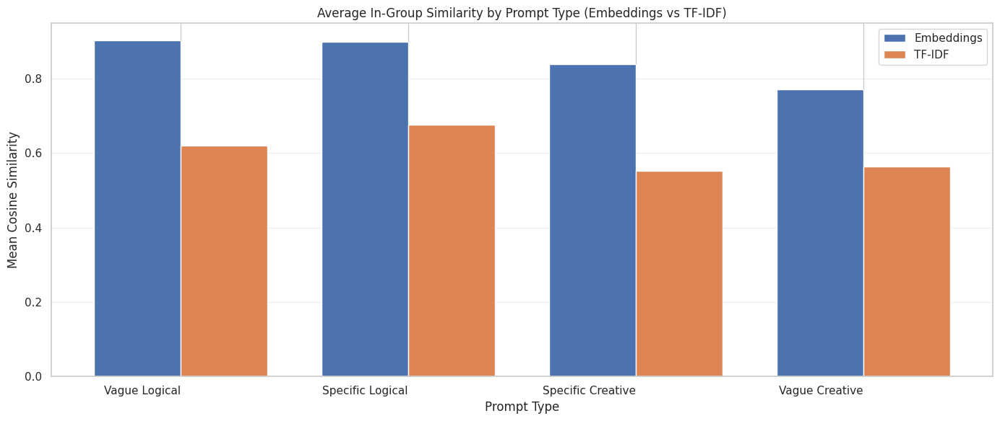

In [ ]:
# Double bar graphs comparing Avg_Similarity (Embedding vs TF-IDF)
# for (1) Model and (2) Prompt Type.
# This block will (re)compute the required summaries if they don't exist.
# ---------- helpers ----------
def to_vec(x):
    if isinstance(x, str):
        try: x = ast.literal_eval(x)
        except Exception: return None
    if isinstance(x, (list, tuple, np.ndarray)):
        return np.array(x, dtype=np.float32)
    return None

def mean_tfidf(sub):
    if len(sub) < 2: return None, 0
    X = TfidfVectorizer().fit_transform(sub['Response Text'])
    S = cosine_similarity(X)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return (float(vals.mean()), int(vals.size)) if vals.size else (None, 0)

def mean_embed(sub):
    if len(sub) < 2: return None, 0
    M = np.vstack(sub['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    return (float(vals.mean()), int(vals.size)) if vals.size else (None, 0)

# ---------- ensure embeddings parsed ----------
if 'embedding_vec' not in df.columns:
    df['embedding_vec'] = df['Response Embedding'].apply(to_vec)

prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

# ---------- build strict in-group cells (Prompt × Model × User) if needed ----------
if 'cells' not in globals():
    rows = []
    for (p, m, u), g in df.dropna(subset=['Response Text', 'embedding_vec']).groupby([prompt_col, 'Model', user_col]):
        mtf, np_tf = mean_tfidf(g)
        mem, np_em = mean_embed(g)
        if (mtf is None) or (mem is None):
            continue
        rows.append({
            prompt_col: p, 'Model': m, user_col: u,
            'Prompt Type': g['Prompt Type'].iloc[0] if 'Prompt Type' in g.columns else None,
            'cell_mean_tfidf': mtf, 'pairs_tfidf': np_tf,
            'cell_mean_embed': mem, 'pairs_embed': np_em
        })
    cells = pd.DataFrame(rows)

# ---------- compute summaries if not already present ----------
if 'df_models_comparison' not in globals():
    df_models_comparison = cells.groupby('Model').agg(
        Avg_Similarity_TFIDF=('cell_mean_tfidf','mean'),
        Avg_Similarity_Embeddings=('cell_mean_embed','mean'),
        n_cells=('cell_mean_tfidf','size')
    ).sort_values('Avg_Similarity_Embeddings', ascending=False)

if 'df_prompt_types_comparison' not in globals() and 'Prompt Type' in cells.columns and cells['Prompt Type'].notna().any():
    df_prompt_types_comparison = cells.groupby('Prompt Type').agg(
        Avg_Similarity_TFIDF=('cell_mean_tfidf','mean'),
        Avg_Similarity_Embeddings=('cell_mean_embed','mean'),
        n_cells=('cell_mean_tfidf','size')
    ).sort_values('Avg_Similarity_Embeddings', ascending=False)

# ---------- plotting: double bars (Embedding vs TF-IDF), by Model ----------
if not df_models_comparison.empty:
    labels = df_models_comparison.index.astype(str).tolist()
    emb = df_models_comparison['Avg_Similarity_Embeddings'].values
    tf  = df_models_comparison['Avg_Similarity_TFIDF'].values

    x = np.arange(len(labels))
    width = 0.38

    plt.figure(figsize=(14, 6))
    plt.bar(x - width/2, emb, width, label='Embeddings')
    plt.bar(x + width/2, tf,  width, label='TF-IDF')
    plt.title('Average In-Group Similarity by Model (Embeddings vs TF-IDF)')
    plt.ylabel('Mean Cosine Similarity')
    plt.xlabel('Model')
    plt.xticks(x, labels, rotation=0, ha='right')
    plt.legend()
    plt.grid(True, axis='y', alpha=0.3)
    plt.tight_layout()
    plt.show()

# ---------- plotting: double bars (Embedding vs TF-IDF), by Prompt Type ----------
if 'df_prompt_types_comparison' in globals() and not df_prompt_types_comparison.empty:
    labels = df_prompt_types_comparison.index.astype(str).tolist()
    emb = df_prompt_types_comparison['Avg_Similarity_Embeddings'].values
    tf  = df_prompt_types_comparison['Avg_Similarity_TFIDF'].values

    x = np.arange(len(labels))
    width = 0.38

    plt.figure(figsize=(14, 6))
    plt.bar(x - width/2, emb, width, label='Embeddings')
    plt.bar(x + width/2, tf,  width, label='TF-IDF')
    plt.title('Average In-Group Similarity by Prompt Type (Embeddings vs TF-IDF)')
    plt.ylabel('Mean Cosine Similarity')
    plt.xlabel('Prompt Type')
    plt.xticks(x, labels, rotation=0, ha='right')
    plt.legend()
    plt.grid(True, axis='y', alpha=0.3)
    plt.tight_layout()
    plt.show()


In [ ]:
# COMPARE SEMANTIC (Embeddings) vs TF-IDF ACROSS PLATFORMS FOR THE SAME PROMPTS
# - WITH USER:   per (Prompt, Model, User)
# - WITHOUT USER: per (Prompt, Model) pooling users
# Outputs:
#   cells_pmu  -> table of (Prompt, Model, User) with Emb/TF means
#   cells_pm   -> table of (Prompt, Model) pooled with Emb/TF means
#   plot_by_prompt_with_user(prompt_value)
#   plot_by_prompt_no_user(prompt_value)

# ---------- setup / helpers ----------
# ensure parsed embeddings
if 'embedding_vec' not in df.columns:
    def to_vec(x):
        if isinstance(x, str):
            try:
                x = ast.literal_eval(x)
            except Exception:
                return None
        if isinstance(x, (list, tuple, np.ndarray)):
            return np.array(x, dtype=np.float32)
        return None
    df['embedding_vec'] = df['Response Embedding'].apply(to_vec)

prompt_col = 'Prompt' if 'Prompt' in df.columns else df.columns[0]
user_col   = 'User Name' if 'User Name' in df.columns else ('User' if 'User' in df.columns else df.columns[5])

def cell_mean_tfidf(sub_df):
    # mean of upper-triangle cosine similarities on TF-IDF vectors
    if len(sub_df) < 2:
        return None, 0
    X = TfidfVectorizer().fit_transform(sub_df['Response Text'])
    S = cosine_similarity(X)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(vals.mean()), int(vals.size)

def cell_mean_embed(sub_df):
    # mean of upper-triangle cosine similarities on embedding vectors
    sub_df = sub_df.dropna(subset=['embedding_vec'])
    if len(sub_df) < 2:
        return None, 0
    M = np.vstack(sub_df['embedding_vec'].values)
    S = cosine_similarity(M)
    iu = np.triu_indices_from(S, 1)
    vals = S[iu]
    if vals.size == 0:
        return None, 0
    return float(vals.mean()), int(vals.size)

# ---------- WITH USER: (Prompt, Model, User) ----------
rows = []
for (p, m, u), g in df.dropna(subset=['Response Text']).groupby([prompt_col, 'Model', user_col]):
    m_tf, n_tf = cell_mean_tfidf(g)
    m_em, n_em = cell_mean_embed(g)
    if (m_tf is None) or (m_em is None):
        continue
    rows.append({
        prompt_col: p,
        'Model': m,
        user_col: u,
        'Mean_TFIDF': m_tf,
        'Pairs_TFIDF': n_tf,
        'Mean_Embed': m_em,
        'Pairs_Embed': n_em,
        'n_responses': len(g)
    })
cells_pmu = pd.DataFrame(rows).sort_values([prompt_col, 'Model', user_col]).reset_index(drop=True)

# ---------- WITHOUT USER: (Prompt, Model) pooled ----------
rows = []
for (p, m), g in df.dropna(subset=['Response Text']).groupby([prompt_col, 'Model']):
    m_tf, n_tf = cell_mean_tfidf(g)
    m_em, n_em = cell_mean_embed(g)
    if (m_tf is None) or (m_em is None):
        continue
    rows.append({
        prompt_col: p,
        'Model': m,
        'Mean_TFIDF': m_tf,
        'Pairs_TFIDF': n_tf,
        'Mean_Embed': m_em,
        'Pairs_Embed': n_em,
        'n_responses': len(g)
    })
cells_pm = pd.DataFrame(rows).sort_values([prompt_col, 'Model']).reset_index(drop=True)

# ---------- quick sanity prints ----------
print("WITH USER — cells_pmu shape:", cells_pmu.shape)
print("WITHOUT USER — cells_pm shape:", cells_pm.shape)

# ---------- helper plots ----------
def plot_by_prompt_with_user(prompt_value):
    """
    Double-bar per Model showing Embedding vs TF-IDF,
    faceted by User for a single prompt (Prompt, Model, User).
    """
    dat = cells_pmu[cells_pmu[prompt_col] == prompt_value].copy()
    if dat.empty:
        print("No data for prompt:", prompt_value)
        return

    users = dat[user_col].unique().tolist()
    n = len(users)
    ncols = min(2, n)
    nrows = int(np.ceil(n / ncols))

    fig, axes = plt.subplots(nrows, ncols, figsize=(7*ncols, 4.5*nrows), squeeze=False)
    for i, u in enumerate(users):
        ax = axes[i // ncols, i % ncols]
        sub = dat[dat[user_col] == u]
        labels = sub['Model'].astype(str).tolist()
        emb = sub['Mean_Embed'].values
        tf  = sub['Mean_TFIDF'].values
        x = np.arange(len(labels))
        width = 0.38
        ax.bar(x - width/2, emb, width, label='Embedding')
        ax.bar(x + width/2, tf,  width, label='TF-IDF')
        ax.set_title(f'Prompt: {str(prompt_value)[:40]}{"..." if len(str(prompt_value))>40 else ""} | User: {u}')
        ax.set_xticks(x, labels, rotation=0, ha='right')
        ax.set_ylabel('Mean Cosine Similarity')
        ax.grid(True, axis='y', alpha=0.3)
        if i == 0:
            ax.legend()
    plt.tight_layout()
    plt.show()

def plot_by_prompt_no_user(prompt_value):
    """
    Double-bar per Model showing Embedding vs TF-IDF,
    pooling users within each (Prompt, Model).
    """
    sub = cells_pm[cells_pm[prompt_col] == prompt_value].copy()
    if sub.empty:
        print("No pooled data for prompt:", prompt_value)
        return
    labels = sub['Model'].astype(str).tolist()
    emb = sub['Mean_Embed'].values
    tf  = sub['Mean_TFIDF'].values
    x = np.arange(len(labels))
    width = 0.38

    plt.figure(figsize=(10, 5.5))
    plt.bar(x - width/2, emb, width, label='Embedding')
    plt.bar(x + width/2, tf,  width, label='TF-IDF')
    plt.title(f'Prompt: {str(prompt_value)[:70]}{"..." if len(str(prompt_value))>70 else ""} (pooled users)')
    plt.xticks(x, labels, rotation=0, ha='right')
    plt.ylabel('Mean Cosine Similarity')
    plt.legend()
    plt.grid(True, axis='y', alpha=0.3)
    plt.tight_layout()
    plt.show()

# ---------- optional: per-prompt pivots (useful for quick inspection) ----------
# Example: pivot mean Embedding per Model for a single prompt (WITH USER)
# piv = cells_pmu[cells_pmu[prompt_col] == some_prompt].pivot(index=user_col, columns='Model', values='Mean_Embed')
# Example: pivot mean TF-IDF per Model for a single prompt (WITHOUT USER)
# piv2 = cells_pm[cells_pm[prompt_col] == some_prompt].pivot(index=None, columns='Model', values='Mean_TFIDF')

# ---------- example usage (uncomment and replace PROMPT_VALUE) ----------
# PROMPT_VALUE = cells_pm[prompt_col].iloc[0]
# plot_by_prompt_with_user(PROMPT_VALUE)
# plot_by_prompt_no_user(PROMPT_VALUE)


WITH USER — cells_pmu shape: (400, 8)
WITHOUT USER — cells_pm shape: (200, 7)
